# Capstone Project: Create a Customer Segmentation Report for Arvato Financial Services

In this project, you will analyze demographics data for customers of a mail-order sales company in Germany, comparing it against demographics information for the general population. You'll use unsupervised learning techniques to perform customer segmentation, identifying the parts of the population that best describe the core customer base of the company. Then, you'll apply what you've learned on a third dataset with demographics information for targets of a marketing campaign for the company, and use a model to predict which individuals are most likely to convert into becoming customers for the company. The data that you will use has been provided by our partners at Bertelsmann Arvato Analytics, and represents a real-life data science task.

If you completed the first term of this program, you will be familiar with the first part of this project, from the unsupervised learning project. The versions of those two datasets used in this project will include many more features and has not been pre-cleaned. You are also free to choose whatever approach you'd like to analyzing the data rather than follow pre-determined steps. In your work on this project, make sure that you carefully document your steps and decisions, since your main deliverable for this project will be a blog post reporting your findings.

In [267]:
# import libraries here; add more as necessary
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import random

# From utils.py
from utils import get_missing_and_nas, remove_nas_rows, 
from utils import create_unknown_dataset, create_unknown_dictionary, replace_unknown_values
from utils import split_cameo
from utils import clean_azdias, clean_mailout 
from utils import do_pca, get_component, plot_component, scree_plot

from jupyterthemes import jtplot
# currently installed theme will be used to
# set plot style if no arguments provided
jtplot.style()

# sklearn
from sklearn.preprocessing import Imputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

#Clustering
from sklearn.cluster import KMeans

# magic word for producing visualizations in notebook
%matplotlib inline

## 0. Get to Know the Data

There are four data files associated with this project:

- `Udacity_AZDIAS_052018.csv`: Demographics data for the general population of Germany; 891 211 persons (rows) x 366 features (columns).
- `Udacity_CUSTOMERS_052018.csv`: Demographics data for customers of a mail-order company; 191 652 persons (rows) x 369 features (columns).
- `Udacity_MAILOUT_052018_TRAIN.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 982 persons (rows) x 367 (columns).
- `Udacity_MAILOUT_052018_TEST.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 833 persons (rows) x 366 (columns).

Each row of the demographics files represents a single person, but also includes information outside of individuals, including information about their household, building, and neighborhood. Use the information from the first two files to figure out how customers ("CUSTOMERS") are similar to or differ from the general population at large ("AZDIAS"), then use your analysis to make predictions on the other two files ("MAILOUT"), predicting which recipients are most likely to become a customer for the mail-order company.

The "CUSTOMERS" file contains three extra columns ('CUSTOMER_GROUP', 'ONLINE_PURCHASE', and 'PRODUCT_GROUP'), which provide broad information about the customers depicted in the file. The original "MAILOUT" file included one additional column, "RESPONSE", which indicated whether or not each recipient became a customer of the company. For the "TRAIN" subset, this column has been retained, but in the "TEST" subset it has been removed; it is against that withheld column that your final predictions will be assessed in the Kaggle competition.

Otherwise, all of the remaining columns are the same between the three data files. For more information about the columns depicted in the files, you can refer to two Excel spreadsheets provided in the workspace. [One of them](./DIAS Information Levels - Attributes 2017.xlsx) is a top-level list of attributes and descriptions, organized by informational category. [The other](./DIAS Attributes - Values 2017.xlsx) is a detailed mapping of data values for each feature in alphabetical order.

In the below cell, we've provided some initial code to load in the first two datasets. Note for all of the `.csv` data files in this project that they're semicolon (`;`) delimited, so an additional argument in the [`read_csv()`](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.read_csv.html) call has been included to read in the data properly. Also, considering the size of the datasets, it may take some time for them to load completely.

You'll notice when the data is loaded in that a warning message will immediately pop up. Before you really start digging into the modeling and analysis, you're going to need to perform some cleaning. Take some time to browse the structure of the data and look over the informational spreadsheets to understand the data values. Make some decisions on which features to keep, which features to drop, and if any revisions need to be made on data formats. It'll be a good idea to create a function with pre-processing steps, since you'll need to clean all of the datasets before you work with them.

## I. Loading the data

In [8]:
# load in the data
azdias = pd.read_csv('Udacity_AZDIAS_052018.csv', sep=';')
customers = pd.read_csv('Udacity_CUSTOMERS_052018.csv', sep=';')
azdias.drop(columns='Unnamed: 0', inplace=True)
customers.drop(columns='Unnamed: 0', inplace=True)

/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [9]:
# Also the attribute file will come in handy for handling missing or unknown values
dictionary = pd.read_excel('DIAS Attributes - Values 2017_revised.xlsx', sheet_name='Tabelle1')
dictionary.drop(columns='Unnamed: 0', inplace=True)

In [10]:
# File created by me, cataloguizing all the columns: categorical, numeric, mixed, ordinal, etc. 
# For easy data processing in later cells
feature_info = pd.read_csv('feature_info.csv')

In [11]:
dictionary[dictionary['Attribute'] == 'D19_VERSAND_REST']#, 'D19_BANKEN_DIREKT'

,Attribute,Description,Value,Meaning
601,D19_VERSAND_REST,transactional activity based on the product gr...,0,no transaction known


In [17]:
#azdias.drop(columns='Unnamed: 0', inplace=True)
#customers.drop(columns='Unnamed: 0', inplace=True)

In [13]:
# Let's get a sense of the data first
print(azdias.shape)
azdias.info(verbose=True, null_counts=True)


(891221, 367)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891221 entries, 0 to 891220
Data columns (total 367 columns):
Unnamed: 0                     891221 non-null int64
LNR                            891221 non-null int64
AGER_TYP                       891221 non-null int64
AKT_DAT_KL                     817722 non-null float64
ALTER_HH                       817722 non-null float64
ALTER_KIND1                    81058 non-null float64
ALTER_KIND2                    29499 non-null float64
ALTER_KIND3                    6170 non-null float64
ALTER_KIND4                    1205 non-null float64
ALTERSKATEGORIE_FEIN           628274 non-null float64
ANZ_HAUSHALTE_AKTIV            798073 non-null float64
ANZ_HH_TITEL                   794213 non-null float64
ANZ_KINDER                     817722 non-null float64
ANZ_PERSONEN                   817722 non-null float64
ANZ_STATISTISCHE_HAUSHALTE     798073 non-null float64
ANZ_TITEL                      817722 non-null float64
ARBEIT

In [14]:
# Lets see missing vales in each colunmn closer
print("NAs / Nulls:")
print(pd.isnull(azdias).sum().sort_values(ascending=False))

NAs / Nulls:
ALTER_KIND4                    890016
ALTER_KIND3                    885051
ALTER_KIND2                    861722
ALTER_KIND1                    810163
EXTSEL992                      654153
KK_KUNDENTYP                   584612
ALTERSKATEGORIE_FEIN           262947
D19_VERSI_ONLINE_QUOTE_12      257113
D19_LETZTER_KAUF_BRANCHE       257113
D19_BANKEN_ONLINE_QUOTE_12     257113
D19_TELKO_ONLINE_QUOTE_12      257113
D19_VERSAND_ONLINE_QUOTE_12    257113
D19_KONSUMTYP                  257113
D19_SOZIALES                   257113
D19_GESAMT_ONLINE_QUOTE_12     257113
D19_LOTTO                      257113
KBA05_SEG8                     133324
KBA05_SEG7                     133324
KBA05_KW2                      133324
KBA05_KW3                      133324
KBA05_MAXAH                    133324
KBA05_MAXBJ                    133324
KBA05_MAXHERST                 133324
KBA05_MAXSEG                   133324
KBA05_MAXVORB                  133324
KBA05_MOD1                     133324

In [18]:
# How values look in each column?
azdias.describe()

,LNR,AGER_TYP,AKT_DAT_KL,ALTER_HH,ALTER_KIND1,ALTER_KIND2,ALTER_KIND3,ALTER_KIND4,ALTERSKATEGORIE_FEIN,ANZ_HAUSHALTE_AKTIV,...,VHN,VK_DHT4A,VK_DISTANZ,VK_ZG11,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB
count,8.912210e+05,891221.000000,817722.000000,817722.000000,81058.000000,29499.000000,6170.000000,1205.000000,628274.000000,798073.000000,...,770025.000000,815304.000000,815304.000000,815304.000000,783619.000000,817722.000000,798073.000000,891221.000000,891221.000000,891221.000000
mean,6.372630e+05,-0.358435,4.421928,10.864126,11.745392,13.402658,14.476013,15.089627,13.700717,8.287263,...,2.417322,6.001214,7.532130,5.945972,3.933406,7.908791,4.052836,3.362438,1.522098,2.777398
std,2.572735e+05,1.198724,3.638805,7.639683,4.097660,3.243300,2.712427,2.452932,5.079849,15.628087,...,1.166572,2.856091,3.247789,2.771464,1.964701,1.923137,1.949539,1.352704,0.499512,1.068775
min,1.916530e+05,-1.000000,1.000000,0.000000,2.000000,2.000000,4.000000,7.000000,0.000000,0.000000,...,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000
25%,4.144580e+05,-1.000000,1.000000,0.000000,8.000000,11.000000,13.000000,14.000000,11.000000,1.000000,...,2.000000,3.000000,5.000000,4.000000,2.000000,8.000000,3.000000,3.000000,1.000000,2.000000
50%,6.372630e+05,-1.000000,3.000000,13.000000,12.000000,14.000000,15.000000,15.000000,14.000000,4.000000,...,2.000000,6.000000,8.000000,6.000000,4.000000,9.000000,3.000000,3.000000,2.000000,3.000000
75%,8.600680e+05,-1.000000,9.000000,17.000000,15.000000,16.000000,17.000000,17.000000,17.000000,9.000000,...,3.000000,9.000000,10.000000,8.000000,6.000000,9.000000,5.000000,4.000000,2.000000,4.000000
max,1.082873e+06,3.000000,9.000000,21.000000,18.000000,18.000000,18.000000,18.000000,25.000000,595.000000,...,4.000000,11.000000,13.000000,11.000000,6.000000,9.000000,8.000000,6.000000,2.000000,9.000000


In [16]:
# How values look in each object column? 
azdias.describe(include=['object'])

,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_INTL_2015,D19_LETZTER_KAUF_BRANCHE,EINGEFUEGT_AM,OST_WEST_KZ
count,792242,792242,792242,634108,798073,798073
unique,45,19,43,35,5162,2
top,6B,8,51,D19_UNBEKANNT,1992-02-10 00:00:00,W
freq,56672,78023,77576,195338,383738,629528


## II. Preprocessing the data

There are a bunch of steps here that we need to consider in order to have clean dataset. 

###  Assess missing data
The attribute file contains a summary of properties for each demographics data column. We can use this file to help making cleaning decisions during this step. 
### Convert unknown value codes to NaNs
We would need to do a bit of parsing here.

In [19]:
# Lets start taking a glimpse of the attributes file
dictionary.head()

,Attribute,Description,Value,Meaning
0,AGER_TYP,best-ager typology,"-1, 0",unknown
1,NaN,NaN,0,no classification possible
2,NaN,NaN,1,passive elderly
3,NaN,NaN,2,cultural elderly
4,NaN,NaN,3,experience-driven elderly


In [20]:
print ('Shape of the attribute file: {}'.format(dictionary.shape))
unknown_values = dictionary.Meaning.str.contains('unknown', case=False) 
print('Missing values in the array: {}'.format(len(unknown_values[unknown_values.isnull()])))
print(unknown_values.value_counts())
# Replacing NaNs with False
unknown_values.fillna(value=False, inplace=True)
print('After filling NaNs with False: ')
print(unknown_values.value_counts())

Shape of the attribute file: (2258, 4)
Missing values in the array: 11
False    2014
True      233
Name: Meaning, dtype: int64
After filling NaNs with False: 
False    2025
True      233
Name: Meaning, dtype: int64


In [21]:
# Are there missing attribute names for unknown values?
dictionary[unknown_values][dictionary[unknown_values].Attribute.isnull()]

,Attribute,Description,Value,Meaning
821,NaN,NaN,"-1, 9",unknown
2083,NaN,NaN,"-1, 9",unknown


In [22]:
# Due to the nature of the attribute file, I would need to fix the NaNs above manually
dictionary.loc[821,'Attribute'] = 'KBA05_AUTOQUOT'
dictionary.loc[2083, 'Attribute'] = 'RELAT_AB'

In [23]:
df_unknown = dictionary[unknown_values]
df_unknown.head()

,Attribute,Description,Value,Meaning
0,AGER_TYP,best-ager typology,"-1, 0",unknown
5,ALTERSKATEGORIE_GROB,age classification through prename analysis,"-1, 0, 9",unknown
11,ALTER_HH,main age within the household,0,unknown / no main age detectable
33,ANREDE_KZ,gender,"-1, 0",unknown
40,BALLRAUM,distance to next urban centre,-1,unknown


In [24]:
# Testing
[int(element) for element in df_unknown.loc[5, 'Value'].split(',')]

[-1, 0, 9]

In [25]:
'''# Lets create a dictionary for the attributes with unknown values
unknown_dict = dict()
for attribute, unknown_value in zip(df_unknown.Attribute, df_unknown.Value):
    
    if type(unknown_value) == int:
        values = [unknown_value]
    else:
        values = [int(element) for element in unknown_value.split(',')]
    
    unknown_dict[attribute] = values
    
print(len(unknown_dict)) '''


233


In [ ]:
df_unknown = create_unknown_dataset(dictionary)
unknown_dict = create_unknown_dictionary(df_unknown)
print(len(unknown_dict))

In [26]:
# Just for curiosity, lets create a function to have an idea how much missing data and nans 
# are present in the data
'''def get_missing_and_nas(data,dictionary):
    
    col_na = dict()
    for column in data.columns:
        missing_count = 0
        nas_count = 0
        for elem in data[column]:
            try:
                if elem in dictionary[column]:
                    #print(elem)
                    missing_count += 1
                elif pd.isnull(elem):
                    #print(elem)
                    nas_count += 1
            except KeyError:
                pass
        #print(column, missing_count, nas_count)
        col_na[column]= {nas_count, missing_count}
    return col_na'''


In [27]:
col_na = get_missing_and_nas(azdias, unknown_dict)

In [28]:
print('Column name, { NaNs counts, unknown values counts }')
col_na

Column name, { NaNs counts, unknown values counts }


{'LNR': {0},
 'AGER_TYP': {0, 685843},
 'AKT_DAT_KL': {0},
 'ALTER_HH': {73499, 236768},
 'ALTER_KIND1': {0},
 'ALTER_KIND2': {0},
 'ALTER_KIND3': {0},
 'ALTER_KIND4': {0},
 'ALTERSKATEGORIE_FEIN': {0},
 'ANZ_HAUSHALTE_AKTIV': {0},
 'ANZ_HH_TITEL': {0},
 'ANZ_KINDER': {0},
 'ANZ_PERSONEN': {0},
 'ANZ_STATISTISCHE_HAUSHALTE': {0},
 'ANZ_TITEL': {0},
 'ARBEIT': {0},
 'BALLRAUM': {0, 93740},
 'CAMEO_DEU_2015': {0},
 'CAMEO_DEUG_2015': {0, 98979},
 'CAMEO_INTL_2015': {0},
 'CJT_GESAMTTYP': {0, 4854},
 'CJT_KATALOGNUTZER': {0},
 'CJT_TYP_1': {0},
 'CJT_TYP_2': {0},
 'CJT_TYP_3': {0},
 'CJT_TYP_4': {0},
 'CJT_TYP_5': {0},
 'CJT_TYP_6': {0},
 'D19_BANKEN_ANZ_12': {0},
 'D19_BANKEN_ANZ_24': {0},
 'D19_BANKEN_DATUM': {0},
 'D19_BANKEN_DIREKT': {0},
 'D19_BANKEN_GROSS': {0},
 'D19_BANKEN_LOKAL': {0},
 'D19_BANKEN_OFFLINE_DATUM': {0},
 'D19_BANKEN_ONLINE_DATUM': {0},
 'D19_BANKEN_ONLINE_QUOTE_12': {0},
 'D19_BANKEN_REST': {0},
 'D19_BEKLEIDUNG_GEH': {0},
 'D19_BEKLEIDUNG_REST': {0},
 'D19_BILDUNG

In [29]:
# Function to Convert unknown values to NaNs

'''def replace_unknown_values(dataset,feature_dict):
    for column in dataset.columns:
        try:
            dataset[column] = dataset[column].replace(feature_dict[column], np.nan)
        except KeyError:
            pass
    '''

In [30]:
replace_unknown_values(azdias, unknown_dict)

In [31]:
azdias.head()

,LNR,AGER_TYP,AKT_DAT_KL,ALTER_HH,ALTER_KIND1,ALTER_KIND2,ALTER_KIND3,ALTER_KIND4,ALTERSKATEGORIE_FEIN,ANZ_HAUSHALTE_AKTIV,...,VHN,VK_DHT4A,VK_DISTANZ,VK_ZG11,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB
0,910215,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,1,2.0
1,910220,NaN,9.0,NaN,NaN,NaN,NaN,NaN,21.0,11.0,...,4.0,8.0,11.0,10.0,3.0,9.0,4.0,5,2,1.0
2,910225,NaN,9.0,17.0,NaN,NaN,NaN,NaN,17.0,10.0,...,2.0,9.0,9.0,6.0,3.0,9.0,2.0,5,2,3.0
3,910226,2.0,1.0,13.0,NaN,NaN,NaN,NaN,13.0,1.0,...,0.0,7.0,10.0,11.0,NaN,9.0,7.0,3,2,4.0
4,910241,NaN,1.0,20.0,NaN,NaN,NaN,NaN,14.0,3.0,...,2.0,3.0,5.0,4.0,2.0,9.0,3.0,4,1,3.0


In [32]:
# When looking at the object columns lines ago, I noticed that the unique values were a lot more 
# than in the attributes files for the CAMEO_DEUG_2015. Lets check all the ob columns
# We can see here that CAMEO_DEU_2015 has a value of 'XX' which should be unknown
azdias.CAMEO_DEU_2015.value_counts()

6B    56672
8A    52438
4C    47819
2D    35074
3C    34769
7A    34399
3D    34307
8B    33434
4A    33155
8C    30993
9D    28593
9B    27676
9C    24987
7B    24503
9A    20542
2C    19422
8D    17576
6E    16107
2B    15486
5D    14943
6C    14820
2A    13249
5A    12214
1D    11909
1A    10850
3A    10543
5B    10354
5C     9935
7C     9065
4B     9047
4D     8570
3B     7160
6A     6810
9E     6379
6D     6073
6F     5392
7D     5333
4E     5321
1E     5065
7E     4633
1C     4317
5F     4283
1B     4071
5E     3581
XX      373
Name: CAMEO_DEU_2015, dtype: int64

In [33]:
# Converting XX to nan
azdias.loc[azdias['CAMEO_DEU_2015'] == 'XX', 'CAMEO_DEU_2015'] = np.nan

In [34]:
# This columns sould be integer and it should have only 9 unique values. Also we need to get rid 
# of the 'X' value
azdias.CAMEO_DEUG_2015.value_counts()

8      78023
9      62578
6      61253
4      60185
8.0    56418
3      50360
2      48276
9.0    45599
7      45021
6.0    44621
4.0    43727
3.0    36419
2.0    34955
7.0    32912
5      32292
5.0    23018
1      20997
1.0    15215
X        373
Name: CAMEO_DEUG_2015, dtype: int64

In [35]:
# Converting X to nan and changing column type
azdias.loc[azdias['CAMEO_DEUG_2015'] == 'X', 'CAMEO_DEUG_2015'] = np.nan
azdias.loc[:, 'CAMEO_DEUG_2015'] = azdias.loc[:, 'CAMEO_DEUG_2015'].astype('float')

In [36]:
# this column semms fine
azdias.D19_LETZTER_KAUF_BRANCHE.value_counts()

D19_UNBEKANNT             195338
D19_VERSICHERUNGEN         57734
D19_SONSTIGE               44722
D19_VOLLSORTIMENT          34812
D19_SCHUHE                 32578
D19_BUCH_CD                28754
D19_VERSAND_REST           26034
D19_DROGERIEARTIKEL        24072
D19_BANKEN_DIREKT          23273
D19_BEKLEIDUNG_REST        21796
D19_HAUS_DEKO              20858
D19_TELKO_MOBILE           14447
D19_ENERGIE                12084
D19_TELKO_REST             11472
D19_BANKEN_GROSS           10550
D19_BEKLEIDUNG_GEH         10272
D19_KINDERARTIKEL           7301
D19_FREIZEIT                7257
D19_TECHNIK                 7002
D19_LEBENSMITTEL            6458
D19_BANKEN_REST             5247
D19_RATGEBER                4931
D19_NAHRUNGSERGAENZUNG      4061
D19_DIGIT_SERV              3577
D19_REISEN                  3122
D19_TIERARTIKEL             2578
D19_SAMMELARTIKEL           2443
D19_HANDWERK                2227
D19_WEIN_FEINKOST           2164
D19_GARTEN                  1646
D19_BANKEN

In [37]:
# Same here, this column should have 25 unique values, also we need to get rid of the 'XX' value
azdias.CAMEO_INTL_2015.value_counts()

51      77576
51.0    56118
41      53459
24      52882
41.0    38877
24.0    38276
14      36524
43      32730
14.0    26360
54      26207
43.0    23942
25      22837
54.0    19184
22      19173
25.0    16791
23      15653
13      15272
45      15206
22.0    13982
55      13842
52      11836
23.0    11097
13.0    11064
31      11041
45.0    10926
34      10737
55.0    10113
15       9832
52.0     8706
44       8543
31.0     7983
34.0     7787
12       7645
15.0     7142
44.0     6277
35       6090
32       6067
33       5833
12.0     5604
32.0     4287
35.0     4266
33.0     4102
XX        373
Name: CAMEO_INTL_2015, dtype: int64

In [38]:
# Converting XX to nan and changing column type
azdias.loc[azdias['CAMEO_INTL_2015'] == 'XX', 'CAMEO_INTL_2015'] = np.nan
azdias.loc[:, 'CAMEO_INTL_2015'] = azdias.loc[:, 'CAMEO_INTL_2015'].astype('float')

In [39]:
# Categorical columnm . Looks fine
azdias.OST_WEST_KZ.value_counts()

W    629528
O    168545
Name: OST_WEST_KZ, dtype: int64

### Assess Missing Data in Each Column

As we well remember from our previous cells, there is a bunch of columns with a considerable amount of missing values. Let's take a further look at these for now.

In [40]:
# Performing an assesment of how much missing data there is in each column of the dataset
column_dist = azdias.isnull().sum()
column_dist.sort_values(ascending=False, inplace=True)

print(column_dist[:30]/azdias.shape[0])

ALTER_KIND4                    0.998648
TITEL_KZ                       0.997576
ALTER_KIND3                    0.993077
ALTER_KIND2                    0.966900
ALTER_KIND1                    0.909048
AGER_TYP                       0.769554
EXTSEL992                      0.733996
KK_KUNDENTYP                   0.655967
KBA05_BAUMAX                   0.534687
ALTER_HH                       0.348137
ALTERSKATEGORIE_FEIN           0.295041
D19_VERSAND_ONLINE_QUOTE_12    0.288495
D19_TELKO_ONLINE_QUOTE_12      0.288495
D19_VERSI_ONLINE_QUOTE_12      0.288495
D19_BANKEN_ONLINE_QUOTE_12     0.288495
D19_SOZIALES                   0.288495
D19_LOTTO                      0.288495
D19_LETZTER_KAUF_BRANCHE       0.288495
D19_KONSUMTYP                  0.288495
D19_GESAMT_ONLINE_QUOTE_12     0.288495
REGIOTYP                       0.177357
KKK                            0.177357
KBA05_AUTOQUOT                 0.166193
KBA05_MOD3                     0.166188
KBA05_SEG2                     0.166188


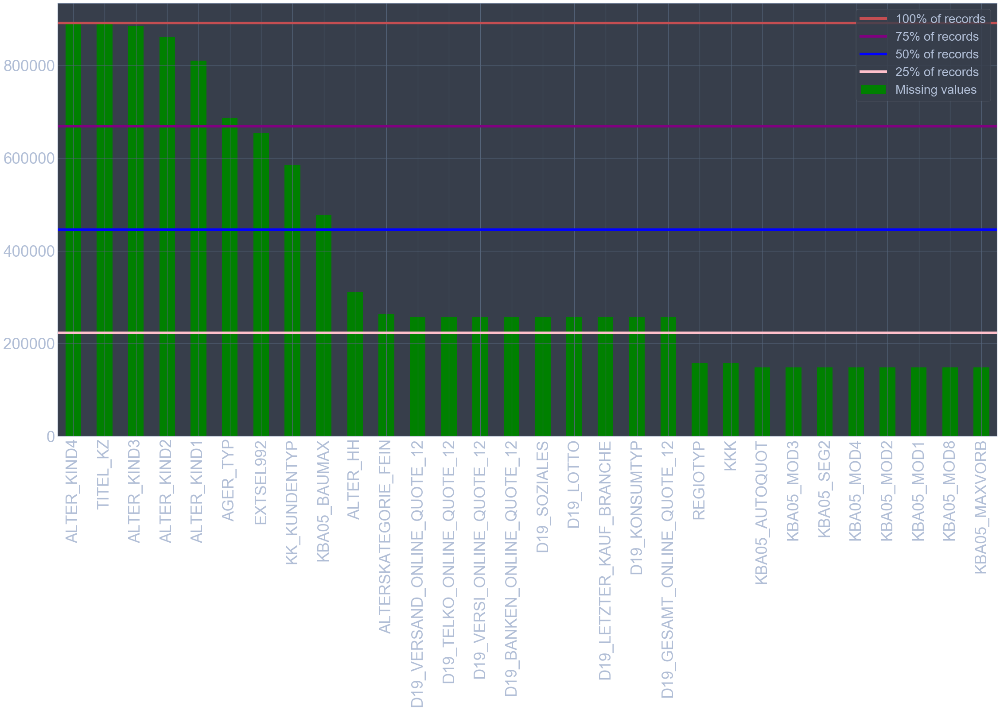

In [41]:
# Plotting the number of NaNs per feature
n_records = azdias.shape[0]
column_dist[:30].plot(kind='bar', figsize=(38,18), fontsize=35, color='green', label='Missing values')
plt.axhline(y = n_records, color='r', linewidth=6, label ='100% of records')
plt.axhline(y = n_records*0.75, color='purple', linewidth=6, label ='75% of records')
plt.axhline(y = n_records*0.5, color='blue', linewidth=6, label ='50% of records')
plt.axhline(y = n_records*0.25, color='pink', linewidth=6, label ='25% of records')
plt.legend(prop={'size':28});

We can see now that there are some columns that have nearly 100% missing values. After taking a further look at those columns, I decided to remove the ones showing more that 25 % of missing values. TITLE_KZ, AGER_TYP, KK_KUNDENTYP, KBA05_BAUMAX have more that 50% NAs. AGER_TYP is expected to have tons of NAs due to is a variable for elders, so everyone that is not elder will not have value here and it should be dropped (It could be re encoded with 0 for all the missing values). Same thing with the TITEL_KZ, which is the academic title and not everyone will have this populated. Also, the KK_KUNDENTYP is a customer flag and not everyone might be a customer.
Additionally, the columns starting with **'D19'** have the same amount of missing values, which is not suprinsing since they all belong to the same category: **Household**.
Lastly, there is no information for the columns starting with **ALTER_KIND** and **EXTSEL992**, and they have nearly 100% of missing values, so I will remove them. 


In [42]:
outlier_columns = column_dist.index[:20]
outlier_columns

Index(['ALTER_KIND4', 'TITEL_KZ', 'ALTER_KIND3', 'ALTER_KIND2', 'ALTER_KIND1',
       'AGER_TYP', 'EXTSEL992', 'KK_KUNDENTYP', 'KBA05_BAUMAX', 'ALTER_HH',
       'ALTERSKATEGORIE_FEIN', 'D19_VERSAND_ONLINE_QUOTE_12',
       'D19_TELKO_ONLINE_QUOTE_12', 'D19_VERSI_ONLINE_QUOTE_12',
       'D19_BANKEN_ONLINE_QUOTE_12', 'D19_SOZIALES', 'D19_LOTTO',
       'D19_LETZTER_KAUF_BRANCHE', 'D19_KONSUMTYP',
       'D19_GESAMT_ONLINE_QUOTE_12'],
      dtype='object')

In [43]:
# Removing the outlier columns from the dataset.
azdias.drop(outlier_columns, axis=1, inplace=True)

### Assess Missing Data in Each Row


Let's perform similar assesments for the rows of the dataset.

In [44]:
# Creating a function to remove rows that have 25% missing data (for later use)
'''def remove_nas_rows(dataset):
    
    print("Splitting records with NAs..\n",
         "Total records: {}".format(dataset.shape[0]))
    rows_NA = dataset.isnull().sum(axis=1)
    #rows_NA.drop(labels=rows_NA[rows_NA[:] <= 0].index, inplace=True)
    
    n_columns = dataset.shape[1]
    
    quarter_of_columns = int(n_columns * 0.25)
    
    rows_NA_low = rows_NA[rows_NA < quarter_of_columns]
    rows_NA_high = rows_NA[rows_NA >= quarter_of_columns]
    
    print("Records split by {} missing values.\n".format(quarter_of_columns), 
          "Shape of resulting dataset: {}\n".format(rows_NA_low.shape),
          "Shape of high NAs dataset: {}\n".format(rows_NA_high.shape))
    

    df_low = dataset[dataset.index.isin(rows_NA_low.index)]
    df_high = dataset[dataset.index.isin(rows_NA_high.index)]
    return df_low, df_high'''

In [45]:
# How much data is missing in each row of the dataset?
rows_dist = azdias.isnull().sum(axis=1)
populated_rows = rows_dist[rows_dist[:] <= 0]

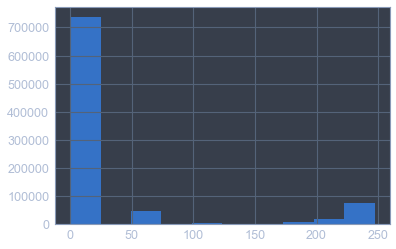

In [46]:
# Taking a look of the distribution or the NAs in the records
plt.hist(rows_dist);

In [47]:
n_columns = azdias.shape[1]
max_na = n_columns * 0.25
print('Maximum threshold for missing values: {}'.format(max_na))
# Lets divide the data into 2 subsets based on the number of missing values in each row, in
# this case we can use max_na as a threshold

na_rows_low = rows_dist[rows_dist < max_na]
na_rows_high = rows_dist[rows_dist >= max_na]

print(na_rows_low.shape, na_rows_high.shape)



Maximum threshold for missing values: 86.5
(785296,) (105925,)


Let's see if the distribution of data values on columns that are not missing data (or are missing very little data) are similar or different between the two subsets. 

In [48]:
# Comparing the distribution of values for at least five columns where there are
# no missing values, between the two subsets.

# Selection of columns with no missing values from 
populated_cols = random.choices(column_dist[(column_dist == 0) & (~column_dist.index.str.contains('D19'))].index, k=6)
populated_cols

['SEMIO_KRIT',
 'SEMIO_RAT',
 'FINANZ_VORSORGER',
 'SEMIO_VERT',
 'SEMIO_VERT',
 'FINANZTYP']

In [49]:
# Taking a look at the rows >= 86 missing values  
azdias[populated_cols][azdias.index.isin(na_rows_high.index)].head()

,SEMIO_KRIT,SEMIO_RAT,FINANZ_VORSORGER,SEMIO_VERT,SEMIO_VERT,FINANZTYP
0,7,4,3,1,1,4
11,7,4,3,1,1,4
14,7,4,3,1,1,4
15,6,3,5,2,2,2
17,7,4,3,1,1,4


In [50]:
def dist_data_plot(column):
    
    x_low = azdias[column][azdias.index.isin(na_rows_low.index)]
    x_high = azdias[column][azdias.index.isin(na_rows_high.index)]
    
    plt.subplot(1,2,1)
    sns.countplot(x = x_low, data=azdias)
    plt.title("Low NAs")
    
    plt.subplot(1,2,2)
    sns.countplot(x = x_high, data=azdias)
    plt.title("High NAs")

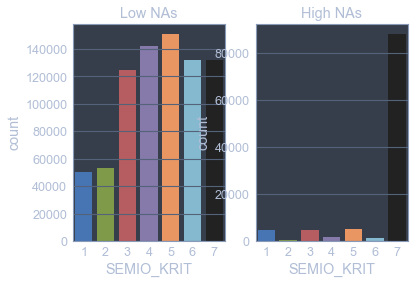

In [51]:
dist_data_plot(populated_cols[0])

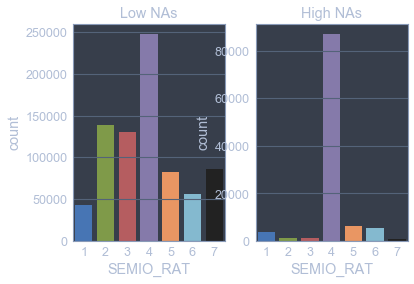

In [52]:
dist_data_plot(populated_cols[1])

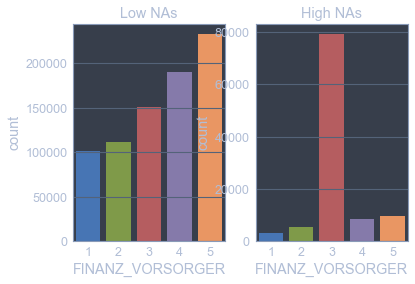

In [53]:
dist_data_plot(populated_cols[2])

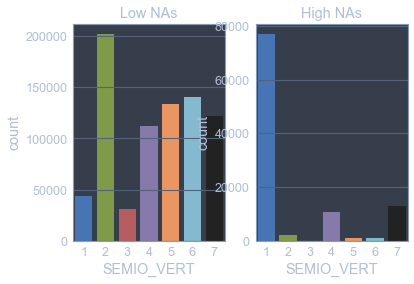

In [54]:
dist_data_plot(populated_cols[3])

There are 105925 rows that have 25 or more missing values. After plotting the frequency of missing values per category for each dataset (na_rows_high, na_rows_low), I noticed that there is no similarity in terms of how distributed are missing values between them. So, I decided to not to remove the data at this point, however, I will be using the na_rows_low moving forward. Also, I noticed that for the High missing values dataset, there is always a category that has very high frequescy in each plot.

In [55]:
# We will use the the low na dataset from now on
azdias_updated = azdias[azdias.index.isin(na_rows_low.index)]

### Re-encode features

Since the unsupervised learning techniques to be used will only work on data that is encoded numerically, we need to make a few encoding changes or additional assumptions to be able to make progress. In addition, while almost all of the values in the dataset are encoded using numbers, not all of them represent numeric values. Let's consider the following:

- For numeric and interval data, these features can be kept without changes.
- Most of the variables in the dataset are ordinal in nature. While ordinal values may technically be non-linear in spacing, make the simplifying assumption that the ordinal variables can be treated as being interval in nature (that is, kept without any changes).
- Special handling may be necessary for the 'object' column types.

In [56]:
# In this part we will use the feature infor file I created before
feature_info['Type'].value_counts()

Ordinal        288
Categorical     19
Mixed            6
Numeric          1
Name: Type, dtype: int64

In [57]:
# Initializing categorical columns varible
categorical_cols = feature_info.Feature[feature_info.Type == 'Categorical']
categorical_cols.tolist()

['LP_FAMILIE_FEIN',
 'LP_FAMILIE_GROB',
 'LP_STATUS_FEIN',
 'LP_STATUS_GROB',
 'NATIONALITAET_KZ',
 'OST_WEST_KZ',
 'SHOPPER_TYP',
 'SOHO_FLAG',
 'TITEL_KZ',
 'VERS_TYP',
 'ANREDE_KZ',
 'CJT_GESAMTTYP',
 'CAMEO_DEUG_2015',
 'CAMEO_DEU_2015',
 'FINANZTYP',
 'GEBAEUDETYP',
 'GFK_URLAUBERTYP',
 'GREEN_AVANTGARDE',
 'ZABEOTYP']

In [58]:
categorical_cols

0      LP_FAMILIE_FEIN
1      LP_FAMILIE_GROB
4       LP_STATUS_FEIN
5       LP_STATUS_GROB
6     NATIONALITAET_KZ
7          OST_WEST_KZ
9          SHOPPER_TYP
10           SOHO_FLAG
11            TITEL_KZ
12            VERS_TYP
13           ANREDE_KZ
14       CJT_GESAMTTYP
15     CAMEO_DEUG_2015
16      CAMEO_DEU_2015
17           FINANZTYP
18         GEBAEUDETYP
19     GFK_URLAUBERTYP
20    GREEN_AVANTGARDE
21            ZABEOTYP
Name: Feature, dtype: object

In [59]:
# Dropping columns that are already removed due to missing values
categorical_cols.drop(labels=[10,11], inplace=True)

# Taking a look at the categorical columns in the dataset
azdias_updated[categorical_cols].describe()

,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,SHOPPER_TYP,VERS_TYP,ANREDE_KZ,CJT_GESAMTTYP,CAMEO_DEUG_2015,FINANZTYP,GEBAEUDETYP,GFK_URLAUBERTYP,GREEN_AVANTGARDE,ZABEOTYP
count,780737.000000,780737.000000,780737.000000,780737.000000,751968.000000,749211.000000,749211.00000,785296.000000,780737.000000,781298.000000,785296.000000,785296.000000,780737.000000,785296.000000,785296.000000
mean,3.794543,2.303360,4.780232,2.455677,1.168417,1.576115,1.51923,1.521630,3.502181,5.535735,3.804805,2.806788,7.469597,0.219894,3.381282
std,3.940592,1.727233,3.519843,1.511731,0.474536,1.026272,0.49963,0.499532,1.537081,2.489894,2.087161,2.663490,3.570075,0.414175,1.407523
min,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000
25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,2.000000,3.000000,2.000000,1.000000,4.000000,0.000000,3.000000
50%,1.000000,1.000000,4.000000,2.000000,1.000000,2.000000,2.00000,2.000000,4.000000,6.000000,4.000000,1.000000,8.000000,0.000000,3.000000
75%,8.000000,4.000000,9.000000,4.000000,1.000000,2.000000,2.00000,2.000000,5.000000,8.000000,6.000000,3.000000,11.000000,0.000000,4.000000
max,11.000000,5.000000,10.000000,5.000000,3.000000,3.000000,2.00000,2.000000,6.000000,9.000000,6.000000,8.000000,12.000000,1.000000,6.000000


In [60]:
# categorical columns and its unique values
for col in categorical_cols:
    print(azdias_updated[col].value_counts())

1.0     394916
10.0    127527
2.0      96957
11.0     48493
0.0      26321
8.0      21580
7.0      19281
4.0      11426
5.0      11062
9.0      10343
6.0       8272
3.0       4559
Name: LP_FAMILIE_FEIN, dtype: int64
1.0    394916
5.0    186363
2.0     96957
4.0     49133
3.0     27047
0.0     26321
Name: LP_FAMILIE_GROB, dtype: int64
1.0     203969
9.0     133607
10.0    110181
2.0     109949
4.0      73262
3.0      68066
6.0      28420
5.0      27005
8.0      17227
7.0       9051
Name: LP_STATUS_FEIN, dtype: int64
1.0    313918
2.0    168333
4.0    150834
5.0    110181
3.0     37471
Name: LP_STATUS_GROB, dtype: int64
1.0    657332
2.0     62628
3.0     32008
Name: NATIONALITAET_KZ, dtype: int64
W    619181
O    166115
Name: OST_WEST_KZ, dtype: int64
1.0    242672
2.0    203473
3.0    177075
0.0    125991
Name: SHOPPER_TYP, dtype: int64
2.0    389013
1.0    360198
Name: VERS_TYP, dtype: int64
2    409634
1    375662
Name: ANREDE_KZ, dtype: int64
4.0    194888
3.0    144719
2.0    13960

In [61]:
# Splitting between binary and multi categorical columns
cat_col = dict()
for col in categorical_cols:
    if (azdias_updated[col].nunique() > 2):
        cat_col.setdefault('multi',[])
        cat_col['multi'].append(col)
    else:                
        cat_col.setdefault('binary',[])
        cat_col['binary'].append(col)

In [62]:
cat_col

{'multi': ['LP_FAMILIE_FEIN',
  'LP_FAMILIE_GROB',
  'LP_STATUS_FEIN',
  'LP_STATUS_GROB',
  'NATIONALITAET_KZ',
  'SHOPPER_TYP',
  'CJT_GESAMTTYP',
  'CAMEO_DEUG_2015',
  'CAMEO_DEU_2015',
  'FINANZTYP',
  'GEBAEUDETYP',
  'GFK_URLAUBERTYP',
  'ZABEOTYP'],
 'binary': ['OST_WEST_KZ', 'VERS_TYP', 'ANREDE_KZ', 'GREEN_AVANTGARDE']}

In [63]:
# After taking a better look at the unique values for the categorical columns, 
# I noticed the binary column OST_WEST_KZ has not numerical values 
# and the CAMEO_DEU_2015 has 44 unique values

# Re-encoding the binary column OST_WEST_KZ with numerical values
azdias_updated['OST_WEST_KZ'].replace(['W','O'], [1,0], inplace=True)

# Dropping the CAMEO_DEU_2015 since it will add several additional columns
# when re-encoding it
azdias_updated.drop('CAMEO_DEU_2015', axis=1, inplace=True)

/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:5890: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)
/anaconda3/lib/python3.6/site-packages/pandas/core/frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


In [64]:
# First, updating the cat_col list, removing the CAMEO_DEU_2015 from the dictionary
cat_col['multi'].remove('CAMEO_DEU_2015')

In [65]:
cat_col

{'multi': ['LP_FAMILIE_FEIN',
  'LP_FAMILIE_GROB',
  'LP_STATUS_FEIN',
  'LP_STATUS_GROB',
  'NATIONALITAET_KZ',
  'SHOPPER_TYP',
  'CJT_GESAMTTYP',
  'CAMEO_DEUG_2015',
  'FINANZTYP',
  'GEBAEUDETYP',
  'GFK_URLAUBERTYP',
  'ZABEOTYP'],
 'binary': ['OST_WEST_KZ', 'VERS_TYP', 'ANREDE_KZ', 'GREEN_AVANTGARDE']}

In [66]:
# For the multi level columns, I will use get_dummies
azdias_updated = pd.get_dummies(azdias_updated, columns=cat_col['multi'])
azdias_updated.head()

,LNR,AKT_DAT_KL,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,...,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,ZABEOTYP_1,ZABEOTYP_2,ZABEOTYP_3,ZABEOTYP_4,ZABEOTYP_5,ZABEOTYP_6
1,910220,9.0,11.0,0.0,0.0,2.0,12.0,0.0,3.0,6.0,...,0,1,0,0,0,0,0,0,1,0
2,910225,9.0,10.0,0.0,0.0,1.0,7.0,0.0,3.0,2.0,...,0,1,0,0,0,0,0,0,1,0
3,910226,1.0,1.0,0.0,0.0,0.0,2.0,0.0,2.0,4.0,...,0,0,0,0,0,0,1,0,0,0
4,910241,1.0,3.0,0.0,0.0,4.0,3.0,0.0,4.0,2.0,...,0,0,0,0,0,0,0,1,0,0
5,910244,1.0,5.0,0.0,0.0,1.0,2.0,0.0,2.0,6.0,...,0,0,0,0,0,0,0,1,0,0


After looking at the categorical columns, I decided to drop the CAMEO_DEU_2015 since has 44 unique values that would add several columns to the dataset once it is enconded. The rest columns, I decided to keep them since I don't want to lose too much information. As mentioned above, I use get_dummies to enconde t

In [67]:
# Now, let's see the mixed variables
mixed_cols = feature_info.Feature[feature_info.Type == 'Mixed']
mixed_cols

2        LP_LEBENSPHASE_FEIN
3        LP_LEBENSPHASE_GROB
8      PRAEGENDE_JUGENDJAHRE
32        CAMEO_DEUINTL_2015
290              PLZ8_BAUMAX
311                 WOHNLAGE
Name: Feature, dtype: object

In [68]:
mixed_cols.loc[32] = 'CAMEO_INTL_2015'

In [69]:
for col in mixed_cols:
    print(azdias_updated[col].value_counts())
    
azdias_updated[mixed_cols].describe()

1.0     57998
5.0     51712
0.0     44684
6.0     42500
2.0     36626
8.0     28408
7.0     24690
29.0    24630
13.0    24420
11.0    24402
10.0    23489
31.0    22110
12.0    21615
30.0    20917
15.0    18784
3.0     18428
19.0    18213
37.0    17264
4.0     16291
20.0    16173
14.0    16077
32.0    15624
39.0    15055
40.0    14064
16.0    13495
27.0    13457
38.0    12946
35.0    12877
34.0    12213
21.0    11890
9.0     11754
28.0    11392
24.0    11226
25.0     9723
36.0     9584
23.0     8400
22.0     6757
18.0     6424
33.0     5682
17.0     5408
26.0     3335
Name: LP_LEBENSPHASE_FEIN, dtype: int64
2.0     147310
1.0     129343
3.0     106262
12.0     68913
4.0      50570
5.0      46218
9.0      45547
0.0      41888
10.0     37734
11.0     30772
8.0      28184
6.0      27047
7.0      20949
Name: LP_LEBENSPHASE_GROB, dtype: int64
14.0    180109
8.0     139159
10.0     84454
5.0      83746
3.0      53163
15.0     41672
11.0     35112
9.0      33129
6.0      25442
12.0     24137
1

,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,PRAEGENDE_JUGENDJAHRE,CAMEO_INTL_2015,PLZ8_BAUMAX,WOHNLAGE
count,780737.000000,780737.000000,757773.000000,781298.000000,773800.000000,785296.000000
mean,15.408821,4.692012,9.272731,35.488176,1.943887,4.057004
std,12.481881,3.815363,4.027087,14.033760,1.459549,1.941456
min,0.000000,0.000000,1.000000,12.000000,1.000000,0.000000
25%,5.000000,2.000000,6.000000,24.000000,1.000000,3.000000
50%,12.000000,3.000000,9.000000,41.000000,1.000000,3.000000
75%,27.000000,8.000000,14.000000,51.000000,3.000000,5.000000
max,40.000000,12.000000,15.000000,55.000000,5.000000,8.000000


For the column **PRAEGENDE_JUGENDJAHRE**, we are going to engineer two new variables out of this one. First, let's see the column definition: it combines information on three dimensions: generation by decade, movement (mainstream vs. avantgarde), and nation (east vs. west). While there aren't enough levels to disentangle east from west, we should create two new variables to capture the other two dimensions: an interval-type variable for decade, and a binary variable for movement.

**PRAEGENDE_JUGENDJAHRE**
Dominating movement of person's youth (avantgarde vs. mainstream; east vs. west)
- -1: unknown
-  0: unknown
-  1: 40s - war years (Mainstream, E+W)
-  2: 40s - reconstruction years (Avantgarde, E+W)
-  3: 50s - economic miracle (Mainstream, E+W)
-  4: 50s - milk bar / Individualisation (Avantgarde, E+W)
-  5: 60s - economic miracle (Mainstream, E+W)
-  6: 60s - generation 68 / student protestors (Avantgarde, W)
-  7: 60s - opponents to the building of the Wall (Avantgarde, E)
-  8: 70s - family orientation (Mainstream, E+W)
-  9: 70s - peace movement (Avantgarde, E+W)
- 10: 80s - Generation Golf (Mainstream, W)
- 11: 80s - ecological awareness (Avantgarde, W)
- 12: 80s - FDJ / communist party youth organisation (Mainstream, E)
- 13: 80s - Swords into ploughshares (Avantgarde, E)
- 14: 90s - digital media kids (Mainstream, E+W)
- 15: 90s - ecological awareness (Avantgarde, E+W)

In [70]:
# Mapping for mainstream
mainstream = (1,3,5,8,10,12,14)

In [71]:
# Maintream -> 0 and Avantgarde -> 1

col_move= np.where(azdias_updated['PRAEGENDE_JUGENDJAHRE'].isin(mainstream), 0, 
                   np.where(azdias_updated['PRAEGENDE_JUGENDJAHRE'].notnull(), 1, np.nan))
for col1, col2 in zip(azdias_updated['PRAEGENDE_JUGENDJAHRE'],col_move):
    print(col1,col2)

14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
nan nan
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0

5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
9.0 1.0
nan nan
14.0 0.0
15.0 1.0
nan nan
15.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
6.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
13.0 1.0
12.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0

8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
2.0 1.0
3.0 0.0
5.0 0.0


6.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
9.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
11.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
13.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0

13.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
13.0 1.0
nan nan
12.0 0.0
1.0 0.0
13.0 1.0
14.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
nan nan
14.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
2.

5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.

nan nan
4.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
4.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
nan nan
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
15.0 1.0
9.0 1.0
4.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0


8.0 0.0
5.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
4.0 

10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
nan nan
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
nan nan
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
nan nan
5.0 0.0
9.

5.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
nan nan
8.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
2.0 1.0
14.0 0.0
nan nan
9.0 1.0
14.0 0.0
nan nan
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0

3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
2.0 1

11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
13.0 1.0
nan nan
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
4.0 1.0
4.0 1.0
nan nan
8.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
nan nan
5.0 0.0
1.0 0.0
12.

14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
3.0 0.0
nan nan
10.0 0.0
2.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
6.0 1.0
8.0 0

9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
1.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
1.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0

14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
nan nan
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
1.

14.0 0.0
14.0 0.0
7.0 1.0
13.0 1.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
4.0 1.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
9.0

9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
nan nan
1.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
2.0 1.0
nan nan
4.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
nan nan
6.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
15.0 1.0
11.0 1.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
14.0 

8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
nan nan
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
9.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0

8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
11.0 1.0
15.0 1.0
2.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0

15.0 1.0
8.0 0.0
3.0 0.0
nan nan
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
nan nan
nan nan
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
nan na

14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
nan nan
4.0 1.0
nan nan
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
nan nan
3.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
8.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0

9.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1

nan nan
3.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
2.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
9.0 1.0
2.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
1

12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
nan nan
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
nan nan
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
nan nan
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14

4.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
nan nan
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
12.0 0.0
10.0 0.0
nan nan
15.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
nan nan
nan nan
nan nan
8.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
1.0 0.0
nan nan
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
1.0 0.0
nan nan
3.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
1

4.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
4.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
13.0 1.0
14.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
11.0 1.0
6.0 1.0
5.

8.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
1.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.

8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
nan nan
9.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
nan nan
10.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
12.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
nan nan
14.0 0.0
9.0 1.0
15.0 1.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
1

14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
1.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
nan nan
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
6.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
3.0 

9.0 1.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
2.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
nan nan
8.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
nan nan
2.0 1.0
10.0 0.0
8.0 0.0
8.0 0

5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
4.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
1.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
10.0 0.0
11.0 1.0
nan nan
5.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.

11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
nan nan
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
11.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0


14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
2.0 1.0
7.0 1.0
5.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
5.0 0

12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0

11.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
nan nan
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
13.

3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
3.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
nan nan
6.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
1.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1

14.0 0.0
8.0 0.0
nan nan
11.0 1.0
9.0 1.0
9.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
7.0 1.0
12.0 0.0
3.0 0.0
4.0 1.0
12.0 0.0
1.0 0.0
5.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
9.0 1.

9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0


14.0 0.0
11.0 1.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
9.0 1.0
15.0 1.

5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
4.0 1.0
11.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
nan nan
12.0 0.0
nan nan
7.0 1.0
3.0 0.0
12.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
nan nan
8.

nan nan
3.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
9.0 1.0
14.0 0.0
13.0 1.0
3.0 0.0
12.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
14.0 0.

8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
nan nan
11.0 1.0
9.0 1.0
2.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
10.0 0

9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
nan nan
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
14.

14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
2.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
2.0 1.0
9.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
4.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 

11.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
1.0 0.0
nan nan
5.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
nan nan
15.0 1.0
4.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0

10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
13.0 1.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
11.0 1.0
5.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
4.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
2.0 1.0
11.0 1.0
6.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
nan nan
14.0 0.0
nan nan
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0

10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
nan nan
5.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
nan nan
14.0 0.0


14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
4.0 1.0
2.0 1.0
15.0 1.0
5.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
4.0 1.0
15.0 1.0
11.0 1.0
3.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 

9.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
nan nan
8.0 0.0
3.0 0.0
nan nan
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0


10.0 0.0
nan nan
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
nan nan
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
nan nan
9.0 1.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.

10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
nan nan
11.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
8.0 0.

6.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
15.0 1.0
6.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
3.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
nan nan
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
6.0 1.0
12.0 0.0
4.0 1.0
14.0 0.0
1

5.0 0.0
nan nan
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
2.0 1.0
nan nan
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
nan nan
3.0 0.0
nan nan
5.0 0.0

14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
12.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
9.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
14

14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
nan nan
9.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0

8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
2.0 1.0
3.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
nan nan
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
5.0 0.

3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
nan nan
1.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
2.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
10.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0

13.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
9.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
2.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0

14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
nan nan
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9

10.0 0.0
8.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
2.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
13.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
2.0 1.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
14

3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
2.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
3.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
4.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
15.

2.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
nan nan
6.0 1.0
15.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
1.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0

10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
11.0 1.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
nan nan
3.0 0.0
1.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
13.0 1.0
12.0 0.0
12.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
7.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0

15.0 1.0
14.0 0.0
nan nan
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
nan nan
6.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
7.0 1.0
13.0 1.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0


14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
13.0 1.0
12.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14

5.0 0.0
1.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
2.0 1.0
nan nan
3.0 0.0
6.0 1.0
10.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
nan nan
1.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
13.0 1.0
13.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0

5.0 0.0
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
nan nan
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
9.0 1.0
2.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
nan nan
11.0 1.0
15.0 1.0
15.0 1.0
1.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
3.0 0.0
5.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
10.0 0.0
nan nan
nan nan

12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
6.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
nan nan
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
nan nan
5.0 0.0
nan nan
3.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
3.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
nan nan
8.0 0.0
nan nan
4.0 1.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
4.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
12.0 0.0
5.0 0.0

12.0 0.0
nan nan
8.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
nan nan
8.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
nan nan
12.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0

2.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
13.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
10.0 0.0
15.0 1.0
nan nan
11.0 1.0
14.0 0.0
3.0 0.0
8.

14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
nan nan
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
nan nan
3.0 0.0
nan nan
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
4.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
nan nan
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
8

3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
nan nan
9.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
nan nan
10.0 0.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
1.0 

14.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
nan nan
10.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
2.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
nan nan
15.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0

10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
6.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
nan nan
11.0 1.0
6.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.

9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
nan nan
5.0 0.0
15.0 1.0
nan nan
5.0 0.0
15.0 1.0
3.0 0.0
1.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
6.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
1.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
6.

6.0 1.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
nan nan
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
15.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
1.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
nan nan
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
1.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
nan nan
5.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
4.0

8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
nan nan
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0


3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
11.0 1.0
11.0 1.0
8.0 0.0
12.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
7.0 1.0
12.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
1.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.

15.0 1.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
2.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
9.0 1.0
12.0 0.0
15.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
nan nan
6.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
12.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.

10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
nan nan
11.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
nan nan
5.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
4.0 1.0
nan nan
8.0 0.0
9.0 1.0
6.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
14.0 0

8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
2.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1

4.0 1.0
8.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
3.0 0.0
2.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
5.

14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
1.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
3.0 0.0
4.0 1.0
13.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
nan nan
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
15.

10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
nan nan
nan nan
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
1.0 0.0
2.0 1.0
15.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
nan nan
5.

5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
nan nan
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
2.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
6.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
nan nan
11.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5

5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
nan nan
9.0 1.0
4.0 1

6.0 1.0
5.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
10.0 

14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
nan nan
10.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
nan nan
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0

4.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
2.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.

9.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
nan nan
8.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
5.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0


10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
nan nan
3.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
4.0

nan nan
10.0 0.0
10.0 0.0
nan nan
4.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
4.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
15.0 1.0
nan nan
9.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
nan nan
3.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.

14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
5.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
nan nan
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
nan nan
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
nan nan
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0

8.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
11.0 1.0
9.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
11.0 1.0
nan nan
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1

4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
nan nan
2.0 1.0
14.0 0.0
nan nan
5.0 0.0
15.0 1.0
nan nan
15.0 1.0
1.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
15.0 1.0
nan nan
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
9.0 1.0
8.0 0.0
11.0 1.0
6.0 1.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0

14.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
9.0 1.0
4.0 1.0
15.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.

11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
9.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
nan nan
4.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
nan nan
3.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0


5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
14.0 0.0
nan nan
2.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
nan nan
11.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
1.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0

3.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
nan nan
15.0 1.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
nan 

10.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
nan nan
11.0 1.0
5.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
2.0 1.0
6.0 1.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
nan nan


10.0 0.0
nan nan
11.0 1.0
nan nan
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
9.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan na

6.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
4.0 1.0
15.0 1.0
14.0 0.0
nan nan
14.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
3.0 0

nan nan
15.0 1.0
nan nan
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
nan nan
6.0 1.0
15.0 1.0
15.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
11.0 1.0
1.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
5.0 0

8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
nan nan
14.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
6.0 1.0
3.0 0.0
5.0 0.0
4.0 1.0
2.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
15.0 1.0
3.0 0.0
1.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0


10.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
nan nan
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
9.0

10.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
nan nan
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
nan nan
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
7.0 1.0
nan nan
2.0 1.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
4.0 1.0
2.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0

3.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
1.0 0.0
nan nan
nan nan
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
nan nan
15.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
15.0 1.0
2.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
7.0 1.0
12.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0

14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
7.0 1.0
7.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
nan nan
15.0 1.0
10.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
2.0 1.0
12.0

10.0 0.0
15.0 1.0
15.0 1.0
2.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
3.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
5.0 0.

1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
15.0 1.0
15.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
nan nan
5.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
nan nan
8.0 0.0
8.0 

11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.

8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
4.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
nan nan
14.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
8.

3.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
nan nan
10.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0


14.0 0.0
8.0 0.0
5.0 0.0
nan nan
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
nan nan
1.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
4.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
15.0 1.0
5.0 0.0
4.0 1.0
3.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
2.0 1.0
1.0 0.0
8.

5.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
7.0 1.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
7.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
nan nan
10.0

15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
11.0 1.0
1.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0

5.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
12.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
nan nan
nan nan
8.0 0.0
12.0 0.0
nan nan
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.

12.0 0.0
2.0 1.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0


10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
5.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
nan nan
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0

11.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
nan nan
12.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
nan nan
6.0 1.0
14.0 0.0
nan nan
11.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
nan nan
7.0 1.0
8.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
9.0 1.0
3.0 0.0
5.0 0.0


3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
nan nan
10.0 0.0
3.0 0.0
6.0 1.0
nan nan
nan nan
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
nan nan
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
nan nan
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0


14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
2.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
nan nan
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
13.0 1.0
7.0 1.0
1.0 0.0
12.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
8.0 0

3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
nan nan
10.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
5.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
nan nan
10.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
4.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
nan nan
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 

4.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
10.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
12.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
13.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
nan na

8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
3.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
1.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.

5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
1.0 0.0
nan nan
11.0 1.0
15.0 1.0
9.0 1.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0

1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
nan nan
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
nan nan
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
6.0 1.0
1.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0


3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
nan nan
4.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
nan nan
9.0

15.0 1.0
nan nan
10.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
3.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
14.0 0

8.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
11.0 1.0
6.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.

nan nan
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
2.0 1.0
11.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
nan nan
9.

14.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
nan nan
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
3.0 0.0
nan nan
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
nan nan
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
nan nan
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
9.0 1.0
3.0 0.0
1.0 0.0
nan nan
15.0 1.0
14.0 0.0
3.

3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
nan nan
8.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
nan nan
12.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
6.0 1.0
12.0 0.0
14.0 0.0
nan nan
14

14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
nan nan
6.0 1.0
nan nan
6.0 1.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
nan nan
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
n

14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
4.0 1.0
4.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
13.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
nan nan
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
nan nan
9.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
nan nan
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
1

15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0

12.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
2.0 1.0
1.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
nan nan
10.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
5.

2.0 1.0
8.0 0.0
nan nan
6.0 1.0
5.0 0.0
9.0 1.0
11.0 1.0
1.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
nan nan
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
nan nan
9.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.

8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
nan nan
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
nan nan
8.0 0.0
14.0 0.0
12.0 0.0
2.0 1.0
3.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
nan nan
14.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
11.0 1.0
8.0 0.0
nan nan
14.0 0.0
nan nan
14.

15.0 1.0
4.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
1.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0

14.0 0.0
15.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
1.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
2.0 1.0
5.

nan nan
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
nan nan
11.0 1.0
15.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
2.0 1.0
15.0 1.0
2.0 1.0
15.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10

nan nan
1.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
nan nan
6.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
7.0 1.0
14.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 

11.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
nan nan
12.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
13.0 1.0
12.0 0.0
13.0 1.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
11.0 1.0


10.0 0.0
nan nan
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
nan nan
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
3.0 0

9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
nan nan
2.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
2.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
nan nan
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
12.0 0.0
1.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
15.0

1.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
nan nan
5.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
nan nan
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
nan nan
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 

5.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
nan nan
5.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
13.0 1.0
nan nan
nan nan
1.0 0.0
13.0 1.0
13.0 1.0
5.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
7.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
9.0 1.0
10

5.0 0.0
15.0 1.0
nan nan
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
3.0 0.0
1.0 0.0
15

3.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
nan nan
3.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1

14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
2.0 1.0
nan nan
2.0 1.0
nan nan
15.0 1.0
9.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.

5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
nan nan
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
nan nan
6.0 1.0
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
4.0 1.0
13.0 1.0
12.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0

8.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
nan nan
15.0 1.0
11.0 1.0
8.0 0.0
nan nan
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10

15.0 1.0
9.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
nan nan
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
nan nan
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
2.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
10

14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
9.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
nan nan
6.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0

15.0 1.0
3.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
nan nan
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
13.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
3.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
4.0 1.0
2.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
nan nan
5.0 0.0
5.0 0.0
nan nan
15.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
2.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
9

10.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
nan nan
15.0 1.0
15.0 1.0
14.0 0.0
7.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
7.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
nan nan
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
nan nan
15.0 1.0
3.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
2.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0

6.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
nan nan
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
6.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
nan nan
8.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
nan nan
10.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
nan na

4.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
nan nan
2.0 1.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
nan nan
9.0 1.0
8.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
3.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14

6.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
nan nan
2.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
2.0 1.0
5.0 0.0
1.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0


10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
4.0 1.0
11.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0

8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
nan nan
8.0 0.0
8.0 0.0
1.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
nan nan
nan nan
5.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
nan nan
9.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
1.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
1.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
4.

10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
2.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
nan nan
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
11.0 

14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
1.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
nan nan
3.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
4.0 1.

10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
2.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
nan nan
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0

6.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
nan nan
5.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
4.0 1.0
6.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
7.0 1.0
9.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
2.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
15.0 1.0
6.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
nan nan
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
nan nan
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
6.0 1

10.0 0.0
5.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
4.0 1.0
6.0 1.0
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
7.0 1.0
13.0 1.0
8.0 0.0
12.0 0.0
nan nan
12.0 0.0
3.0 0.0
nan nan
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
nan nan
10.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
2.0 1.0
12.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
nan nan
14.0 0.0
13.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0


15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
nan nan
12.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
11.0 1.0
5.0 0.0
nan nan
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
11.0 1.0
10.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
6.0

5.0 0.0
10.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
9.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0

14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
nan nan
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
nan nan
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
nan nan
3.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0


14.0 0.0
nan nan
3.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
nan nan
5.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
9.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
12.0 0.0
14.0 0.0
nan nan
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
13.0 1.0
nan nan
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
12.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0

15.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
2.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
1.0 

10.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
4.0 1.0
9.0 1.0
3.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
3.0 0.0
3.0 0.0
6.0 1.0
nan nan
9.0 1.0
14.0 0.0
11.0 1.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
nan nan
nan nan
nan nan
15.0 1.0


11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
1.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
nan nan
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0

5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
nan nan
2.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
nan nan
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
nan nan
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
nan nan
15.0 1.0
11.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
9.0 1.0
nan nan
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
10.0 0

5.0 0.0
4.0 1.0
nan nan
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
2.0 1.0
1.0 0.0
5.0 0.0
nan nan
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
13.0 1.0
5.0 0.0
nan nan
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
nan nan
6.0 1.0
3.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
4.

9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
5.0 0.0
6.0 1.0
2.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
9.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
5.0 0.0
1.0 0.0
13.0 1.0
8.0 0.0
8.0 

7.0 1.0
12.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
6.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
nan nan
5.0 0.0
1.0 0.0
nan nan
8.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
6.

5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
2.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
6.0 1.0
nan nan
10.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
nan nan
11.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
13.0 1.0
7.0 1.0
8.0 0.0
14.0 0.0
7.0 1.0
9.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0


8.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
7.0 1.0
3.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
nan nan
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0

12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
nan nan
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0

8.0 0.0
5.0 0.0
8.0 0.0
nan nan
9.0 1.0
1.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
1.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
nan nan
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0


3.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
11.0

15.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
2.0 1.0
3.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
nan nan
14.0

6.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
2.0 1.0
15.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
nan nan
14.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
nan nan
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
nan na

8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
nan nan
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
2.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
4.0 1

14.0 0.0
15.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
nan nan
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
nan nan
nan nan
14.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
nan nan
11.0 1.0
8.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
5.0 0.0
nan nan
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
11.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
2.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0

9.0 1.0
10.0 0.0
14.0 0.0
nan nan
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0


9.0 1.0
15.0 1.0
4.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
5.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
1.0 0.0
6.0 1.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0

11.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
2.0 1.0
14.0 0.0
nan nan
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
1.0 0.0
3.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
1

8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
5.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
15.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
nan nan
14.0 0.0
nan nan
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0


15.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
2.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
nan nan
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
nan nan
5.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
nan na

nan nan
8.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
5.0 0.0
nan nan
15.0 1.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
11.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 

2.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
13.0 1.0
3.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
nan nan
11.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
nan nan
5.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
nan nan
3.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
12.0 

5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
13.0 1.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
2.0 1.0
5.0 0.0
10.0

15.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
5.0 0.0
3.0 0.0
nan nan
10.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
11.0 1.0
nan nan
5.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
2.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0


5.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
2.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
4.0 1.0
6.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
1.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
9.0 1

11.0 1.0
1.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
2.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
9.0 1.0
15.0 1.0
6.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
nan nan
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
8

14.0 0.0
2.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
nan nan
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
2.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
1

15.0 1.0
4.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
7.0 1.0
13.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
15.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
6.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
3.0

12.0 0.0
1.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
4.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
nan nan
5.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
nan nan
1.0 0.0
12.0 0.0
1

8.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
nan nan
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
4.0 1.0
9.0 1.0
4.0 1.

15.0 1.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
13.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
2.0 1.0
1.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
nan nan
nan nan
5.0 0.0
1.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
11.0 1.

14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
8.0 0.

6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
6.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
nan nan
8.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
15.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
6.0 1.0
11.0 1.0
15.0 1.0
6.0 1.0
4.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
1

14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
nan nan
4.0 1.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
nan nan
11.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
6.0 1.0
11.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
nan nan
6.0 1.0
10.0 0.0


2.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
nan nan
9.0 1.0
8.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0


3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
nan nan
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
1.0 0.0
6.0 1.0
5.0 0.0
nan nan
14.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
4.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 

12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
6.0 1.0
14.0 0.0
14.0 0

8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
nan nan
5.0 0.0
nan nan
nan nan
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
11.0 1.

10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
nan nan
2.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
13.0 1.0
3.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.

3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
nan nan
1.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
4.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
nan nan
11.0 1.0
4.0 1.0
6.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
15.0 1

14.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
9.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0

11.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
nan nan
14.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
nan nan
9.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0

5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
nan nan
10.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
nan nan
5.0 0.0
4.0 1.0
nan nan
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
n

9.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
2.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
nan nan
1.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
nan nan
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
nan nan
10.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.

nan nan
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
nan nan
12.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
nan nan
3.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.

4.0 1.0
11.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
2.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
nan nan
15.0 1.0
4.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
15.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
2.0 1.0
10.0

8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
8.0 0.

8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
2.0 1.0
6.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0

14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
13.0 1.0
4.0 1.0
14.0 0.0
nan nan
12.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
12.0 0.0
14.0 0.0
9.0 1.0
7.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14

10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
2.0 1.0
5.0 0.0
nan nan
8.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
2.0 1.0
5.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
7.0 1.0
9.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
nan nan
3.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
1.0 0.0
nan nan
1.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
4.0 1.0
8.0 0.0
14.

10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
nan nan
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0

15.0 1.0
8.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
9.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
nan nan
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0

12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
nan nan
nan nan
nan nan
6.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
1.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.

14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
1.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
nan nan
15.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
nan nan
10.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0


11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
nan nan
6.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
nan nan
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14

11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
nan nan
4.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0

8.0 0.0
1.0 0.0
nan nan
14.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
13.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
3.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
3.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0

14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
nan nan
6.0 1.0
9.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
nan nan
12.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
nan nan
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0

11.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
2.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
7.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
nan nan
6.0 1.0
9.0 1.0
4.0 1.0
15.0 1.0
4.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
nan nan
nan nan
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
nan nan
10.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
nan nan
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
12.0 0.

8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
13.0 1.0
3.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
1

15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
nan nan
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
8.0 0.

14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
nan nan
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0


8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
2.0 1.0
nan nan
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.

14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
7.0 1.0
13.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.

5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
4.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
4.0 1.0
nan nan
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
1.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.

10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
15.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0

6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
1.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
1.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
7.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0

nan nan
10.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
7.0 1.0
14.0 0.0
12.0 0.0
nan nan
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0

14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
3.0 0.0
nan nan
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0


6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
2.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
4.0 1.0
3.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
nan nan
1.0 0.0
10.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0

15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
nan nan
nan nan
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
10.0

15.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
nan nan
5.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
6.0 1.0
1.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
9.0 1.0
2.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
4.0 1.0
6.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0

10.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
13.0 1.0
3.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
nan nan
7.0 1.0
1.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
6.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
nan nan
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5

11.0 1.0
nan nan
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
nan nan
10.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1

14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
nan nan
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
2.0 1.0
nan nan
8.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
nan nan
9.0 1.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
nan nan
5.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
4.0 1.0
7.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.

3.0 0.0
6.0 1.0
4.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
nan nan
nan nan
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
5.0 0.0
nan nan
6.0 1.0
1.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
9.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
6.0 1.0
6.0 1.0
6.0 1.0
nan nan
6.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
2.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
nan nan
6.0 1.0
1.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
8.0

8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
2.0 1.0
1.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
9.0 1.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
nan nan
3.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
3

8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
5.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
9.0 1.0
nan nan
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
7.0 1.0
3.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0


9.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
6.0 1.0
9.0 1.0
nan nan
1.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
1.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
1.0 0.0
1.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 

14.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
1.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
nan nan
8.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
nan nan
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
11.0 1.0
nan nan
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
7.0 1.0
1.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 

14.0 0.0
8.0 0.0
nan nan
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
nan nan
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
3.0 0.0
15.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
5.0 0.0
6.0 1.0
9.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
nan nan
3.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
6.0 1.0
6.0 1.0
4.0 1.0
5.0 0.0
nan nan
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
nan nan
8.0 0.0
3.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
1.

5.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
3.0 0.0
nan nan
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
7.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
9.0 1.0
9.0 1.0
13.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
nan nan
8.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
nan nan
8.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
4.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
nan nan
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0

8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
nan nan
12.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
14

11.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
13.0 1.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
nan nan


10.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
nan nan
nan nan
6.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
13.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
nan nan
8.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14

3.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
4.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.

15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
nan nan
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
9.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
11.0 1.0
6.0 1.0
2.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 

4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
nan nan
12.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
nan nan
10.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0


8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
nan nan
10.0 0.0
nan nan
nan nan
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
14

15.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
nan nan
10.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
13.0 1.0
9.0 1.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
nan

8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
nan nan
14.0 0.0
4.0 1.0
3.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0

11.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
4.0 1.0
15.0 1.0
3.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
nan nan
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.

8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
15.0 1.0
4.0 1.0
4.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
nan nan
9.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
11.0 1.0
nan nan
4.0 1.0
4.0 1.0
10.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.

2.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
1.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
1

15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0

8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
nan nan
10.0 0.0
4.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
7.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
nan nan
1.0 0.0
14.0 0.0

15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
nan nan
15.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
nan nan
10.0 0.0
4.0 1.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1

1.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
nan nan
6.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
nan nan
5.0 0.0
nan nan
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
9.0 1.0
12.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
12.0 0

8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
4.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.

1.0 0.0
14.0 0.0
nan nan
9.0 1.0
15.0 1.0
10.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
11.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
5.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0


14.0 0.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
6.0 1.0
nan nan
15.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
4.0 1.0
6.0 1.0
9.0 1.0
2.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
11.0 1.0
3.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.

14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
2.0 1.0
1.0 0.0
nan nan
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0

nan nan
5.0 0.0
5.0 0.0
7.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0

nan nan
12.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
4.0 1.0
10.0 0.0
nan nan
15.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
1

14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
1.0 0.0
4.0 1.0
5.0 0.0
1.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
nan nan
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
nan nan
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
nan nan
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
13.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 

10.0 0.0
1.0 0.0
1.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
nan nan
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
1.0 0.0
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
8

8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
nan nan
9.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
nan nan
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
1.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
15.0 1.0
8.0 0.0
10.0 0.0
nan nan
3.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
nan nan


3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0
2.0 1.0
6.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
15.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
4.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 

14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
9.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
6.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
1.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 

11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
2.

14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
nan nan
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
2.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
nan nan
8.0 0.0
14.0 0.0
15.

4.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
nan nan
1.0 0.0
8.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
5.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
5.

14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
nan nan
1.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.

15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
10.0 0.0
nan nan
15.0 1.0
5.0 0.0
2.0 1.0
15.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 

10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
1.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
2.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
nan nan
10.0 0.0
6.0 1.0
nan nan
1.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
2.0 1.0
5.0 0.0
1.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
nan nan
na

3.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
nan nan
nan nan
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0

8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
9.0 1.0
nan nan
10.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
nan nan
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0

5.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
2.0 1.0
6.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
nan nan
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
2.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
6.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0

10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
2.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
4.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
11.0 1.0
11.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
6.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
nan nan
6.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
15.0 1.0
11.0 1

nan nan
11.0 1.0
5.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
nan nan
15.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
9.0 1.0
11.0 1.0
5.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
nan nan
15.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0


11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
nan nan
14.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
nan nan
nan nan
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
5.0 0.

11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
nan nan
4.0 1.0
15.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
10

14.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
11

11.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
nan nan
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
nan nan
4.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
11.0 1.0
11.0 1.0
nan nan
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.

8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
2.0 1.0
2.0 1.0
5.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
nan nan
8.0 0.0


8.0 0.0
9.0 1.0
nan nan
11.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
nan nan
11.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
nan nan
12.0 0.0
13.0 1.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
nan nan
15.0 1.0
14.0 0.0
4.0 1.0
nan nan
8.0 0.0

10.0 0.0
4.0 1.0
8.0 0.0
2.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
1.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
1.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
nan nan
9.0 1.0
9.0 1.0
3.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
2.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0

10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
nan nan
15.0 1.0
11.0 1.0
6.0 1.0
6.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.

12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
8.0 0.0
4.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0

8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
nan nan
6.0 1.0
9.0 1.0
1.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
nan nan
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
5.0 0

10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
nan nan
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
11.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
1.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 

9.0 1.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
nan nan
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
nan nan
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
nan nan
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
6.0 1.0
1.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
6.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.

15.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
5.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
nan nan
15.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
1.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
13.0 1.0
9.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
14.

10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
9.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
3.0 0.0
2.0 1.0
1.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
11.0 1.0
9.0 1.0
nan nan
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
15.0

11.0 1.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 

5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
nan nan
8.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
1.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
10.0 0.0
6.0 1.0
8.0 

3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
6.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
4.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
1.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15

10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
nan nan
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
4.0 1.0
11

8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
12

14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
nan nan
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0

15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
11.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
4.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
11.0 1.

8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
13.0 1.0
13.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
6.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
7.0 1.0
12.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
7.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1

14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
2.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0

10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
nan nan
4.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
nan nan
9.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
6.0 1.0
nan nan
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 

14.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
nan nan
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
7.0 1.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0


9.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.

5.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
2.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
nan nan
nan nan
9.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
6.0 1.0
8.0 0.0
nan nan
14.0 0

8.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
12.0 0.0
nan nan
14.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
nan nan
3.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
2.0 1.0
nan nan
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
2.0 1.0
12.0 0.0
12.0 0.0
6.0 1.0
nan nan
8.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.

10.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
nan nan
3.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
nan nan
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
15.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
nan nan
12.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
12.0 0.

14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
6.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
6.0 1.0
4.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
nan nan
10.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
4.0 1.0
9.0 1.0
9.0 1.0


14.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
nan nan
6.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
3.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
nan nan
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
11.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
5.

3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
1

11.0 1.0
6.0 1.0
15.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
9.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
8.

1.0 0.0
12.0 0.0
nan nan
12.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
7.0 1.0
7.0 1.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
12.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
4.0 1.0
3.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
na

14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
nan nan
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5

8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
nan nan
8.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14

14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0

nan nan
nan nan
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
2.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
2.0 1.0
9.0 1.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
2.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
nan nan
6.0 1

10.0 0.0
4.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
2.0 1.0
nan nan
14.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
5.0 0

6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
1.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
4.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
9.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
nan nan
nan nan
6.0 1.0
4.0 1.0
9.0 1.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 

14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
13.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
nan nan
5.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
11.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0


8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
13.0 1.0
2.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0

8.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
nan nan
14.0 0.0
9.0 1.0
15.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
8.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
2.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
12.

8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
nan nan
14.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.

14.0 0.0
11.0 1.0
5.0 0.0
nan nan
5.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
nan nan
nan nan
5.0 0.0
6.0 1.0
nan nan
1.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
11.0 1.0
9.0 1.0
11.0 1.0
15.0 1.0
nan nan
14.0 0.0
nan nan
8.0 0.

15.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
10.

8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
2.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
4.0 1.0
8.0 0.0
2.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
1.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 

2.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
9.0 

12.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
nan nan
1.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
12.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
nan nan
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 

14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.

1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
7.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
15.0 1.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
8.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
nan nan
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
5.0

8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
nan nan
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0


12.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
1.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
13.0 1.0
4.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
9.0 1.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
nan nan
1.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 

11.0 1.0
15.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
nan nan
8.0 0.0
11.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.

8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
nan

14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
nan nan
nan nan
11.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
12.

14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
nan nan
7.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
nan nan
14.0 0.0
4.0 1.0
12.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8

8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
10.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
3.0 0.0
nan nan
3.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
2.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
nan nan
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
3.0 0.0
15.0 1.0
1.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0

9.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
13.0 1.0
13.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
nan nan
15.0 1.0
4.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
4.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0

15.0 1.0
4.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
nan nan
6.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
nan nan
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
2.0 1.0
11.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
1.0 0.

10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
nan nan
3.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
3.0 

4.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
14.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
1.0 0.0
6.0 1.0
5.0 0.0
nan nan
10.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0


4.0 1.0
14.0 0.0
11.0 1.0
7.0 1.0
5.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
12.0 0.0
7.0 1.0
12.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
nan nan
11.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
13.0 1.0
7.0 1.0
13.0 1.0
13.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
5.0 0

10.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
2.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.

12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
nan nan
5.0 0.0
4.0 1.0
5.0 0.0
nan nan
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
13.0 1.0
5.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
9.0 1.0
1.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
1.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
nan nan
15.0 1.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0

14.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
nan nan
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan

8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
2.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
1.0 0.0
6.0 1.0
4.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0

3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
3.0 0.0
9.0 1.0
9.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 

3.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
4.0 1.0
11.0 1.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
3

8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
nan nan
3.0 0.0
8.0 0.0
1.0 0.0
nan nan
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
4.0 1.0
7.0 1.0
5.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0


14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
1.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1

8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
12.0 0.0
7.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0


12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
9.0 1.0
nan nan
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
4.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
nan nan
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
8

14.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
4.0 1.0
9.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
3.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0

8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
nan nan
3.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
6.0 1.0
5.0 0.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0

8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
nan nan
9.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
2.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 

10.0 0.0
9.0 1.0
11.0 1.0
nan nan
9.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
nan nan
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
2.0 1.0
3.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0


8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
nan nan
14.0 0.0
4.0 1.0
8.0 0.0
nan nan
10.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
nan nan
9.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
11.0 1.0
11.0 1.0
nan nan
8.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0


5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
nan nan
3.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
6.0 1.0
2.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0

5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
11.0 1.0
14.0 0.0


3.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
nan nan
10.0 0.0
15.0 1.0
6.0 1.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
1.0 0.0

15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
nan nan
11.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
nan nan
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
2.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
nan nan
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0

3.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
12.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
6.0 1.0

5.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
7.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
nan nan
nan nan
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
nan nan
15.0 1.0
10.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
nan nan
6.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14

14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
nan nan
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
12

14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0


8.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
7.0 1.0
1.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
5.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 

5.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
nan nan
15.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
13.0 1.0
7.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
3.0 0.0
7.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0


6.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
3.0 0

8.0 0.0
9.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
1

14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
nan nan
6.0 1.0
11.0 1.0
nan nan
9.0 1.0
5.0 0.0
nan nan
10.0 0.0
15.0 1.0
2.0 1.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
nan nan
9.0 1.0
8.0 0.0
15.0 1.0
4.0 1.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
nan nan
3.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0

4.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
nan nan
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
nan nan
6.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
nan nan
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
nan nan
6.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0

14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
13.0 1.0
8.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
13.0 1.0
13.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
10

8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
nan nan
11.0 1.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
nan nan
3.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
6.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
13.0 1.0
7.0 1.0
5.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
6.0

5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
13.0 1.0
7.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
2.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
2.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.

8.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
nan nan
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
nan nan
1.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
7.0 1.0
nan nan
14.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
nan nan
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 

14.0 0.0
5.0 0.0
7.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0

nan nan
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
nan nan
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 

nan nan
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
nan nan
11.0 1.0
2.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
nan nan
15.0 1.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
11.0 1.0
1.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.

15.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
9.0 1.0
nan nan
15.0 1.0
6.0 1.0
10.0 0.0
1.0 0.0
15.0 1.0
nan nan
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
nan nan
9.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
nan nan
4.0 1.0
nan nan
nan nan
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
7.0 1.0
5.0 0.0
nan na

10.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
1.0 0.0
8.0 0.0
nan nan
9.0 1.0
3.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
nan nan
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
14.0 0.0
1.0 0.0
3.0

14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
nan nan
9.0 1.0
11.0 1.0
nan nan
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
nan nan
5.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
6.0 1.0
15.0 1.0
15.0 1.0
15.0 1

7.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
13.0 1.0
7.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
nan nan
9.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.

10.0 0.0
10.0 0.0
15.0 1.0
nan nan
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
nan nan
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
nan nan
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
nan nan
12.0 0.0
4.0 1.0
13.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
7.0 1.0
7.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
nan nan
15.0 1.0
1.0 0.0
2.0 1.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0

3.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1

4.0 1.0
5.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
nan nan
15.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
5.0 

8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
3.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
1.0 0.0
nan nan
10.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
nan nan
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
nan nan
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
2.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0


14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
12.0 0.0
9.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
nan nan
5.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
2.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
3.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
1

11.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
nan nan
4.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
9.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
2.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
15

1.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
nan nan
5.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
2.0 1.0
9.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
nan nan
1.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0

nan nan
5.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
9.0 1.0
1.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
nan nan
7.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
nan n

3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
nan nan
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
13.0 1

3.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
1.0 0.0
10.0 0.0
nan nan
5.0 0.0
1.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
4.0 1.0
8.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
3.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
4.0 1.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
nan nan
15.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
nan nan
nan nan
14.0 0.0
12.0 0.0
8.0

14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0

8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
nan nan
5.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 

14.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
nan nan
15.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
nan nan
nan nan
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
nan nan
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
2.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
2.0 1.0
15.0 1.0
9.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10

5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
nan nan
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
1

nan nan
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0

14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
6.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
nan nan
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3

2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
nan nan
10.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
nan nan
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
7.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
na

10.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
2.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
nan nan
1.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0


10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
nan nan
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
nan nan
6.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0

14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
nan nan
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
13.0 1.0
nan nan
4.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
7.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
nan nan
7.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
nan nan
12.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8

8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
4.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
nan nan
11.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
15.0 1.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
nan nan
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
5.

12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
9.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
3.0 0.0
nan nan
6.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
2.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
13.0 1.0
7.0 1.0
12.0 0.0
7.0 1.0
14.0 0.0
9.0 1.0
12.0 0.0
13.0 1.0

10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
10.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
4.0 1.0
9.0 1.0
nan nan
9.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0


5.0 0.0
9.0 1.0
4.0 1.0
6.0 1.0
15.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
2.0 1.0
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
9.0 1.0
6.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0

10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
4.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
nan nan
8.0 0.0
nan nan
11.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
9.0 1.0
15.

11.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
7.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 

3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
nan nan
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
2.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
9.0 1.0
1.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
9.0 1.0
10.0 0.

1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.

10.0 0.0
9.0 1.0
1.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
nan nan
4.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0

5.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
2.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
13.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
13.0 1.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
6.0 1.0
nan nan
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
3.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0

3.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
3.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
9.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
7.0 1.0
1.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0


8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
nan nan
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
nan nan
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0

15.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
11.0 1.0
nan nan
11.0 1.0
14.0 0.0
nan nan
4.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
nan nan
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
nan nan
15.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
3

1.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
14.0

5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
nan nan
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
4.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
13.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
9.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
4.0 1.0
4.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
1

5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
13.0 1.0
1.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
4.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
nan nan
13.0 1.0
7.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0

5.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
nan nan
2.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
nan nan
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0

13.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
nan nan
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
nan nan
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
nan nan
14.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0

10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
1.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
9.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
nan nan
14.0 0.0
12.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.

11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
1.0 0.0
12.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
nan nan
14.

9.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0

6.0 1.0
15.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
nan nan
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
6.0 1.0
9.0 1.0
nan nan
3.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
15.0

14.0 0.0
14.0 0.0
nan nan
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
nan nan
9.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
1.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
nan nan
14.0 0.0
13.

5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
4.0 1.0
1.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
2.0 1.0
4.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.

10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
nan nan
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
nan nan
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
2.0 1.0
3.0 0.0
4.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
9.

10.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
11.0 1.0
9.0 1.0
1.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
2.0 1.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
13.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
nan nan
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
nan nan
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
11.0 1.0
nan nan
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
4.0 1.0
12.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
3.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
5

9.0 1.0
8.0 0.0
nan nan
3.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
13.0 1.0
14.0 0.0
4.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
9.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
nan nan
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.

14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
nan nan
1.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
11.0 

15.0 1.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
nan nan
14.0 0.0
5.0 0.0
12.0 0.0
15.0 1.0
14.0 0.0
nan nan
9.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
nan nan
nan nan
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0

5.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
9.0 1.0
nan nan
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
2.0 1.0
1.0 0.0
10.0 0.0
nan nan
6.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
nan nan
12.0 0.0
8.0 0.0
12.0 0

14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
nan nan
nan nan
12.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
2.0 1.0
4.0 1.0
15.0 1.0
9.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
nan nan
11.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
13.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
nan nan
14

5.0 0.0
13.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
nan nan
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
7.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0

1.0 0.0
3.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
5.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
4.0 1.0
11.0 1.0
1.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0

14.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
nan nan
nan nan
nan nan
1.0 0.0
nan nan
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
9.0 1.0
nan nan
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0

nan nan
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
nan nan
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
7.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
6.0 1

8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
3.0 0.0
7.0 1.0
7.0 1.0
7.0 1.0
3.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
3.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 

14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
7.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0

15.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
nan nan
15.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0

15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
nan nan
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
2.0 1.0
4.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
nan nan
10.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0


12.0 0.0
3.0 0.0
4.0 1.0
12.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
5.0 0.0
nan nan
5.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
1.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
13.0 1.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
nan

1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
nan nan
nan nan
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0


14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
nan nan
2.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
nan nan
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.

15.0 1.0
3.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
nan nan
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
nan nan
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
nan nan
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
9.0

5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
5.0 

10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
nan nan
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
2.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
n

12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.

In [72]:
azdias_updated['PRAEGENDE_JUGENDJAHRE_MOVEMENT'] = col_move

azdias_updated[['PRAEGENDE_JUGENDJAHRE','PRAEGENDE_JUGENDJAHRE_MOVEMENT']].head(5)

,PRAEGENDE_JUGENDJAHRE,PRAEGENDE_JUGENDJAHRE_MOVEMENT
1,14.0,0.0
2,15.0,1.0
3,8.0,0.0
4,8.0,0.0
5,3.0,0.0


In [73]:
# Dictionary for decade

decade = {1:40,2:40,3:50,4:50,5:60,6:60,7:60,8:70,9:70,10:80,11:80,12:80,13:80,14:90,15:90}

In [74]:
# Mapping with decade
col_dec = azdias_updated['PRAEGENDE_JUGENDJAHRE'].map(decade)

for col1, col2 in zip(azdias_updated['PRAEGENDE_JUGENDJAHRE'],col_dec):
    print(col1,col2)

14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
2.0 40.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
6.0 60.0
14.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90

14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
15.0 90.0
3.0 50.0
1.0 40.0
6.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
3.0 50.0
nan nan
3.0 50.0
1.0 40.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
4.0 50.0
15.0 90.0
6.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
nan nan
nan nan
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
13.0 80.0
12.0 80.0
8.0 70.0
1

5.0 60.0
12.0 80.0
8.0 70.0
1.0 40.0
12.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
nan nan
15.0 90.0
8.0 70.0
nan nan
5.0 60.0
2.0 40.0
10.0 80.0
4.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
1.0 40.0
14.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0

8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
9.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
12.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
2.0 40.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
4.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
11.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
1.0 40.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
1

12.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
11.0 80.0
9.0 70.0
14.0 90.0
6.0 60.0
6.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
13.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
1.0 40.0
7.0 60.0
10.0 80.0
2.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80

14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
13.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
1.0 40.0
1.0 40.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
nan nan
nan nan
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
11.0 80.0
10.0 80.0
1.0 40.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
2.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0

5.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
11.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
4.0 50.0
14.0 90.0
9.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0


8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
9.0 70.0
2.0 40.0
9.0 70.0
8.0 70.0
3.0 50.0
4.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
4.0 50.0
4.0 50.0
6.0 60.0
11.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
4.0 50.0
15.0 90.0
nan nan
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
2.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
nan nan
8.0 70.0
9.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
13.0 80.0
13.0 80.0
5.0 60.0
13.0 80.0


10.0 80.0
1.0 40.0
5.0 60.0
5.0 60.0
3.0 50.0
3.0 50.0
3.0 50.0
4.0 50.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
4.0 50.0
5.0 60.0
3.0 50.0
nan nan
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
4.0 50.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
9.0 70.0
4.0 50.0
5.0 60.0
1.0 40.0
8.0 70.0
12.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
nan nan
12.0 80.0
8.0 70.0
3.0 50.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 

14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
4.0 50.0
nan nan
10.0 80.0
15.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
9.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
9.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
nan nan
9.0 70.0
15.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80

14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
3.0 50.0
9.0 70.0
8.0 70.0
3.0 50.0
2.0 40.0
8.0 70.0
3.0 50.0
4.0 50.0
nan nan
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
7.0 60.0
5.0 60.0
8.

9.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 60.0
9.0 70.0
nan nan
1.0 40.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
nan nan
5.0 60.0
3.0 50.0
10.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
13.0 80.0
3.0 50.0
15.0 90.0
3.0 50.0

14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
13.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
2.0 40.0
9.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
15.0 90.0
nan nan
15.0 90.0
9.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
4.0 50.0
4.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.

10.0 80.0
1.0 40.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
2.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
4.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
11.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
nan nan
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
nan nan
5.0 60.0
1.0 40.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 7

9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
2.0 40.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
15.0 90.0
15.0 90.0
4.0 50.0
9.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
1.0 40.0


8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
nan nan
6.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
5.0 60.0
9.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
11.0 80.0
3.0 50.0
9.0 70.0
9.0 70.0
8.0 70.0
1.0 40.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
nan nan
3.0 50.0
15.0 90.0
5.0 60.0
2.0 40.0
8.0 70.0
nan nan
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
3.0 50.0
1.0 40.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
7.0 60.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
7.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
13.0 80

14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.

14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
nan nan
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
11.0 80.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
4.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
2.0 40.0
14.0 90.0
3.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
11.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
6

12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
nan nan
4.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
4.0 50.0
5.0 60.0
12.0 80.0
1.0 40.0
5.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
1.0 40.0
15.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
2.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
8.0 70.

5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
15.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
4.0 50.0
4.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
9.0 70.0
1.0 40.0
10.0 80.0
3.0 50.0
4.0 50.0
2.0 40.0
8.0 70.0
11.0 80.0
6.0 60.0
3.0 50.0
nan nan
9.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90

11.0 80.0
10.0 80.0
9.0 70.0
3.0 50.0
5.0 60.0
nan nan
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
1.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
nan nan
3.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
2.0 40.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
10.0 80.0
2.0 40.0
9.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
1.0 40.0
10.0 80.0
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
3.0 50.0
nan nan
9.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
nan nan
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
7.0 60.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
nan nan
8.0 70.0
2.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
11.0 80.0
nan nan
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
6.0 6

8.0 70.0
4.0 50.0
6.0 60.0
6.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
nan nan
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
nan nan
15.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
4.0 50.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
4.0 50.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
2.0 40.0
10.0 80.0
nan nan
nan nan
5.0 60.0
9.0 70.0
2.0 40.0
5.0 60.0
15.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3

5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
2.0 40.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
6.0 60.0
11.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
1.0 40.0
5.0 60.0
10.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
1.0 40.0
4.0 50.0
15.0 90.0
4.0 50.0
8.0 70.0
15.0 90.0
9.0 70.0
9.0 70.0
9.0 70.0
6.0 60.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
nan nan
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
1.0 40.0
3.0 50.0
1.0 40.0
9.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
1.0 40.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
10.

15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
11.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
6.0 60.0
9.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
5.0 60.0
12.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
1

15.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
4.0 50.0
9.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
7.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
1.0 40.0
8.0 70.0
11.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
nan nan
9.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
nan nan


5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
nan nan
6.0 60.0
9.0 70.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
11.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
6.0 60.0
6.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
15.0 90.0
14.0 90.0
2.0 40.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
1

14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
nan nan
11.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
nan nan
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
7.0 60.0
5.0 60.0
13.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
7.0 60.0
3.0 50.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
13.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
13.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
7.0 60.0
14.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
11.0 80.0


15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
9.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
13.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
11.0 80.0
6.0 60.0
11.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
5.0 60.0
3.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 8

8.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
nan nan
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
nan nan
11.0 80.0
11.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
nan nan
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
2.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.

10.0 80.0
9.0 70.0
1.0 40.0
1.0 40.0
1.0 40.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
4.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
4.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
6.0 60.0
15.0 90.0
4.0 50.0
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0

14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
12.0 80.0
7.0 60.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
12.0 80.0
12.0 80.0
12.0 80.0
3.0 50.0
7.0 60.0
3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
2.0 40.0
14.0 90.0
10.0 80.0
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
4.0 50.0
10.0 80.0
9.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 9

5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
4.0 50.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
9.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
nan nan
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
4.0 50.0
15.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
3.0 50.0
2.0 40.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
5.0 60.0
nan nan
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
13.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
6.0 60.0
5.0 60.0
11.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
1.0 40.0
na

14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
6.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0

3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
2.0 40.0
7.0 60.0
5.0 60.0
13.0 80.0
12.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
1.0 40.0
5.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
1.0 40.0
4.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
12.0 80.0
3.0 50.0
1.0 40.0
5.0 60.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
6.0 60.0
14.0 90.0
14.

14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
6.0 60.0
1.0 40.0
15.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 

10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
1.0 40.0
11.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
3.0 50.0
12.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0


10.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
1.0 40.0
11.0 80.0
15.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
1.0 40.0
9.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
nan nan
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0


14.0 90.0
12.0 80.0
12.0 80.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
15.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
4.0 50.0
9.0 70.0
6.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
11.0 80.0
nan nan
15.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 5

14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
4.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
nan nan
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
2.0 40.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
4.0 50.0
1.0 40.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
3.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
nan nan
nan nan
5.0 60.0
15.0 90.0
10.0 80.0
11.0 80.0
4.0 50.0
3.0

10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
2.0 40.0
8.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
2.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
nan nan
14.0 90.0
12.0 80.0
9.0 70.0
7.0 60.0
nan nan
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
7.0 60.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
2.0 40.0
1.0 40.0
3.0 50.0
14.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
9.0 70.0
3.0 

11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
9.0 70.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
6.0 60.0
1.0 40.0
5.0 60.0
6.0 60.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60

15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
4.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
6.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
1.0 40.0
14.0 90.0
1.0 40.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
2.0 40.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
5.0 60.0
5.0 60.0
9.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
2.0 40.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
1.0 40.0
11.0 80.0
10.0 8

10.0 80.0
nan nan
15.0 90.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
9.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
15.0 90.0
15.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
4.0 50.0
11.0 80.0
15.0 90.0
5.0 60.0
nan nan
3.0 50.0
nan nan
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
2.0 40.0
9.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
4.0 50.0
11.0 80.0
4.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
2.0 40.0
9.0 70.0
10.0 80.0
11.0 80.

5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
11.0 80.0
nan nan
nan nan
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
11.0 80.0
15.0 90.0
2.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
6.0 60.0
15.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.

8.0 70.0
8.0 70.0
6.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
nan nan
15.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
2.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
2.0 40.0
1.0 40.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
4.0 50.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
13.0 80.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
1.

5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
5.0 60.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
6.0 60.0
4.0 50.0
10.0 80.0
5.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
2.0 40.0
11.0 80.0
5.0 60.0
10.0 80.0
1.0 40.0
1.0 40.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
7.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
8.

8.0 70.0
14.0 90.0
3.0 50.0
nan nan
4.0 50.0
3.0 50.0
7.0 60.0
13.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
7.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
4.0 50.0
8.0 70.0
13.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
12.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
1.0 40.0
3.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
5.0 60.0
7.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
4.0 50.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
13.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
1

9.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
12.0 80.0
nan nan
6.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0

3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
2.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
nan nan
15.0 90.0
15.0 90.0
5.0 60.0
nan nan
10.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
15.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
1.0 40.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
1.0 40.0
3.0 50

5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
6.0 60.0
10.0 80.0
6.0 60.0
11.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
6.0 60.0
1.0 40.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
9.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0


8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
3.0 50.0
2.0 40.0
8.0 70.0
11.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
1.0 40.0
15.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
15.0 90.0
nan nan
9.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
nan nan
11.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
9.0 70.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
2.0 40.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0

11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
1.0 40.0
6.0 60.0
4.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
6.0 60.0
15.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
2.0 40.0
8.0 70.0
6.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
4.0 50.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
nan nan
8

3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
15.0 90.0
nan nan
3.0 50.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
9.0 70.0
13.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
13.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
9.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
9.0 70.0
6.0 60.0
10.0 80.0
2.0 40.0
11.0 80.0
4.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
nan nan
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90

8.0 70.0
8.0 70.0
10.0 80.0
nan nan
9.0 70.0
6.0 60.0
9.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
15.0 90.0
nan nan
15.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
1.0 40.0
1.0 40.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
nan nan
5.0 60.0
9.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
4.0 50.0
nan nan
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
nan nan
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0


10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
2.0 40.0
4.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
6.0 60.0
4.0 50.0
15.0 90.0
5.0 60.0
8.0 7

14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
12.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
13.0 80.0
3.0 50.0
7.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
nan nan
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
1.0 40.0
nan nan
11.0 80.0
15.0 90.0
nan nan
4.0 50.0
15.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
11.0 80.0
5.0 

8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
12.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
10.0 80.0
2.0 40.0
10.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
3.0 50.0
4.0 50.

15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
1.0 40.0
3.0 50.0
3.0 50.0
3.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
1.0 40.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
13.0 80.0
9.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
5.0 60.0
15.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
9.0 70.0
10.0 80

10.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
4.0 50.0
3.0 50.0
11.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
5.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
9.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
7.0 60.0
5.0 60.0
7.0 60.0
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
12.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
15.0 90.0
11.0 80.0
1.0 40.0
8.0 70.0
15.0 

3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
11.0 80.0
9.0 70.0
11.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
9.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0


11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
1.0 40.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
2.0 40.0
5.0 60.0
8.0 70.0
9.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
11.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
15.0 90.0
15.0 90.0
6.0 60.0
5.0 60.0
4.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
5.0 60.0
15.0 90.0
11.0 80.0
3.0 50.0
1

14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
nan nan
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
3.0 50.0
9.0 70.0
nan nan
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
nan nan
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
2.0 40.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
6.0 60.0
11.0 80.0
12.0 80.0
8.0 70.0
13.0 80.0
1.0 40.0
12.0 80.0
3.0 50.0
12.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
9.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
nan nan
8.0 70.0
12.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
3.0 50.0
9.0 70.0
12.0 80.0
1.0 40.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
15.

9.0 70.0
8.0 70.0
5.0 60.0
nan nan
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
6.0 60.0
5.0 60.0
11.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
4.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
15.0 90.0
nan nan
15.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0


8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
4.0 50.0
1.0 40.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
13.0 80.0
7.0 60.0
7.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
3.0 50.0
3.0 

10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
3.0 50.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
1.0 40.0
9.0 70.0
11.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 

6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
11.0 80.0
4.0 50.0
9.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
3.0 50.0
4.0 50.0
6.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
nan nan
11.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
5

14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
nan nan
3.0 50.0
1.0 40.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
nan nan
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
11.0 80.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
2.0 40.0
5.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
9.0 70.0
8.0 70.0
4.0 50.0
nan nan
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
1.0 40.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
15.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
8.0

14.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
10.0 80.0
5.0 60.0
2.0 40.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
nan nan
4.0 50.0
14.0 90.0
6.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
4

8.0 70.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
nan nan
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
4.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
4.0 50.0
6.0 60.0
nan nan
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
nan nan
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.

3.0 50.0
10.0 80.0
9.0 70.0
1.0 40.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
11.0 80.0
10.0 80.0
5.0 60.0
nan nan
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
9.0 70.0
nan nan
15.0 90.0
15.0 90.0
6.0 60.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
15.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
4.0 50.0
15.0 90.0
15.0 90.0
10.0 80.0
4.0 50.0
4.0 50.0
15.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
4.0 50.0
15.0 90.0
11.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
4.0 50.0
1.0 40.0
8.0 70.

8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
6.0 60.0
11.0 80.0
9.0 70.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
5.0 60.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
9.0 70.0
11.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0


15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
9.0 70.0
3.0 50.0
3.0 50.0
7.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
1.0 40.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
15.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
2.0 40.0
8.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
nan nan
nan nan
10.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0

8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
5.0 60.0
9.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
11.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
nan nan
4.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
1

14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
15.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
9.0 70.0
15.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
9.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
11.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
2.0 40.0
4.0 50.0
5.0 60.0
4.0 50.0
5.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
11.0 80.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
3.0 50.0
14.0 90.0
15.0 90.

8.0 70.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
9.0 70.0
1.0 40.0
11.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
9.0 70.0
4.0 50.0
15.0 90.0
3.0 50.0
4.0 50.0
nan nan
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
1.0 40.0
nan nan
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
nan nan
4.0 50.0
1.0 40.0
15.0 90.0
3.0 50.0
8.0 70.0


5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
4.0 50.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
6.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.

10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
4.0 50.0
5.0 60.0
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
2.0 40.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
13.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
12.0 

3.0 50.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
nan nan
6.0 60.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
11.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
3.0 50.0
4.0 50.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
4.0 50.0
12.0 80.0
12.0 80.0
nan nan
5.0 60.0
12.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
6.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
1

5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
9.0 70.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
4.0 50.0
11.0 80.0
11.0 80.0
4.0 50.0
13.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
15.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
8

10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
2.0 40.0
8.0 70.0
10.0 80.0
2.0 40.0
8.0 70.0
6.0 60.0
8.0 70.0
2.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
2.0 40.0
nan nan
5.0 60.0
4.0 50.0
9.0 70.0
9.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
7.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0


nan nan
10.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
9.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
11.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
11.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
4.0 50.0
11.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
nan nan
nan nan
5.0 60.0
9.0 70.0
6.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
3.0 

14.0 90.0
9.0 70.0
9.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
3.0 50.0
nan nan
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
15.0 90.0
5.0 60.0
6.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
3.0 50.0
nan nan
8.0 70.0
9.0 70.0
11.0 80.0
5.0 60.0
9.0 70.0
1.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
9.0 70.0
4.0 50.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0

3.0 50.0
14.0 90.0
8.0 70.0
nan nan
3.0 50.0
11.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
9.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
15.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
1.0 40.0
1.0 40.0
11.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
4.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
10.0 80.0
6.0 60.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
nan nan
10.0 80.0
14.0 90.0
9.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
15.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
2.0 40.0
8.0 70.0


14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
4.0 50.0
10.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
8.0 70.0
12.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
nan nan
14.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
4.0 50.0
8.0 70.0
nan nan
3.0 50.0
3.0 50.0
11.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
15.0 90.0
nan nan
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
11.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
nan nan
14.0 90.0
6.0 

14.0 90.0
3.0 50.0
15.0 90.0
nan nan
4.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
7.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0


5.0 60.0
14.0 90.0
7.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
13.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
nan nan
14.0 90.0
7.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0
1.0 40.0
15.0 90.0
15.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
4.0 50.0
11.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
nan nan
12.0 80.0
9.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
13.0 80.0
12.0 80.0


8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
15.0 90.0
nan nan
8.0 70.0
15.0 90.0
4.0 50.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
nan nan
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
9.0 70.0
15.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
12.0 80.0
4.0 50.0
1

10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
2.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
2.0 40.0
2.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
1.0 40.0
3.0 50.0
1.0 40.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
nan nan
4.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
6.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 9

4.0 50.0
11.0 80.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
6.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
13.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
4.0 50.0
15.0 90.0
6.0 60.0
nan nan
8.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
4.0 50.0
nan nan
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
5.0 60.0
8.0 70.0

5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
9.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
nan nan
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
1.0 40.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
9.0 70.0
11.0 80.0
3.0 50.0
9.0 70.0
11.0 80

14.0 90.0
8.0 70.0
nan nan
4.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
2.0 40.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
2.0 40.0
10.0 80.0
2.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
11.0 80.0
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
12.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
4.0 50.0
13.0 80.0
13.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
7.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
nan nan
8.0 70.0
8.0 70.0
nan nan
10.0 8

14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
4.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
1.0 40.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
12.0 80

14.0 90.0
5.0 60.0
nan nan
5.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
nan nan
12.0 80.0
8.0 70.0
13.0 80.0
3.0 50.0
8.0 70.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
nan nan
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
6.0 60.0
6.0 60.0
11.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.

9.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
nan nan
8.0 70.0
11.0 80.0
nan nan
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
9.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
2.0 40.0
3.0 50.0
5.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
6.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0

5.0 60.0
nan nan
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
7.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
nan nan
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
9.0 70.0
7.0 60.0
5.0 60.0
7.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
12.0 80.0
3.0 50.0
5.0 60.0
14.

5.0 60.0
4.0 50.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
15.0 90.0
9.0 70.0
15.0 90.0
9.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
11.0 80.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
4.0 50.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
10.0 80.0

3.0 50.0
2.0 40.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
13.0 80.0
12.0 80.0
9.0 70.0
8.0 70.0
12.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
6.0 60.0
6.0 60.0
4.0 50.0
11.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 

11.0 80.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
nan nan
1.0 40.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
15.0 90.0
3.0 50.0
14.0 90.0

11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
11.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
11.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
15.0 90.0
6.0 60.0
15.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
6.0 60.0
3.0 50.0
10.0 80.0
nan nan
4.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
nan nan
5

6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
12.0 80.0
6.0 60.0
1.0 40.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
4.0 50.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
2.0 40.0
10.0 80.0
10.0 80.0
6.0 60.0
6.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
13.0 80.0
12.0 80.0
nan nan
8.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0

4.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
9.0 70.0
nan nan
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
5.0 60.0
4.0 50.0
nan nan
9.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
6.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
3.0 50.0
2.0 40.0
10.0 80.0
6.0 60.0
1.0 40.0
3.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
12.0 80.0
13.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
1.0 40.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
6.0 60.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
4.0 50.0
10.0 80.0
3.0 50.0
15.0 90.0
15.0 90.0
15.0 90.0
6.0 60.0
4.0 50.0
4.0 50.0
3.0 50.0
2.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0

6.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
6.0 60.0
8.0 70.0
2.0 40.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
9.0 70.0
4.0 50.0
10.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
5.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
15.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.

nan nan
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.

10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
7.0 60.0
3.0 50.0
3.0 50.0
7.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
2.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
nan nan
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
2.0 40.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
5.

5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
nan nan
4.0 50.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
6.0 60.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
nan nan
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
4.0 50.0
10.0 80.0
5.0 60.0
nan nan
10.0 80.0
nan nan
14.0 

14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
3.0 50.0
7.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
2.0 40.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
9.0 70.0
12.0 80.0
7.0 60.0
7.0 60.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
nan nan
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0

14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
15.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
15.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
7.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
1.0 40.0
6.0 60.0
4.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
1.0 40.0
12.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
11.0 80.0
3.0 50.0
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.

9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
nan nan
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
5.0 60.0
15.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
nan nan
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.

14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
15.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
1.0 40.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
15.0 90.0
nan nan
9.0 70.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
2.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
6.0 60.0
3.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
nan nan
13.0 80.0
14.0 90.0
nan nan
7.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
4.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
3.0 50

7.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
1.0 40.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
7.0 60.0
12.0 80.0
12.0 80.0
12.0 80.0
12.0 80.0
7.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
15.0 90.0
11.0 80.0
13.0 80.0
12.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
10.0 80.0
6.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
1.0 40.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
9.0 70.0
nan nan
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
4.0 50.0
11.0 80.0
1.0 40.0
15.0 90.0
8.0 70.0
nan nan
8.0 70.0
nan nan
6.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.

14.0 90.0
nan nan
3.0 50.0
nan nan
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.

14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
13.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
9.0 70.0
6.0 60.0
10.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
13.0 80.0
5.0 60.0
nan nan
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
3.0 50.0
3.0 50.0
8

14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
15.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
nan nan
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
11.0 80.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
9.0 70.0
nan nan
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
4.0

12.0 80.0
3.0 50.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
12.0 80.0
4.0 50.0
8.0 70.0
4.0 50.0
4.0 50.0
5.0 60.0
6.0 60.0
8.0 70.0
15.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
nan nan
3.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
15.0 90.0
11.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
9.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
11.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
nan nan
14.

14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
6.0 60.0
9.0 70.0
9.0 70.0
3.0 50.0
12.0 80.0
15.0 90.0
1.0 40.0
5.0 60.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
3.0 50.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
2.0 40.0
11.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
13.0 80.0
1.0 40.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.

14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
nan nan
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
9.0 70.0
7.0 60.0
13.0 80.0
8.0 70.0
12.0 80.0
4.0 50.0
1.0 40.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
9.0 70

14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
nan nan
nan nan
11.0 80.0
11.0 80.0
3.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
2.0 40.0
9.0 70.0
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
nan nan
6.0 60.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
6.0 60.0
10.0 80.0
1.0 40.0
4.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
3.0 50.0
11.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
9.0 70.0
11

15.0 90.0
11.0 80.0
5.0 60.0
1.0 40.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
4.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
2.0 40.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
1.0 40.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
3.0 50.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
1.0 40.0
15.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
13.0 80.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
5.0 60.0
10.0 80

9.0 70.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
5.0 60.0
3.0 50.0
3.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
nan nan
14.0 90.0
6.0 60.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
11.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
3.0 50.0
14.0 90.0
nan nan
12.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
9.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.

4.0 50.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
12.0 80.0
11.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
4.0 50.0
3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
1.0 40.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
5.0 60.0
15.0 90.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0


5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
nan nan
8.0 70.0
15.0 90.0
11.0 80.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0
6.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
15.0 90.0
8.0 70.0
nan nan
1.0 40.0
8.0 70.0
nan nan
10.0 80.0
nan nan
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
9.0 70.0
3.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70

5.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
2.0 40.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
3.0 50.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
nan nan
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
nan nan
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
9.0 70.0
3.0 50.0
6.0 60.0
15.0 90.0
6.0 60.0
5.0 60.0
6.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
4.0 50.0
5.0 60.0
15.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 

14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
9.0 70.0
nan nan
3.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
6.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
12.0 80.0
3.0 50.0
3.0 50.0
5.0 60.0
9.0 70.0
12.0 80.0
1.0 40.0
8.0 70.0
13.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
12.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
nan nan
14.0 90.0
1.0 40.0
11.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
1.0 40.0
14.0 90.0
1.0 40.0
nan nan
11.0 80.0
14.0 90.0
2.0 40.0
5.0 60.0
nan nan
4.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
7.0 60.0
1.0 40.0
1.0 40.0
12.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
14.

14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
1.0 40.0
3.0 50.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
4.0 50.0
1.0 40.0
8.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
2.0 40.0
9.0 70.0
3.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
2.0 40.0
8.0 70.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
4.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
7.0 60.0
3.0 50.0
3.0 50.0
4.0 50.0
14.0 90.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
4.0 50.0
4.0 50.0
3.0 50.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0

14.0 90.0
2.0 40.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
6.0 60.0
10.0 80.0
9.0 70.0
9.0 70.0
9.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
1.0 40.0
4.0 50.0
5.0 60.0
1.0 40.0
5.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
5.0 60.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
1.0 40.0


15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
nan nan
12.0 80.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
4.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
1.0 40.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
5.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
4.0 50.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0


8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
13.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
4.0 50.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
2.0 40.0
14.0 90.0
5.0 60.0


2.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
12.0 80.0
9.0 70.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
nan nan
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
nan nan
2.0 40.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
nan nan
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
5.0 60.0
9.0 70.0
7.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80

8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
6.0 60.0
2.0 40.0
5.0 60.0
3.0 50.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
8.0 70.0
4.0 50.0
9.0 70.0
5.0 60.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
9.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
1.0 40.0
5.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0

10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
4.0 50.0
10.0 80.0
9.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
2.0 40.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
11.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
12.0 80.0
3.0 50.0
12.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
15.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
1.0 40.0
nan nan
8.0 70.0
4.0 50.0
8.0 70.0
6.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
14

14.0 90.0
3.0 50.0
nan nan
11.0 80.0
6.0 60.0
9.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
6.0 60.0
5.0 60.0
6.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
2.0 40.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
8

8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
nan nan
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
9.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
9.0 70.0
15.0 90.0
14.0 90.0
nan nan
11.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
11.0 80.0
1.0 40.0
5.0 60.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
2.0 40.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
3.0 50.0
1.0 40.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0

9.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
15.0 90.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
nan nan
9.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
9.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
nan nan
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
5.0 60.0
nan nan
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70

14.0 90.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
13.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
5.0 60.0
4.0 50.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
6.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60

6.0 60.0
4.0 50.0
9.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
nan nan
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
nan nan
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
1.0 40.0
4.0 50.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
1.0 40.0
9.0 70.0
1.0 40.0
1.0 40.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
4.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
nan

2.0 40.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
1.0 40.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
nan nan
10.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
1

5.0 60.0
8.0 70.0
4.0 50.0
12.0 80.0
8.0 70.0
13.0 80.0
6.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 60.0
nan nan
nan nan
nan nan
15.0 90.0
4.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
1.0 40.0
6.0 60.0
15.0 90.0
6.0 60.0
nan nan
3.0 50.0
11.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
nan nan
3.0 50.0
10.0 80.0
6.0 60.0
11.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
nan nan
3.0 50.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
5.0 60.0
12.0 80.0
5.0 

nan nan
15.0 90.0
14.0 90.0
4.0 50.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
2.0 40.0
14.0 90.0
nan nan
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
9.0 70.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
3.0 50.0
2.0 40.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
6.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
15.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
9.0 70.0
5.0 60.0
12.0 80.0
3.0 50.0
8.0 70.0
4.0 50.0
3.0 50.0
nan nan
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0

9.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
2.0 40.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
2.0 40.0
8.0 70.0
6.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
9.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
11.0 80.0
3.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
13.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90

15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
6.0 60.0
5.0 60.0
nan nan
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
9.0 70.0
11.0 80.0
6.0 60.0
3.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
2.0 40.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
2.0 40.0
8.0 70.0
2.0 40.0
5.0 60.0
8.0 70.0
15.0 90.0
9.0 70.0
4.0 50.0
10.0 80.0
3.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
nan nan
8.0 70.0
9.0 70.0
5.0 60.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
7.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
13.0 80.0
12.0 80.0
12.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
7.0 60.

10.0 80.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
11.0 80.0
5.0 60.0
2.0 40.0
4.0 50.0
14.0 90.0
5.0 60.0
6.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
1.0 40.0
1.0 40.0
10.0 80.0
6.0 60.0
9.0 70.0
8.0 70.0
5.0

9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
11.0 80.0
3.0 50.0
4.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
5.0 60.0
6.0 60.0
nan nan
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
nan nan
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
10.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
2.0 40.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
n

6.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
4.0 50.0
9.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
11.0 80.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
2.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
4.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
8

10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
11.0 80.0
11.0 80.0
15.0 90.0
nan nan
8.0 70.0
10.0 80.0
2.0 40.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
nan nan
nan nan
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
4.0 50.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
nan nan
14.0 90.0
11.0 80.0
3.0 50.0
5.0 60.0
2.0 40.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
1.0 40.0
10.0 80.0
10.0 80.0
4.0 50.0
nan nan
14.0 90.0
14.0 90.0
1

8.0 70.0
8.0 70.0
13.0 80.0
13.0 80.0
12.0 80.0
12.0 80.0
nan nan
8.0 70.0
8.0 70.0
nan nan
9.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
nan nan
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
nan nan
14.0 90.0
15.0 90.0
14.0 90.0
1.0 40.0
10.

5.0 60.0
3.0 50.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
4.0 50.0
15.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
13.0 80.0
5.0 60.0
12.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
1.0 40.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
8.0 70

14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
4.0 50.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
1.0 40.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
15.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
9.0 70.0
5.0 60.0
11.0 80.0
2.0 40.0
10.0 80.0
14.0 9

3.0 50.0
6.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
nan nan
4.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
3.0 50.0
9.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
2.0 40.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
6.0 60.0
14.0 90.0
11.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
2.0 40.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
9.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
3.0 50.0

12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
6.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
3.0 50.0
1.0 40.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
11.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
4.0 50.0
10.0 80.0
14.0 90.0
5.0

11.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
6.0 60.0
11.0 80.0
nan nan
15.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
6.0 60.0
10.0 80.0
2.0 40.0
3.0 50.0
nan nan
9.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.

3.0 50.0
14.0 90.0
9.0 70.0
15.0 90.0
nan nan
8.0 70.0
11.0 80.0
6.0 60.0
6.0 60.0
5.0 60.0
4.0 50.0
6.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
13.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
6.0 60.0
14.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
11.0 80.0
9.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0

5.0 60.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
6.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
6.0 60.0
15.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
15.0 90.0
1.0 40.0
8.0 70.0
9.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
nan nan
15.0 90.0
11.0 80.0
8.0 70.0
nan nan
3.0 50.0
nan nan
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
nan na

10.0 80.0
5.0 60.0
6.0 60.0
5.0 60.0
9.0 70.0
9.0 70.0
6.0 60.0
11.0 80.0
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
11.0 80.0
11.0 80.0
2.0 40.0
8.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
4.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
9.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
11.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
7.0 60.0
12.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
4.0 50.0
1.0 40.0
10.0 80.0
9.0 70.0
3.0 50.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 

10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
9.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
11.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
15.0 90.0
6.0 60.0
5.0 60.0
nan nan
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 9

10.0 80.0
2.0 40.0
6.0 60.0
1.0 40.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
6.0 60.0
1.0 40.0
15.0 90.0
11.0 80.0
nan nan
nan nan
5.0 60.0
5.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
nan nan
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
nan nan
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
nan nan
9.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
15.0 90.0
9.0 70.0
4.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0

5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
nan nan
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
4.0 50.0
9.0 70.0
nan nan
5.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
6.0 60.0
5.0 60.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
nan nan
10.0 80.0
11.0 80.0
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
9.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
nan nan
nan nan
4.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
15.0 90.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
n

10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
3.0 50.0
15.0 90.0
8.0 70.0
13.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
1.0 40.0
3.0 50.0
nan nan
14.0 90.0
15.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
1.0 40.0
15.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
13.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
2.0 40.0
5.0 60.0
1.0 40.0
14.0 90.0
11.0 80.0
1.0 40.0
8.0 70.0
6.0 60.0
10.0 80.0
1.0 40.0
11.0 80.0
11.0 80.0
1

6.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
nan nan
1.0 40.0
4.0 50.0
nan nan
14.0 90.0
14.0 90.0
nan nan
15.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
15.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
11.0 80.0
6.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
2.0 40.0
6.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
6.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
9.0 70.0

8.0 70.0
15.0 90.0
1.0 40.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
6.0 60.0
3.0 50.0
1.0 40.0
8.0 70.0
5.0 60.0
nan nan
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
6.0 60.0
11.0 80.0
6.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
6.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
6.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
4.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
7.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.

3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
nan nan
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
9.0 70.0
4.0 50.0
5.0 60.0
12.0 80.0
13.0 80.0
9.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
12.0 80.0
nan nan
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
12.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
nan nan
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
6.0 60.0
11.0 80.0
9.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
4.0 50.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
5.0 60.0
8.0 70.0
4

14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
1.0 40.0
8.0 70.0
10.0 80.0
6.0 60.0
4.0 50.0
3.0 50.0
15.0 90.0
9.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
15.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
1.0 40.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
6.0 60.0
4.0 50.0
15.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.

8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
nan nan
12.0 80.0
14.0 90.0
4.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
9.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
10.0 80.0
2.0 40.0
1.0 40.0
14.0 90.0
2.0 40.0
2.0 40.0
3.0 50.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
3.0 50

14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
3.0 50.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
4.0 50.0
15.0 90.0
3.0 50.0
nan nan
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
4.0 50.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
9.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
1.0 40.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
11.0 80.0
9.0 70.0
14

9.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
6.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
nan nan
3.0 50.0
4.0 50.0
5.0 60.0
6.0 60.0
5.0 60.0
15.0 90.0
5.0 60.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
nan nan
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
4.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.

12.0 80.0
9.0 70.0
14.0 90.0
nan nan
7.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
2.0 40.0
10.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
9.0 70.0
11.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
15.0 90.0
nan nan
3.0 50.0
10.0 80.0
3.0 50.0
6.0 60.0
14.0 90.0
6.0 60.0
15.0 90.0
13.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60

12.0 80.0
nan nan
5.0 60.0
13.0 80.0
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
13.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
9.0 70.0
4.0 50.0
2.0 40.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
nan nan
6.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
4.0 50.0
nan nan
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.

9.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
15.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
2.0 40.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
nan nan
3.0 50.0
3.0 50.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
nan nan
10.0 80.0
9.0 70.

5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
6.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
6.0 60.0
nan nan
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
13.0 80.0
7.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
9.0 70.0
1.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
14.0 90.0
11.0 80.0
nan nan
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
8

14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
11.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
13.0 80.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
1.0 40.0
10.0 

15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
5.0 60.0
11.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
2.0 40.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
nan nan
14.0 90.0
1.0 40.0
15.0 90.0
3.0 50.0
9.0 70.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
9.0 70.0
11.0 80.0
6.0 60.0
5.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
5.0 60.0
2.0 40.0
6.0 60.0
3.0 50.0
1.0 40.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.

14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
12.0 80.0
7.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
13.0 80.0
3.0 50.0
13.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
1.0 40.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
5.0 60.0
11.0 80.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
6.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
1

10.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
11.0 80.0
3.0 50.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
nan nan
6.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
nan nan
9.0 70.0
14.0 90.0
nan nan
14.0 90.0
9.0 70.0
13.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
9.0 70.0
3.0 50.0
11.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
9.0 70.0
11.0 80.0
5.0 60.0
2.0 40.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
9.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
nan nan
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
1.0 40.0
5.0

10.0 80.0
10.0 80.0
2.0 40.0
9.0 70.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
2.0 40.0
9.0 70.0
9.0 70.0
5.0 60.0
6.0 60.0
4.0 50.0
8.0 70.0
11.0 80.0
11.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
1.0 40.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
10.0 80.0
3.0 50.0
9.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
8.0 70.0
1.0 40.0
13.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
9.0 70.0
13.0 80.0
3.0 50.0
12.0 

14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
6.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
11.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
1.0 40.0
11.0 80.0
11.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
15.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
1.0 40.0
3.0 50.0
3.0 50.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
1.0 40.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
5.0 60.0
4.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 

3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
11.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
1.0 40.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
1.0 40.0
3.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
4.0 50.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14

14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
4.0 50.0
4.0 50.0
9.0 70.0
15.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
1.0 40.0
4.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
1.0 40.0
9.0 70.0
nan nan
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 

8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
7.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
4.0 50.0
4.0 50.0
8.0 70.0
1.0 40.0
14.0 90.0
15.0 90.0
11.0 80.0
3.0 50.0
3.0 50.0
5.0 60.0
3.0 50.0
15.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
4.0 50.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
5.

8.0 70.0
3.0 50.0
3.0 50.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
6.0 60.0
10.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
1.0 40.0
5.0 60.0
7.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
7.0 60.0
8.0 70.0
1.0 40.0
1.0 40.0
12.0 80.0
12.0 80.0
13.0 80.0
14.0 90.0
5.0 60.0
13.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
7.0 60.0
7.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
1.0 40.0
15.0 90.0
10.0 80.0
2.0 40.0
6.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60

10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
11.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
4.0 50.0
nan nan
9.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
15.0 90.0
1.0 40.0
3.0 50.0
5.0 60.0
11.0 

8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
1.0 40.0
5.0 60.0
13.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
6.0 60.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
12

3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
4.0 50.0
4.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
12.0 80.0
nan nan
12.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
nan nan
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
nan nan
9.0 70.0
9.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
4.0 50.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
10.0 80.0
10.0 80.0
9.0 70.0
6.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 

12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
6.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
12.0 80.0
9.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
4.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
6.0 60.0
15.0 90.0
4.0 50.0
9.0 70.0
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
nan nan
3.0 50.0
14.0 90.0
nan nan
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60

14.0 90.0
14.0 90.0
nan nan
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
nan nan
15.0 90.0
5.0 60.0
11.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
13.0 80.0
13.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
9.0 70.0
9.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
nan n

14.0 90.0
14.0 90.0
5.0 60.0
13.0 80.0
1.0 40.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
2.0 40.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
13.0 80.0
3.0 50.0
nan nan
8.0 70.0
1.0 40.0
10.0 80.0
15.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
10.0 80.0
2.0 40.0
15.0 90.0
10.0 80.0
10.0 80.0
2.0 40.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 7

14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
5.0 60.0
nan nan
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
11.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
2.0 40.0
8.0 70.0
11.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
13.0 80.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
9.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0

8.0 70.0
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
2.0 40.0
8.0 70.0
8.0 70.0
1.0 40.0
10.0 80.0
9.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
2.0 40.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
1.0 40.0
5.0 60.0
3.0 50.0
3.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
3.0 50.0
3.0 50.0
10.0 

nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
nan nan
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10

5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
12.0 80.0
12.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
1.0 40.0
15.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
1.0 40.0
6.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0

15.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
nan nan
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0

9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
6.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
nan nan
3.0 50.0
10.0 80.0
3.0 50.0
9.0 70.0
15.0 90.0
nan nan
10.0 80.0
10.0 80.0
14.0 9

11.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
11.0 80.0
6.0 60.0
5.0 60.0
3.0 50.0
9.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
nan nan
11.0 80.0
15.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
3.0 50.0
1.0 40.0
1.0 40.0
11.0 80.0
1

8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
11.0 80.0
15.0 90.0
4.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
3.0 50.0
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
4.0 50.0
6.0 60.0
5.0 60.0
4.0 50.0
4.0 50.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0

14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
15.0 90.0
3.0 50.0
4.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
15.0 90.0
4.0 50.0
6.0 60.0
5.0 60.0
11.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
12.0 80.0


10.0 80.0
6.0 60.0
3.0 50.0
nan nan
8.0 70.0
11.0 80.0
6.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
13.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
7.0 60.0
8.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
5.0 60.0
10.0 80.0
1.0 40.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
9.0 70.0
1.0 40.0
11.0 80.0
3.0 50.0
4.0 50.0
15.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0


10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
9.0 70.0
5.0 60.0
13.0 80.0
3.0 50.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
1.0 40.0
8.0 70.0
12.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
2.0 40.0
1.0 40.0
4.0 50.0
3.0 50.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
4.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
8

5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
11.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
nan nan
5.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
1.0 40.0
8.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
11.0 80.0
4.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
6.0 60.0
3.0 50.0
nan nan
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
5.0 60.0
4.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
7.0 60.0
12.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
6.0 60.0
5.0

14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
6.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
15.0 90.0
nan nan
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
n

14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
12.0 80.0
12.0 80.0
13.0 80.0
12.0 80.0
3.0 50.0
12.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
4.0 50.0
12.0 80.0
7.0 60.0
13.0 80.0
8.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
1.0 40.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.

14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
1.0 40.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
nan nan
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
4.0 50.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
nan nan
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
9.0 70.0
15.0 90.0
5.0 60.0
5.

14.0 90.0
nan nan
1.0 40.0
15.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
11.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
nan nan
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
2.0 40.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
1.0 40.0
9.0 70.0
11.0 80.0
1.0 40.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
2.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
6.0 60.0
1.0 40.0
10.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
nan nan
4.0 50.0
3.0 50.0
nan nan
3.0 50.0
1.0 40.0
5.0 60.0
12.0 80.0
12.0 80.0
7.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.

10.0 80.0
8.0 70.0
12.0 80.0
1.0 40.0
8.0 70.0
12.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
nan nan
10.0 80.0
9.0 70.0
5.0 60.0
15.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
12.0 80.0
7.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
3.0 50.0
4.0 50.0
8.0 70.0
5.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
15.0

8.0 70.0
14.0 90.0
nan nan
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
nan nan
6.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
2.0 40.0
14.0 90.0
11.0 80.0
10.0 80.0
4.0 50.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
nan nan
6.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
8.0 70.0
nan nan
3.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
6.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0


14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
5.0 60.0
9.0 70.0
nan nan
nan nan
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
5.0 60.0
4.0 50.0
14.0 90.0
3.0 50.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
9.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
6.0 60.0
6.0 60.0
11.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
3.0 50.0
6.0 60.0
6.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0


8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
nan nan
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
nan nan
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
3.0 50.0
2.0 40.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
2.0 40.0
11.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
9.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
1.0 40.0
5.0 60.0
6.0 60.0
6.0 60.0
4.0 50.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0


9.0 70.0
5.0 60.0
15.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
8.0 70.0
11.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
2.0 40.0
15.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
4.0 50.0
9.0 70.0
2.0 40.0
3.0 50.0
1.0 40.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
2.0 40.0
5.0 60.0
4.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
8.

8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
nan nan
11.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
9.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
2.0 40.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
6.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
6.0 60.0
3.0 50.0
nan nan
8.0 70.0
1.0 40.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
13.0 80.0
13.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
12.0 80.0
7.0 60.0
7.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70

6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
6.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
1.0 40.0
4.0 50.0
12.0 80.0
1.0 40.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
9.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
11.0 80.0
nan nan
nan nan
10.0 80.0
5.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
7.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
nan nan
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60

15.0 90.0
14.0 90.0
10.0 80.0
7.0 60.0
1.0 40.0
9.0 70.0
3.0 50.0
13.0 80.0
12.0 80.0
12.0 80.0
12.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
nan nan
7.0 60.0
1.0 40.0
8.0 70.0
1.0 40.0
3.0 50.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
6.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
11.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
14

14.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
nan nan
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
1.0 40.0
11.0 80.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
6.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
nan nan
3.0 50.0
nan nan
13.0 80.0
1.0 40.0
9.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
3.0 50.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
1.0 40.0
12.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
3.0 50.0
7.0 60.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.

5.0 60.0
5.0 60.0
8.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
10.0 80.0
3.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
2.0 40.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
2.0 40.0
9.0 70.0
9.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
1

8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
12.0 80.0
3.0 50.0
4.0 50.0
1.0 40.0
5.0 60.0
3.0 50.0
1.0 40.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
12.0 80.0
13.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
1.0 40.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
nan nan
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
2.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
nan nan
12.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
nan nan
5.0 60.0
7.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
6.0 60.0
9.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
1

10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
13.0 80.0
1.0 40.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
14.0 90.0
nan nan
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
7.0 60.0
1.0 40.0
12.0 80.0
8.0 70.0
13.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
6.0 60.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
15.0 90.0
nan nan
15.

9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
13.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
5.0 60.0
9.0 70

10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
3.0 50.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
11.0 80.0
4.0 50.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
nan nan
4.0 50.0
10.0 80.0
3.0 50.0
9.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
nan nan
10.0 80.0
5.

8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
nan nan
6.0 60.0
8.0 70.0
1.0 40.0
1.0 40.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
1.0 40.0
1.0 40.0
14.0 90.0
9.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
nan nan
5.0 60.0
9.0 70.0
3.0 50.0
13.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.

15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
nan nan
nan nan
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
7.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
nan nan
nan nan
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
9.0 70.0
nan nan
15.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0

3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
11.0 80.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80

10.0 80.0
5.0 60.0
1.0 40.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
1.0 40.0
12.0 80.0
3.0 50.0
5.0 60.0
1.0 40.0
1.0 40.0
12.0 80.0
1.0 40.0
5.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
4.0 50.0
13.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0

10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
13.0 80.0
12.0 80.0
4.0 50.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
5.0 60.0
3.0 50.0
7.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
nan nan
12.0 80.0
8.0 70.0
4.0 50.0
1.0 40.0
10.0 80.0
6.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
6.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
6.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
10.0 80.0
15.0 90.0

nan nan
1.0 40.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
nan nan
6.0 60.0
14.0 90.0
nan nan
7.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
1.0 40.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
6.0 60.0
4.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
1.0 40.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5

14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
9.0 70.0
3.0 50.0
1.0 40.0
15.0 90.0
15.0 90.0
3.0 50.0
4.0 50.0
6.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
2.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
4.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
nan nan
10.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
nan nan

14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
5.0 60.0
nan nan
7.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
12.0 80.0
9.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
12.0 80.0
nan nan
12.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
3.0 50.0
1.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
6.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
6.0 60.0
14.0 90.0
4.0 50.0
11.0 80.0
10.0 80.0
11.0 80.0
11.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
4.0 50.0
8.0 70.0
2.0 40.0
5.0 60.0
14.0 90.0
5.0 60.0
7.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0

14.0 90.0
8.0 70.0
3.0 50.0
nan nan
8.0 70.0
9.0 70.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
nan nan
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
1

12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0
1.0 40.0
5.0 60.0
15.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
9.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
7.0 60.0
8.0 70.0
13.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 9

12.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
15.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
2.0 40.0
5.0 60.0
10.0 80.0
10.0 80.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
7.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
13.0 80.0
3.0 50.0
nan nan
5.0 60.0
13.0 80.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
4.0 50.0
nan nan
15.0 90.0
3.0 50.0
9.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
1

10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
9.0 70.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
11.0 80.0
4.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
nan nan
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
nan nan
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
10.0 80.0
nan nan
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
2.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
7.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
9.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
8.0 70.0
3.0 50.0

15.0 90.0
15.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
12.0 80.0
1.0 40.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
6.0 60.0
nan nan
nan nan
6.0 60.0
5.0 60.0
11.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
5.0 60.0
4.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
15.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
2.0 40.0
8.0 70.0
3.0 50.0
nan nan
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60

8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
13.0 80.0
7.0 60.0
8.0 70.0
7.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
2.0 40.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
12.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
12.

10.0 80.0
nan nan
1.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
7.0 60.0
13.0 80.0
12.0 80.0
8.0 70.0
7.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
11.0 80.0
9.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
6.0 60.0
8.0 70.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
15.0 90.0
9.0 70.0
9.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
13.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
7.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
2.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
nan nan
8.0 7

5.0 60.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
7.0 60.0
14.0 90.0
nan nan
nan nan
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
11.0 80.0
5.0 60.0
11.0 80.0
1.0 40.0
10.0 80.0
15.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
11.0 80.0
1

5.0 60.0
9.0 70.0
11.0 80.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
13.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
3.0 50.0
4.0 50.0
12.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
11.0 80.0
6.0 60.0
10.0 80.0
15.0 90.0
15.0 90.0
4.0 50.0
8.0 70.0
1.0 40.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
5.0 60.0
7.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
8.

14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
6.0 60.0
9.0 70.0
2.0 40.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
nan nan
3.0 50.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
2.0 40.0
11.0 80.0
9.0 70.0
1.0 40.0
15.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
4.0 50.0
15.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
nan nan
14.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
2.0 40.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
nan nan
4.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
nan nan
nan nan
8.0 70.0
10.0 80.0
nan nan
9.0 70.0
nan nan
14.0 90.0
nan nan
14.0 9

8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
7.0 60.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
nan nan
1.0 40.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
4.0 50.0
15.0 90.0
9.0 70.0
3.0 50.0
6.0 60.0
9.0 70.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
nan nan
11.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
6.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
3.0 50

14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
11.0 80.0
2.0 40.0
9.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
7.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
9.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
9.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
3.0 50.0
3.0 50.0
nan nan
12.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.

5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
7.0 60.0
1.0 40.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
nan nan
6.0 60.0
10.0 80.0
6.0 60.0
9.0 70.0
1.0 40.0
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
2.0 40.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
9.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0


15.0 90.0
11.0 80.0
6.0 60.0
15.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
1.0 40.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
nan nan
15.0 90.0
9.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
11.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0


3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
6.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
6.0 60.0
11.0 80.0
5.0 60.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
6.0 60.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
nan nan
5.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
12.0 80.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
7.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
1.0 40.0
14.0 90

8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
2.0 40.0
8.0 70.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
2.0 40.0
14.0 90.0
5.0 60.0
2.0 40.0
9.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
9.0 70.0
15.0 90.0
3.0 50.0
1.0 40.0
nan nan
4.0 50.0
9.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
4.0 50.0
15.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
9.0 70.0
10.0 80.0
9.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
8.0 70

6.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
13.0 80.0
12.0 80.0
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
12.0 80.0
nan nan
5.0 60.0
nan nan
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
3.0 50.0
14.0 90.0
4.0 50.0
13.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0

13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
nan nan
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
nan nan
4.0 50.0
6.0 60.0
8.0 70.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
3.0 50.0
11.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70

14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
7.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
1.0 40.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
4.0 50.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
11.0 80.0
2.0 40.0
14.0 90.0
4.0 50.0
14.0 

14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
4.0 50.0
4.0 50.0
6.0 60.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
6.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
15.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
1.0 40.0
12.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0


10.0 80.0
10.0 80.0
14.0 90.0
2.0 40.0
15.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
11.0 80.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
nan nan
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
nan nan
11.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
8.0 70.0
2.0 40.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
5.0 60.0
10.0 80.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 

6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
10.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
4.0 50.0
9.0 70.0
11.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
11.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10

8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
4.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
9.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
4.0 50.0
9.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
7.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
4.0 50.0
1.0 40.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70

14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
11.0 80.0
1.0 40.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
5

2.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
11.0 80.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
1.0 40.0
nan nan
5.0 60.0
nan nan
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
2.0 40.0
15.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
13.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
8.0 70.0
5.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0


nan nan
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
1.0 40.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
12.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0

8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
13.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
nan nan
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
2.0 40.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
11.0 80.0
6.0 60.0
2.0 40.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
1.0 40

10.0 80.0
5.0 60.0
15.0 90.0
1.0 40.0
8.0 70.0
nan nan
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
8.0 70.0
12.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
4.0 50.0
12.0 80.0
4.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
3.0 50.0
7.0 60.0
8.0 70.0
nan nan
12.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
9.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
1.0 40.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 7

3.0 50.0
8.0 70.0
2.0 40.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
13.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
4.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
5.0 60.0
nan nan
10.0 80.0
11.0 80.0
9.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
1.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.

11.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
2.0 40.0
5.0 60.0
5.0 60.0
2.0 40.0
4.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
13.0 80.0
12.0 80.0
1.0 40.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
13.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
12.0 80.0
5.0 60.0
nan nan
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
7.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
12.0 80.0
2.0 40.0
1.0 40.0
12.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
5.0

3.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
4.0 50.0
9.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
1.0 40.0
10.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
13.0 80.0
12.0 80.0
nan nan
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
4.0 50.0
1.0 40.0
10.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
9.0 70

10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0

3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
1.0 40.0
2.0 40.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
nan nan
3.0 50.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0

15.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
nan nan
9.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
3.0 50.0
4.0 50.0
11.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
11.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
13.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
nan nan
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
9.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0

14.0 90.0
15.0 90.0
1.0 40.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
4.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
5.0 60.0
2.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
2.0 40.0
15.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 9

6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
5.0 60.0
14.0 90.0
12.0 80.0
1.0 40.0
12.0 80.0
4.0 50.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
10.0 80.0
10.0 80.0
2.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
2.0 40.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
12.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0


8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
1.0 40.0
1.0 40.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
nan nan
nan nan
nan nan
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
nan nan
15.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
15.0 90.0
15.0 90.0
10.0 80.0
nan nan
6.0 60.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
nan nan
15.0 90.0
15.0 90.0
6.0 60

14.0 90.0
5.0 60.0
8.0 70.0
nan nan
7.0 60.0
12.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
6.0 60.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
1.0 40.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
nan nan
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
7

5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
4.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
4.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
2.0 40.0
2.0 40.0
nan nan
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 

12.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
nan nan
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
4.0 50.0
12.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
15.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
nan nan
15.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 

14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
2.0 40.0
9.0 70.0
nan nan
4.0 50.0
14.0 90.0
10.0 80.0
nan nan
9.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
9.0 70.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
7.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
13.0 80.0
8.0 70.0
3.0 50.0
7.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
7.0 60.0
11.0 80.0
10.0 80.0
nan nan
3.0 50.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
9.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
14.0 90.

10.0 80.0
nan nan
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
nan nan
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
7.0 60.0
5.0 60.0
9.0 70.0
9.0 70.0
14.0 90.0
nan nan
3.0 50.0
6.0 60.0
2.0 40.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
nan nan
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
4.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
1

8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
9.0 70.0
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
4.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
nan nan
5.0 60.0
15.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
4.0 50.0
15.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
3.0 50.0
9.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
nan nan
11.0 80.0
10.0 80.0
nan nan
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0

10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
9.0 70.0
nan nan
14.0 90.0
11.0 80.0
1.0 40.0
14.0 90.0
6.0 60.0
5.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
9.0 70.0
1.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
15.0 90.0
2.0 40.0
11.0 80.0
2.0 40.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
2.0 40.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
9.0 70.0

14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
4.0 50.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
4.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
11.0 80.0
2.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
1.0 40.0
8.0 70.0
nan nan
9.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
6.0 60.0
6.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
1.0 40.0
5.0 60.0
3.0 50.0
2.0 40.0
1.0 40.0
6

5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
6.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
nan nan
6.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
1.0 40.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
11.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
3.0 50.0
11.0 80.0
1.0 40.0
1.0 40.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 

11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
8.0 70.0
3.0 50.0
6.0 60.0
9.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
3.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
6.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90

5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
1.0 40.0
8.0 70.0
7.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
2.0 40.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
nan nan
9.0 70.0
9

6.0 60.0
10.0 80.0
nan nan
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
14.0 90.0
nan nan
6.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
nan nan
13.0 80.0
12.0 80.0
1.0 40.0
4.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
1.0 40.0
3.0 50.0
10.0 80.0
1.0 40.0
8.

5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50.0
5.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
nan nan
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
3.0 50.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
2.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0

8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
nan nan
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
7.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
11.0 80.0
2.0 40.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.

3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
4.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
nan nan
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
15.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
6.0 60.0
11.0 80.0
nan nan
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
6.0 60.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0

8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
9.0 70.0
3.0 50.0
2.0 40.0
9.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
11.0 80.0
3.0 50.0
nan nan
4.0 50.0
10.0 80.0
nan nan
9.0 70.0
nan nan
9.0 70.0
3.0 50.0
3.0 50.0
nan nan
8.0 70.0
2.0 40.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
11.0 80.0
8.0 70.0
4.0 50.0
3.0 50.0
9.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
nan nan
11.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90

5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
1.0 40.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
nan nan
15.0 90.0
9.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
4.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
4.0 50.0
2.0 40.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 7

8.0 70.0
13.0 80.0
12.0 80.0
nan nan
14.0 90.0
13.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
13.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
7.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
6.0 60.0
11.0 80.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
9.0 70.0
nan nan
5.0 60.0
nan nan
3.0 50.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
11.0 80.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
5.

8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
nan nan
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
3.0 50.0
9.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
3.0 50.0
4.0 50.0
1.0 40.0
7.0 60.0
12.0 80.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
6.0 60.0
3.0 50.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
2.0 40.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
3.0 50.0
4.0 50.0
3.0 50.0
14.0 90.0
1.0 40.0
1.0 40.0
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
15.0 90

14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
2.0 40.0
15.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
4.0 50.0
3.0 50.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
12.0 80.0
8.0 70.0
nan nan
nan nan
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
2.0 40.0
4.0 50.0
1

5.0 60.0
3.0 50.0
6.0 60.0
1.0 40.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
2.0 40.0
14.0 90.0
5.0 60.0
10.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
1.0 40.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
6.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50

5.0 60.0
10.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
2.0 40.0
6.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
1.0 40.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
4.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
nan nan
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
5.0 60.0
6.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
7.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
nan nan
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0

3.0 50.0
5.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
nan nan
5.0 60.0
11.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
1.0 40.0
1.0 40.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
11.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
9.0 70.0
4.0 50.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
1.0 40.0
4.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
nan nan
11.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
1

5.0 60.0
11.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
9.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
12.0 80.0
13.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
4.0 50.0
6.0 60.0
nan nan
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
6.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
4.0 50.0
nan nan
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
1

15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
15.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
4.0 50.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
11.0 80.0
6.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
nan nan
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.

10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
1.0 40.0
3.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
nan nan
11.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
6.0 60.0
8.0 70.0
nan nan
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
8

8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
1.0 40.0
8.0 70.0
11.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
1.0 40.0
11.0 80.0
15.0 90.0
6.0 60.0
9.0 70.0
10.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
nan na

14.0 90.0
3.0 50.0
15.0 90.0
nan nan
nan nan
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
12.0 80.0
2.0 40.0
14.0 90.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
nan nan
12.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
nan nan
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
8.

14.0 90.0
9.0 70.0
6.0 60.0
3.0 50.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
3.0 50.0
10.0 80.0
3.0 50.0
11.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
9.0 70.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
6.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
nan nan
15.0 90.0
6.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
6.0 60.0
10.0 80.0
15.0 90

5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
6.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
2.0 40.0
10.0 80.0
3.0 50.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
1.0 40.0
6.0 60.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
11.0 80.

8.0 70.0
nan nan
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
9.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
2.0 40.0
10.0 80.0
15.0

14.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
3.0 50.0
9.0 70.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
8.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
7.0 60.0
14.0 90.0
5.0 60.0
7.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
4.0 50.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.

8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
15.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
6.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
9.0 70.0
9.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
1.0 40.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
14.0 90.0
nan nan
3.0 50.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
14.0 9

13.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
4.0 50.0
nan nan
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
11.0 80.0
4.0 50.0
10.0 80.0
nan nan
15.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 60.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
nan nan
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
9.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.

10.0 80.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
3.0 50.0
11.0 80.0
2.0 40.0
11.0 80.0
11.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
9.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
nan nan
5.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
3.0 50.0
2.0 40.0
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
nan nan
3.0 50.0
1.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 7

6.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
4.0 50.0
8.0 70.0
6.0 60.0
4.0 50.0
6.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
9.0 70.0
11.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
4.0 50.0
8.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
7.0 60.0
3.0 50.0
13.0 80.0
3.0 50.0
nan nan
5.0 60.0
6.0 60.0
3.0 50.0
nan nan
14.0 90.0
9.0 70.0
nan nan
4.0 50.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
11.0 80.0
4.0 50.0
nan nan
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.

11.0 80.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
4.0 50.0
11.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
1.0 40.0
15.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
nan nan
11.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
4.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
2.0 40.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
9.0 

8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
13.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
15.0 90.0
5.0 60.0
9.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
2.0 40.0
15.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
7.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0

5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
9.0 70.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
1.0 40.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
13.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
2.0 40.0
14.0 90.0
14.0 90.0
11.0 80.0
nan nan
8.0 70.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
1

15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
nan nan
nan nan
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
9.0 70.0
15.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
1.0 40.0
10.0 80.0
11.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.

10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
2.0 40.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
3.0 50.0
2.0 40.0
14.0 90.0
9.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
nan nan
6.0 60.0
3.0 50.0
13.0 80.0
12.0 80.0
12.0 80.0
12.0 80.0
1

14.0 90.0
11.0 80.0
4.0 50.0
8.0 70.0
2.0 40.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
nan nan
nan nan
8.0 70.0
1.0 40.0
10.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
1.0 40.0
9.0 70.0
11.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
nan nan
9.0 70.0
5.0 60.0
9.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
11.0 80.0
6.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 7

8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
nan nan
8.0 70.0
12.0 80.0
13.0 80.0
1.0 40.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
6.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
1.0 40.0
11.0 80.0
9.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
2.0 40.0
5.0 60.0
9.0 70.0
15.0 90.0
4.0 50.0
3.0 50.0
nan nan
8.0 70.0
4.0 50.0
2.0 40.0
10.0 80.0
10.0 80.0
15.0

3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
nan nan
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
2.0 40.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
nan nan
14.0 90.0
nan nan
15.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
6.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
15.0 90.0
12.0 80.0
1.0 40.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
nan nan
15.0 90.0
nan nan
3.0 50.0
8.0 70.0
nan nan

14.0 90.0
14.0 90.0
3.0 50.0
nan nan
nan nan
12.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
2.0 40.0
14.0 90.0
nan nan
10.0 80.0
11.0 80.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
nan nan
6.0 60.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
nan nan
11.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
nan nan
nan nan
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
6.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
nan nan
8.0 70

3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
9.0 70.0
8.0 70.0
9.0 70.0
13.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
2.0 40.0
4.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
6.0 60.0
11.0 80.0
9.0 70.0
4.0 50.0
8.0 70.0
1.0 40.0
10.0 80.0
4.0 50.0
10.0 80.0
11.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
2.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
12.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.

3.0 50.0
14.0 90.0
5.0 60.0
nan nan
5.0 60.0
9.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
1.0 40.0
1.0 40.0
10.0 80.0
8.0 70.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
1.0 40.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
9.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
9.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
nan nan
8.0 70.0
11.0 80.0
6.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
11.0 80.

10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
4.0 50.0
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0


8.0 70.0
4.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
3.0 50.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
9.0 70.0
11.0 80.0
nan nan
5.0 60.0
11.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
13.

14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
3.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
nan nan
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
6.0 60.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
9.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.

14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
10.0 80.0
4.0 50.0
11.0 80.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
2.0 40.0
8.0 70.0
9.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
3.0 50.0
10.0 80.0
9.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
12.0 80.0

3.0 50.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
12.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
12.0 80.0
13.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
15.0 90.0
3.0 50.0
1.0 40.0
nan nan
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
13.0 80.0
5.0 60.0
3.0 50.0
1.0 40.0
12.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
6.0 60.0
6.0 

4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
10.0 80.0
5.0 60.0
3.0 

3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
1.0 40.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
8.0 70.0
13.0 80.0
12.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
5.0 60.0
7.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
7.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
nan nan
5.0 60.0
15.0 90.0
3.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.

8.0 70.0
8.0 70.0
4.0 50.0
3.0 50.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
nan nan
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
2.0 40.0
8.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
7.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
1.0 40.0
1.0 40.0
1.0 40.0
8.0 70.0
5.0 60.0
12

14.0 90.0
nan nan
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
13.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
13.0 80.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
1.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
1.0 40.0
5.0 60.0
6.0 60.0
14.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
4.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
4.0 50.0
11.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
3.0 50.0
9.0 70.0
1.0 40.0
10.0 80.0
15.0 90.0
4.0 50.0
3.0 50.0
3.0 50.0
3.0 50.0
5.0 60.0
15.0 90.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
14

11.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
2.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
9.0 70.0
8.0 70.0
1.0 40.0
nan nan
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
nan nan
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
1.0 40.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
4.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
1.0 40.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0


14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
4.0 50.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
nan nan
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
1.0 40.0
10.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
10.0 80.0
2.0 40.0
14.0 90.0
9.0 70.0
nan nan
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
1

14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
7.0 60.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
9.0 70.0
4.0 50.0
10.0 80.0
6.0 60.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
2.0 40.0
14.0 90.0
nan nan
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
5.0 60.0
nan nan
5.0 60.0

8.0 70.0
nan nan
11.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
6.0 60.0
3.0 50.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
13.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
2.0 40.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
13.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
nan nan
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
4.0 50.0

11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
9.0 70.0
2.0 40.0
2.0 40.0
8.0 70.0
2.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
15.0 90.0
9.0 70.0
nan nan
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
nan nan
6.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
5.0 60.0
3.0 

5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
13.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
10.0 80.0
6.0 60.0
nan nan
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 

nan nan
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
5.0 60.0
nan nan
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
nan nan
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
2.0 40.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
9.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
3.0 50.0
nan nan
nan nan
14.0 90.0
13.0 80.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
11.0 80.0
11.0 80.0
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
4.0 50.0
nan nan
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0

8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
7.0 60.0
4.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
2.0 40.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
9.0 70.0
15.0 90.0
4.0 50.0
8.0 70.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
4.0 50.0
11.0 80.0
8.0 70.0
6.0 60.0
nan nan
10.0 80.0
11.0 80.0
11.0 80.0
11.0 80.0
4.0 50.0
9.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
9.0 70.0
9.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
1

nan nan
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
7.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
2.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
11.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
nan nan
6.0 60.0
11.0 80.0
2.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 

3.0 50.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
nan nan
11.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
8.0 70.0
15.0 90.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
6.0 60.0
4.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
9.0 70.0
nan nan

15.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
9.0 70.0
13.0 80.0
1.0 40.0
12.0 80.0
8.0 70.0
14.0 90.0
13.0 80.0
5.0 60.0
12.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
13.0 80.0
nan nan
15.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
13.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
nan nan
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
2.0 40.0
15.0 90.0
2.0 40.0
5.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
11.0 80

14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
7.0 60.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
13.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
9.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
4.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
4.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 9

14.0 90.0
4.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
1.0 40.0
3.0 50.0
6.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
nan nan
15.0 90.0
nan nan
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
nan nan
6.0 60.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
nan nan
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
2.0 40.0
14.0 90.0
15.0 90.0
11.0 80.0
6.0 60.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
1.0 40.0

5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
1.0 40.0
4.0 50.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
11.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0
3.0 50.0
5.0 60.0
15.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0

nan nan
nan nan
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
11.0 80.0
nan nan
2.0 40.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
nan nan
11.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0

15.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
2.0 40.0
6.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
nan nan
13.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
5.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
6.0 60.0
9.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
2.0 40.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
3.

14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
10.0 80.0
4.0 50.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
5.0 60.0
3.0 50.0
2.0 40.0
11.0 80.0
11.0 80.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
1.0 40.0
6.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
nan nan
11.0 80.0
15.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
11.0 80.0
4.0 50.0
8.0 70.0
6.0 60.0
4.0 50.0
3.0 50.0
15.0 90.0
10.0 80.0
nan nan
3.0 50.0
nan nan
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
1.0 40.0
2.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
5.

8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
9.0 70.0
nan nan
1.0 40.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
11.0 80.0
6.0 60.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
11.0 80.0
nan nan
15.0 90.0
8.0 70.0
1.0 40.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.

8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
1.0 40.0
12.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
nan nan
1.0 40.0
nan nan
3.0 50.0
4.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
4.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
1.0 40.0
2.0 40.0
14.0 90.0
1.0 40.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
5.0 60.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 7

10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
3.0 50.0
nan nan
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
9.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
6.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
1.0 40.0
8.0 70.0
1.0 40.0
10.0 80.0
3.0 50.0
8.0 70.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
12.0 80.0
3.0 50.0
1.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
12.0 80.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60

14.0 90.0
14.0 90.0
11.0 80.0
1.0 40.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
3.0 50.0
15.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
11.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
1.0 40.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
nan nan
5.0 60.0
5.0 60.0
6.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
15.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
13.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
13.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
nan nan
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
5.

5.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
nan nan
7.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
6.0 60.0
15.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
9.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
2.0 40.0
5.0 60.0
15.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
3.0 50.0
nan nan
3.0 50.0
1.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
12.0 8

11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
9.0 70.0
3.0 50.0
nan nan
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
9.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
1.0 40.0
5.0 60.0
11.0 80.0
10.0 80.0
15.0 90.0
9.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
14.0 90.0
9.0 70.0
2.0 40.0
6.0 60.0
5.0 60.0
9.0 70.0


15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
2.0 40.0
8.0 70.0
4.0 50.0
5.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
1.0 40.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
4.0 50.0
6.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
1.0 40.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 9

8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
4.0 50.0
4.0 50.0
15.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
6.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
6.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90

11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
nan nan
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
nan nan
11.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
4.0 50.0
14.0 90.0
11.0 80.0
6.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
2.0 40.0
4.0 50.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
6.0 60.0
9.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
2.0 40.0
5.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
1.0 40.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
nan nan
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14

8.0 70.0
15.0 90.0
11.0 80.0
5.0 60.0
1.0 40.0
15.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
13.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
4.0 50.0
12.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
9.0 70.0
5.0 60.0
2.0 40.0
nan nan
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
6.0 60.0
3.0 50.0
9.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
n

10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
5.0 60.0
8.0 70.0
nan nan
4.0 50.0
1.0 40.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
4.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
9.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
nan nan
nan nan
6.0 60.0
11.0 80.0
6.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
15.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0

14.0 90.0
12.0 80.0
1.0 40.0
4.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
12.0 80.0
14.0 90.0
7.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
1.0 40.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
13.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
1.0 40.0
15.0 90.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
6.0 60.0
3.0 50.0
3.0 50.0
11.0 80.0
11.0 80.

4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
6.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
1.0 40.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
9.0 70.0
10.0 80.0
11.0 80.0
5.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
1.0 40.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
13.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.

14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
1.0 40.0
nan nan
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
4.0 50.0
5.0 60.0
6.0 60.0
14.0 90.0
12.0 80.0
10.0 80.0
5.0 60.0
nan nan
8.0 70.0
4.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
4.0 50.0
4.0 50.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
7.0 60.0
3.0 50.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
13.0 80.0
8.0 70.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
15.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
10.

6.0 60.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
4.0 50.0
10.0 80.0
10.0 80.0
6.0 60.0
3.0 50.0
6.0 60.0
9.0 70.0
8.0 70.0
1.0 40.0
11.0 80.0
6.0 60.0
1.0 40.0
10.0 80.0
2.0 40.0
5.0 60.0
9.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
6.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
15.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
3.0 50.0
9.0 70.0
3.0 50.0
15.0 90.0
10.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
14.0 90.0
11.0 80.0
3.0 50.0
1.0 40.0
3.0 50.0
5.0 60.0
3.0 50.0
11.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
9.0 70.

12.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
15.0 90.0
11.0 80.0
3.0 50.0
4.0 50.0
9.0 70.0
4.0 50.0
5.0 60.0
3.0 50.0
4.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
15.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
1

10.0 80.0
3.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
15.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
6.0 60.0
6.0 60.0
11.0 80.0
1.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
11.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
6.0 60.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90

15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
nan nan
9.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
4.0 50.0
4.0 50.0
6.0 60.0
4.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
nan nan
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0

3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
3.0 50.0
11.0 80.0
10.0 80.0
3.0 50.0
9.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0

nan nan
5.0 60.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
nan nan
1.0 40.0
1.0 40.0
3.0 50.0
11.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8

14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
10.0 80.0
4.0 50.0
5

8.0 70.0
nan nan
14.0 90.0
1.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
4.0 50.0
6.0 60.0
nan nan
9.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
12.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
4.0 50.0
1.0 40.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
7.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
1.0 40.0
3.0 50.0
12.0 80.0
12.0 80.0
5.0 60.0
1.0 40.0
3.0 50.0
3.0 50.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
4.0 50.0
nan nan
10.0 80.0
14.0 90.0
4.0 50.0
1.0 40.0
15.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0

14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
13.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
3.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
14

4.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
1.0 40.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
9.0 70.0
10.0 80.0
1

5.0 60.0
11.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
7.0 60.0
nan nan
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
2.0 40.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
nan nan
3.0 50.0
4.0 50.0
9.0 70.0
nan nan
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
7.0 60.0
8.0 70.0
12.0 

5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
1.0 40.0
1.0 40.0
12.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
13.0 80.0
12.0 80.0
13.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
4.0 50.0
15.0 90.0
15.0 90.0
nan nan
6.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
6.0 60.0
nan nan
11.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
na

5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
nan nan
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
9.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
3.0 50.0
10.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
11.0 80.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
3.0 50.0
9.0 70.0
4.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 7

9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
1.0 40.0
7.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
9.0 70.0
7.0 60.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
13.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
4.0 50.0
5.0 60.0
11.0 80.0
4.0 50.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
15.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
7.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
14

12.0 80.0
13.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
4.0 50.0
1.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
15.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
15.0 90.0
8.0 70.0
15.0 90.0
nan nan
10.0 80.0
4.0 50.0
15.0 90.0
15.0 90.0
14.0 90.0
nan nan
15.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
1.0 40.0
15.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
9.0 70.0
4.0 50.0
4.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0

nan nan
13.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
12.0 80.0
12.0 80.0
4.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
9.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
nan nan
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
4.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
nan nan
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
10.0 80.0
6.0 60.0
8.0 70.0
6.0 60.0
nan nan
15.0 90.0
9.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
15.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
nan nan
3.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
4.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0


3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
nan nan
11.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
2.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
5.0 60.0
11.0 80.0
nan nan
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
nan nan
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
5.0 60.0
10.0 80.0
4.0 50.0
2.0 40.0
9.0 70.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.

14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
7.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
4.0 50.0
5.0 60.0
3.0 50.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
7.0 60.0
3.0 50.0
5.0 60.0
4.0 50.0
13.0 80.0
nan nan
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
4.0 50.0
9.0 70.0
nan nan
3.0 50.0
4.0 50.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
13.0

11.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
nan nan
3.0 50.0
13.0 80.0
12.0 80.0
nan nan
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
nan nan
nan nan
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
3.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90

3.0 50.0
9.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
15.0 90.0
11.0 80.0
11.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
6.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
11.0 80.0
9.0 70.0
nan nan
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
14

5.0 60.0
8.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
6.0 60.0
9.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
9.0 70.0
9.0 70.0
2.0 40.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
2.0 40.0
15.0 90.0
2.0 40.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
5.0 60.0
1.0 40.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
12.

14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
13.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
7.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
nan nan
2.0 40.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
7.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
nan nan
11.0 80.0
14

9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
nan nan
15.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
6.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
9.0 70.0
2.0 40.0
14.0 90.0
5.0 60.0
2.0 40.0
9.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
1.0 40.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
3.0 50.0
15.0 90.0
6.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
12.0 80.0
9.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
2.0 40.0
9.0 70.0
nan nan
9.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0

14.0 90.0
8.0 70.0
11.0 80.0
4.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
9.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
6.0 60.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
1.0 40.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.

10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
6.0 60.0
9.0 70.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
nan nan
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
13.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
13.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
13.0 80.0
4.0 50.0
12.0 80.0
4.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
6.0 60.

5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
nan nan
15.0 90.0
8.0 70.0
2.0 40.0
10.0 80.0
4.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
9.0 70.0
14.0 90.0
1.0 40.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
1

10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
4.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
12.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
4.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
4.0 50.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
15.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
9.0 70

5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
6.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
10.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
1.0 40.0
1.0 40.0
5.0 6

8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
11.0 80.0
4.0 50.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
nan nan
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
13.0 80.0
5.0 60.0
3.0 50.0
7.0 60.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
12.0 80.

14.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
nan nan
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
nan nan
14.0 90.0
5.0 60.0
nan nan
5.0 60.0
nan nan
4.0 50.0
15.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
11.0 80.0
1.0 40.0
nan nan
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
2.0 40.0
8.0 70.0
6.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
14.0

10.0 80.0
5.0 60.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
15.0 90.0
1.0 40.0
14.0 90.0
nan nan
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
9.0 70.0
11.0 80.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
nan nan
9.0 70.0
5.0 60.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
1.0 40.0
11.0 80.0
nan nan
9.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
2.0 40.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0

15.0 90.0
nan nan
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
1.0 40.0
7.0 60.0
8.0 70.0
nan nan
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
12.0 80.0
1.0 40.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
4.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
1.0 40.0
6.0 60.0
nan nan
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
11.0 80.0
1.0 40.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
2.0 40.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90

nan nan
15.0 90.0
6.0 60.0
9.0 70.0
5.0 60.0
1.0 40.0
8.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
4.0 50.0
6.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
2.0 40.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
6.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
8.0 70.0
4.

3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
9.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
2.0 40.0
15.0 90.0
3.0 50.0
4.0 50.0
nan nan
6.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
nan nan
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
nan nan
nan nan
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 

8.0 70.0
8.0 70.0
nan nan
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
6.0 60.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
4.0 50.0
6.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
11.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
nan nan
12.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
4.0 50.0
10.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
15.0 90.0
nan nan
1.0 40.0
8.0 70.0
10.0 8

14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
13.0 80.0
nan nan
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
9.0 70.0
4.0 50.0
9.0 70.0
14.0 90.0
1.0 40.0
1.0 40.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
3.0 50.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
nan nan
13.0 80.0
12.0 80.0
12.0 80.0
nan nan
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
10.0 80.0
3.0 50.0
10.0 80.0
6.0 60.0
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
nan nan
nan nan
15.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
13.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
nan nan
5.0 60.0
nan nan
8.0 70.0
14.0 90

14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
3.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12

14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
7.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
nan nan
14.0 90.0
4.0 50.0
14.0 90.0
13.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
1.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
4.0 50.0
nan nan
5.0 60.0
2.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
nan nan
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
1.0 40.0
4.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
15.0 90.0
nan nan
9.0 70.0
10.0 80.0


12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
13.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
1.0 40.0
6.0 60.0
1.0 40.0
12.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
11.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
4.0 50.0
6.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
11.0 80.

5.0 60.0
8.0 70.0
9.0 70.0
11.0 80.0
3.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
nan nan
11.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
6.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
3.0 50.0
10.0 80.0
8.0 70.0
nan nan
nan nan
15.0 90.0
10.0 80.0
5.0 60.

14.0 90.0
12.0 80.0
9.0 70.0
8.0 70.0
12.0 80.0
1.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
nan nan
6.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
6.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
13.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
7.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.

4.0 50.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
15.0 90.0
11.0 80.0
11.0 80.0
1.0 40.0
6.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
6.0 60.0
13.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
13.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
5.0 60.0
7.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
3.0 50.0
2.0 40.0
6.0 60.0
9.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
nan nan
9.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
3.0 50.0
6.0 60.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
10.

15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
nan nan
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
10.

15.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
nan nan
7.0 60.0
nan nan
3.0 50.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
13.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
1.0 40.0
9.0 70.0
6.0 60.0
15.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90

3.0 50.0
9.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
13.0 80.0
8.0 70.0
9.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
7.0 60.0
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
11.0 80.0
1.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
9.0 70.0
3.0 50.0
nan nan
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
14.0

11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
9.0 70.0
15.0 90.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
4.0 50.0
9.0 70.0
5.0 60.0
nan nan
6.0 60.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
13.0 80.0
nan nan
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.

nan nan
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
6.0 60.0
3.0 50.0
1.0 40.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
12.0 80.0
12.0 80.0
nan nan
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
3.0 50.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
10.0 80.0
6.0 60.0
2.0 40.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
7.0 60.0
13.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
9.

15.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
3.0 50.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
1.0 40.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
6.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
13.0 80.0
2.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 6

14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
4.0 50.0
11.0 80.0
6.0 60.0
5.0 60.0
3.0 50.0
4.0 50.0
9.0 70.0
15.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
9.0 70.0
10.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
6.0 60.0
9.0 70.0
15.0 90.0
4.0 50.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0

8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
6.0 60.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
6.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
3.0 50.0
2.0 40.0
3.0 50.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
4.0 50.0
1.0 40.0
14.0 90.0
3.0 50.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
na

14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
9.0 70.0
12.0 80.0
13.0 80.0
3.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
4.0 50.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
2.0 40.0
6.0 60.0
nan nan
8.0 70.0
8.0 70.0
6.0 60.0
1.0 40.0
12.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
7.0 60.0
13.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
1.0 40.0
3.0 50.0
1.0 40.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0

14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
4.0 50.0
4.0 50.0
14.0 90.0
6.0 60.0
3.0 50.0
2.0 40.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
9.0 70.0
5.0 60.0
1.0 40.0
9.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
6.0 60.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 8

8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
11.0 80.0
5.0 60.0
4.0 50.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
7.0 60.0
2.0 40.0
1.0 40.0
nan nan
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
nan nan
11.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
1.0 40.0
5.0 60.0
3.0 50.0
3.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
2.0 40.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
2.0 40.0
6.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
6.0 60.0
6.0 60.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
nan nan
6.0 60.0
10.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
6.0 60.0
2.0 40.0
6.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
nan nan
2.0 40.0
4.0 50.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60

6.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
nan nan
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
nan nan
15.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
6.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
nan nan
1.0 40.0
5.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
6.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
10.0 80

1.0 40.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
6.0 60.0
6.0 60.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
4.0 50.0
2.0 40.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
2.0 40.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
2.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
5.0 60.0
7.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.

5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
9.0 70.0
12.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
1.0 40.0
11.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
9.0 70.0
14.0 90.0
14.0 

3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
2.0 40.0
11.0 80.0
9.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
9.0 70.0
10.0 80.0
1.0 40.0
nan nan
14.0 90.0
5.0 60.0
4.0 50.0
6.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
2.0 40.0
4.0 50.0
9.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
9.0 70.0
4.0 50.0
6.0 60.0
10.0 80.0
6.0 60.0
5.0 60.0
4.0 50.0
9.0 70.0
nan nan
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
9.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
8.

8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
6.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
9.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
3.0 50.0
6.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
9.0 70.0
nan nan
6.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
nan nan
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
9.0 70.0

10.0 80.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 8

nan nan
nan nan
9.0 70.0
nan nan
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
3.0 50.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
3.0 50.0
9.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
4.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.

3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
15.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
15.0 90.0
1.0 40.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
nan nan
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
15.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
6.0 60.0
6.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
11.0 80.0
2.0 40.0
4.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
1.0 40.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
6.0 60.0
nan nan
8.0 70.0
10.0 80.0
6.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
1.0 40.0
5.0 60.0
8.0 70.0
8

8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
7.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
nan nan
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
nan nan
7.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
2.0 40.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
3.0 50.0
1.0 40.0
11.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
3.0 5

5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
1.0 40.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
1.0 40.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
6.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0 7

14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
11.0 80.0
3.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
15.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
2.0 40.0
9.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
nan nan
5.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
nan nan
nan nan
5.0 60.0
11.0 80.0
10.0 80.0
2.0 40.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
11.0 8

15.0 90.0
9.0 70.0
nan nan
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
nan nan
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
3.0 50.0
6.0 60.0
6.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
6.0 60.0
2.0 40.0
10.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0

5.0 60.0
5.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
13.0 80.0
8.0 70.0
7.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
1.0 40.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
15.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
9.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
nan nan
5.0 60.0
1.0 40.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0

5.0 60.0
1.0 40.0
5.0 60.0
6.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
11.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
nan nan
10.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
7.0 60.0
5.0 60.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
13.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
5.0 60.0
10.0 80.0
11.0 80.0
nan nan
5.0 60.0
14.0 90.0


8.0 70.0
9.0 70.0
10.0 80.0
3.0 50.0
9.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
nan nan
5.0 60.0
nan nan
6.0 60.0
6.0 60.0
3.0 50.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
9.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
10.0 80.0
4.0 50.0
nan nan
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
nan nan
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
1.0 40.0
15.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0


8.0 70.0
8.0 70.0
5.0 60.0
nan nan
5.0 60.0
6.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
6.0 60.0
nan nan
14.0 90.0
5.0 60.0
9.0 70.0
11.0 80.0
nan nan
14.0 90.0
11.0 80.0
1.0 40.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
nan nan
10.0 80.0
6.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
11.0 80.0
1.0 40.0
15.0 90.0
nan nan
1.0 40.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0


5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
nan nan
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
6.0 60.0
6.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
11.0 80.0
6.0 60.0
5.0 60.0
4.0 50.0
9.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
12.0 80.0
14.0 9

11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
11.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
1.0 40.0
12.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
15.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
1.0 40.0
6.0 60.0
9.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0

14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
2.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
1.0 40.0
10.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
4.0 50.0
9.0 70.0
10.0 80.0
10.0 80.0
2.0 40.0
15.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
1.0 40.0
1.0 40.0
11.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
12.0 80.0
13.0 80.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
3.0 50.0
12.0 80.0
9.0 70.0
1.0 40.0
13.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
5.0 60.0
5.0 6

14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
6.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
13.0 80.0
nan nan
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
13.0 80.0
12.0 80.0
1.0 40.0
2.0 40.0
1.0 40.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
3.0 50.0
11.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
2.0 40.0
10.0 80.0
8.0 70.0
11.0 80.0
9.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0


14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
15.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
4.0 50.0
3.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
nan nan
10.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
13.0 80.0
12.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
3.0 50.0
14.

14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
7.0 60.0
9.0 70.0
5.0 60.0
7.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
nan nan
9.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
4.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
nan nan
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
nan nan
15.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
nan nan
3.0 50.0
4.0 50.0
3.0 50.0
3.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
1.0 40.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
1

1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
6.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0


9.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
4.0 50.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
11.0 80.0
5.0 60.0
15.0 90.0
11.0 80.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
15.0 90.0
6.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
12.0 80.0
3.0 50.0
13.0 80.0
14.0 90.0
nan nan
13.0 80.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
9.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
15.0 90.0


15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
2.0 40.0
nan nan
9.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
nan nan
3.0 50.0
5.0 60.0
5.0 60.0
2.0 40.0
4.0 50.0
8.0 70.0
5.0 60.0
1.0 40.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
12.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
2.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
2

3.0 50.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
4.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
6.0 60.0
6.0 60.0
nan nan
8.0 70.0
10.0 80.0
nan nan
4.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
2.0 40.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
7.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
12.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
12.0 80.0
12.0 80.0
14.0 

11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
6.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
11.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
4.0 50.0
nan nan
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
2.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.

9.0 70.0
3.0 50.0
8.0 70.0
nan nan
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
3.0 50.0
4.0 50.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
1.0 40.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
4.0 50.0
10.0 80.0
15.0 90.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
6.0 60.0
1.0 40.0
10.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
11.0 80.0
5.0 60.0
9.0 70.0
4.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
12.0 80.0
10.0 80.0
6.0 60.0
nan nan
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
4.0 50.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
12.0 80.0
5.0 60.0
13.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0


8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
2.0 40.0
9.0 70.0
6.0 60.0
6.0 60.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
nan nan
4.0 50.0
14.0 90.0
12.0 80.0
13.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
12.0 80.0
1.0 40.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
1

4.0 50.0
5.0 60.0
13.0 80.0
7.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
7.0 60.0
13.0 80.0
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
7.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
9.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.

10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
9.0 70.0
6.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
11.0 80.0
nan nan
10.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
13.0 80.0
2.0 40.0
4.0 50.0
9.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 9

14.0 90.0
4.0 50.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
4.0 50.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
7.0 60.0
8.0 70.0
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
15.0 90.0
11.0 80.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
2.0 40.0
10.0 80.0
4.0 50.0
3.0 50.0
9.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
2.0 40.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
15.0 90.0
11.0

1.0 40.0
14.0 90.0
1.0 40.0
nan nan
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
8.0 70.0
2.0 40.0
14.0 90.0
3.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
1.0 40.0
3.0 50.0
11.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
11.0 80.0
6.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.

14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
nan nan
4.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
nan nan
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
nan nan
1.0 40.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
12.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
5.0 60.0
12.0 80.0
9.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
12.0 80.0
5.0 60.0
10.0 80.0
1.0 40.0
1.0 40.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0


9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
1.0 40.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
4.0 50.0
6.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
15.0 90.0
15.0 90.0
11.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
nan nan
4.0 50.0
3.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 9

4.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
11.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
3.0 50.0
5.0 60.0
4.0 50.0
6.0 60.0
2.0 40.0
10.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
nan nan
1.0 40.0
3.0 50.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14

10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
11.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
1.0 40.0
12.0 80.0
13.0 80.0
3.0 50.0
8.0 70.0
nan nan
9.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
1.0 40.0
3.0 50.0
9.0 70.0
nan nan
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0


10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
11.0 80.0
15.0 90.0
9.0 70.0
1.0 40.0
8.0 70.0
nan nan
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
12.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
12.0 80.0
13.0 80.0
5.0 60.0
8.0 70.0
13.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
13.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
4.0 50.0
3.0 50.0
8.0 70.0
6.0 60.0
3.0 50.0
9.0 70.0
3.0 50.0
6.0 60.0
3.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
15.0 90.0
5.0 60.0
6.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80

15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
4.0 50.0
3.0 50.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
3.0 50.0
11.0 80.0
9.0 70.0
11.0 80.0
1.0 40.0
8.0 70.0
15.0 90.0
6.0 60.0
6.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
1.0 40.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
9.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
7.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
13.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
8.0 70.0
13.0 80.0
1.0 40.0
3.0 50.0
9.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
15.

8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
9.0 70.0
15.0 90.0
4.0 50.0
1.0 40.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
6.0 60.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
2.0 40.0
15.0 90.0
14.0 90.0
nan nan
6.0 60.0
14.0 90.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
nan nan
14.0 

5.0 60.0
5.0 60.0
6.0 60.0
1.0 40.0
1.0 40.0
5.0 60.0
5.0 60.0
11.0 80.0
10.0 80.0
2.0 40.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
nan nan
nan nan
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
4.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
14

11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
nan nan
10.0 80.0
15.0 90.0
nan nan
4.0 50.0
6.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
2.0 40.0
1.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14

4.0 50.0
15.0 90.0
9.0 70.0
4.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
11.0 80.0
11.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
11.0 80.0
5.0 60.0
11.0 80.0
9.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
6.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
6.0 60.0
6.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
2.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.

15.0 90.0
11.0 80.0
6.0 60.0
5.0 60.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
4.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
4.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
12.0 80.0
13.0 80.0
3.0 50.0
13.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
1.0 40.0
13.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
11.0 80.0
5.0 60.0
9.0 70.0
11.0 80.0
4.0 50.0
11.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
9.0 70.0
15.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
4.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
13.0 80.0
nan nan
8.0 70.0
12.0 80.

14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
2.0 40.0
nan nan
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
15.0 90.0
8.0 70.0
6.0 60.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
15.0 90.0
nan nan
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
nan nan
4.0 50.0
5.0 60.0
10.0 80.0
6.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.

14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
9.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
3.0 50.0
3.0 50.0
11.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
nan nan
3.0 50.0
14.0 90.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
2.0 40.0
11.0 80.0
6.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
4.0 50.0
10.

14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
3.0 50.0
5.0 60.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
3.0 50.0
nan nan
4.0 50.0
5.0 60.0
10.0 80.0
2.0 40.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
4.0 50.0
8.0 70

14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
9.0 70.0
3.0 50.0
5.0 

14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
9.0 70.0
3.0 50.0
15.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
9.0 70.0
4.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
4.0 50.0
15.0 90.0
8.0 70.

1.0 40.0
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
11.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
6.0 60.0
6.0 60.0
10.0 80.0
6.0 60.0
nan nan
9.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
4.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
nan nan
3.0 50.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
nan nan
2.0 40.0
9.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
6.0 60.0
9.0 70.0
4.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
9.0 70.0
4.0 50.0
5.0 60.0
9.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
9.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
9.0 70.0
nan nan
11.0 80.0
1.0 40.0
nan nan
11.0 80.0
1.0 4

8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
13.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
1.0 40.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
6.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
3.0 50.0
7.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
1

14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
11.0 80.0
nan nan
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
nan nan
8.0 70.0
6.0 60.0
8.0 70.0
2.0 40.0
1.0 40.0
2.0 40.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
9.0 70.0
4.0 50.0
9.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
15

4.0 50.0
10.0 80.0
nan nan
8.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
11.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
nan nan
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 9

5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
1.0 40.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
4.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
1.0 40.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
4.0 50.0
14.0 90.0
4.0 50.0
11.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
4.0 50.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
4.0 50.0
6.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
15.

8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
2.0 40.0
11.0 80.0
9.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
nan nan
4.0 50.0
2.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
5.0 60.0
nan nan
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
13.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
4.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
2.0 40.0
8.0 70.0
3.0 50.0
11.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70

6.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
1.0 40.0
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
11.0 80.0
2.0 40.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
6.0 60.0
5.0 60.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
2.0 40.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
9.0 70.0
15.0 90.0
11.0 80.0
15.0 90.0
6.0 60.0
2.0 40.0
4.0 50.0
9.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
3.0 50.0
9.0 70.0
8

15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
nan nan
5.0 60.0
nan nan
nan nan
5.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
nan nan
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
nan nan
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
5.0 60.0
3.0 50.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
6.0 60.0
3.0 50.0
5.0 

15.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
7.0 60.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
12.0 80.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
4.0 50.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80

6.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
1.0 40.0
3.0 50.0
15.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
5.0 60.0
1.0 40.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
1.0 40.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
6.0 60.0
4.0 50.0
14.0 90.0
4

15.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
15.0 90.0
1.0 40.0
4.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
nan nan
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
4.0 50.0
15.0 90.0
3.0 50.0
4.0 50.0
10.0 80.0
3.0 50.0
14.0 90.0
2.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
9.0 70.0
14.0 90.0
15.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
nan n

3.0 50.0
2.0 40.0
10.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
1.0 40.0
4.0 50.0
3.0 50.0
7.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
2.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
13.0 80.0
12.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
9.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
11.0 80.0
3.0 50.0
6.0 60.0
15.0 90.0
3.0 50.0
3.0 50.0
11.0 80.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
nan nan
5.0 60.0
10.

14.0 90.0
14.0 90.0
1.0 40.0
nan nan
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
9.0 70.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
2.0 40.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
nan nan
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
5.0 60.0
12.0 80.0
nan nan
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
1.0 40.0
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
11.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
2.0 40.0
14.0 90.0
1.0 40.0
15.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
15.0

In [75]:
azdias_updated['PRAEGENDE_JUGENDJAHRE_DECADE'] = col_dec

azdias_updated[['PRAEGENDE_JUGENDJAHRE','PRAEGENDE_JUGENDJAHRE_DECADE']].head(5)

,PRAEGENDE_JUGENDJAHRE,PRAEGENDE_JUGENDJAHRE_DECADE
1,14.0,90.0
2,15.0,90.0
3,8.0,70.0
4,8.0,70.0
5,3.0,50.0


We also need to re-engineer the column **CAMEO_INTL_2015** which combines information on two axes: wealth and life stage. We will break up the two-digit codes by their 'tens'-place and 'ones'-place digits into two new ordinal variables which, is equivalent to just treating them as their raw numeric values).

**CAMEO_INTL_2015**

German CAMEO: Wealth / Life Stage Typology, mapped to international code

- -1: unknown
- 11: Wealthy Households - Pre-Family Couples & Singles
- 12: Wealthy Households - Young Couples With Children
- 13: Wealthy Households - Families With School Age Children
- 14: Wealthy Households - Older Families &  Mature Couples
- 15: Wealthy Households - Elders In Retirement
- 21: Prosperous Households - Pre-Family Couples & Singles
- 22: Prosperous Households - Young Couples With Children
- 23: Prosperous Households - Families With School Age Children
- 24: Prosperous Households - Older Families & Mature Couples
- 25: Prosperous Households - Elders In Retirement
- 31: Comfortable Households - Pre-Family Couples & Singles
- 32: Comfortable Households - Young Couples With Children
- 33: Comfortable Households - Families With School Age Children
- 34: Comfortable Households - Older Families & Mature Couples
- 35: Comfortable Households - Elders In Retirement
- 41: Less Affluent Households - Pre-Family Couples & Singles
- 42: Less Affluent Households - Young Couples With Children
- 43: Less Affluent Households - Families With School Age Children
- 44: Less Affluent Households - Older Families & Mature Couples
- 45: Less Affluent Households - Elders In Retirement
- 51: Poorer Households - Pre-Family Couples & Singles
- 52: Poorer Households - Young Couples With Children
- 53: Poorer Households - Families With School Age Children
- 54: Poorer Households - Older Families & Mature Couples
- 55: Poorer Households - Elders In Retirement
- XX: unknown

In [76]:
#This function will allow us to split the column by wealth or life stage
'''def split_cameo(value,wealth):
    
        if pd.isnull(value):
            return np.nan
    
        else:
            value = str(value)
            
            if wealth:
                #print(value,value[0],value[1])
                return value[0]

            else:
                return value[1]
                   
            #print(value,value[0],value[1])        
    #type(cameo_values)
'''


In [77]:
azdias_updated['CAMEO_INTL_2015_WEALTH']= azdias_updated['CAMEO_INTL_2015'].apply(split_cameo,wealth=1).astype('float')
azdias_updated['CAMEO_INTL_2015_LIFESTAGE']= azdias_updated['CAMEO_INTL_2015'].apply(split_cameo,wealth=0).astype('float')

azdias_updated[['CAMEO_INTL_2015','CAMEO_INTL_2015_WEALTH','CAMEO_INTL_2015_LIFESTAGE']].head(5)

,CAMEO_INTL_2015,CAMEO_INTL_2015_WEALTH,CAMEO_INTL_2015_LIFESTAGE
1,51.0,5.0,1.0
2,24.0,2.0,4.0
3,12.0,1.0,2.0
4,43.0,4.0,3.0
5,54.0,5.0,4.0


In [78]:
#This column its a date, however for cleaner purposes we will only keep the year
print(azdias_updated['EINGEFUEGT_AM'].head())
azdias_updated['EINGEFUEGT_AM_YEAR'] = azdias_updated['EINGEFUEGT_AM'].str[:4].astype(int)

1    1992-02-10 00:00:00
2    1992-02-12 00:00:00
3    1997-04-21 00:00:00
4    1992-02-12 00:00:00
5    1992-02-12 00:00:00
Name: EINGEFUEGT_AM, dtype: object


In [79]:
# Finally we drop the original columns

azdias_updated.drop(['CAMEO_INTL_2015','PRAEGENDE_JUGENDJAHRE','LP_LEBENSPHASE_FEIN','EINGEFUEGT_AM'], axis=1, inplace=True)

I decided to drop the LP_LEBENSPHASE_FEIN feature, since it has 40 unique values and also found out that there are other features that could represent roughly this one, such as LP_LEBENSPHASE_GROB. So removing LP_LEBENSPHASE_FEIN we won't lose much information.

In [80]:
#azdias_updated['CAMEO_INTL_2015_WEALTH'] = azdias_updated['CAMEO_INTL_2015_WEALTH'].astype('float')
#azdias_updated['CAMEO_INTL_2015_LIFESTAGE'] = azdias_updated['CAMEO_INTL_2015_LIFESTAGE'].astype('float')

In [81]:
# Making sure that for any new columns that we have engineered, we've excluded the original columns from the 
# final dataset. Otherwise, their values will interfere with the analysis later on the project. 

azdias_updated.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 785296 entries, 1 to 891220
Columns: 420 entries, LNR to EINGEFUEGT_AM_YEAR
dtypes: float64(248), int64(86), uint8(86)
memory usage: 2.0 GB


### III. Create a Cleaning Function

Since we'll need to perform the same cleaning steps on the customer demographics data. Let's create a cleaning function to execute the main feature selection, encoding, and re-engineering steps we performed above. Then, when it comes to looking at the customer data, we can just run this function on that DataFrame to get the trimmed dataset in a single step.

In [147]:
'''def clean_data(df):
    """
    Perform feature trimming, re-encoding, and engineering for demographics
    data
    
    INPUT: Demographics DataFrame
    OUTPUT: Trimmed and cleaned demographics DataFrame
    """
    
    # Put in code here to execute all main cleaning steps:
    # convert missing value codes into NaNs, ...
    replace_unknown_values(df, unknown_dict)

    # Removing the outlier columns from the dataset.
    try:
        df.drop(outlier_columns, axis=1, inplace=True)
    except:
        pass
    
    df, df_high_na = remove_nas_rows(df)
    
    # Manually replacing missign values for CAMEO_DEU, CAMEO_DEUG and CAMEO_INTL
    df.loc[df['CAMEO_DEU_2015'] == 'XX', 'CAMEO_DEU_2015'] = np.nan
    #df.loc[df['CAMEO_DEUG_2015'] == 'X', 'CAMEO_DEUG_2015'] = np.nan
    #df.loc[:, 'CAMEO_DEUG_2015'] = df.loc[:, 'CAMEO_DEUG_2015'].astype('float')
    #df.loc[df['CAMEO_INTL_2015'] == 'XX', 'CAMEO_INTL_2015'] = np.nan
    #df.loc[:, 'CAMEO_INTL_2015'] = df.loc[:, 'CAMEO_INTL_2015'].astype('float')
    
    # select, re-encode, and engineer column values.
    df['OST_WEST_KZ'].replace(['W','O'], [1,0], inplace=True)
    df.drop('CAMEO_DEU_2015', axis=1, inplace=True)
    df = pd.get_dummies(df, columns=cat_col['multi'])
    
    col_move= np.where(df['PRAEGENDE_JUGENDJAHRE'].isin(mainstream), 0, 
                   np.where(df['PRAEGENDE_JUGENDJAHRE'].notnull(), 1, np.nan))
    col_dec = df['PRAEGENDE_JUGENDJAHRE'].map(decade)
    
    df['PRAEGENDE_JUGENDJAHRE_MOVEMENT'] = col_move
    df['PRAEGENDE_JUGENDJAHRE_DECADE'] = col_dec
    
    
    df['CAMEO_INTL_2015_WEALTH']= df['CAMEO_INTL_2015'].apply(split_cameo,wealth=1).astype('float')
    df['CAMEO_INTL_2015_LIFESTAGE']= df['CAMEO_INTL_2015'].apply(split_cameo,wealth=0).astype('float')
    
    df['EINGEFUEGT_AM_YEAR'] = df['EINGEFUEGT_AM'].str[:4].astype(int)
    
    # Finally we drop the original columns

    df.drop(['CAMEO_INTL_2015','PRAEGENDE_JUGENDJAHRE','LP_LEBENSPHASE_FEIN','EINGEFUEGT_AM'], axis=1, inplace=True)
    
    # Return the cleaned dataframe.
    return df, df_high_na'''


## Part 1: Customer Segmentation Report

The main bulk of your analysis will come in this part of the project. Here, you should use unsupervised learning techniques to describe the relationship between the demographics of the company's existing customers and the general population of Germany. By the end of this part, you should be able to describe parts of the general population that are more likely to be part of the mail-order company's main customer base, and which parts of the general population are less so.

### Feature Transformation

Before we apply dimensionality reduction techniques to the data, we need to perform feature scaling so that the principal component vectors are not influenced by the natural differences in scale for features. 

Before applying feature scaling, we need to remove all missing values in order for its estimators to work properly, for this, we will use the Imputer method with the 'median' strategy to avoid outliers weight when imputing. 

Then, we will use StandardScaler method to scale each feature to mean 0 and variance 1.


In [83]:
# Goodbye missing data

imputer = Imputer(missing_values=np.nan, strategy='median')
imputed_features = imputer.fit_transform(azdias_updated)

In [84]:
# Applying feature scaling to the general population demographics data.

scaler = StandardScaler()
scaled_features = scaler.fit_transform(imputed_features)

### Perform Dimensionality Reduction

On the scaled data, we are now ready to apply dimensionality reduction techniques.

- We will use sklearn's [PCA](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) class to apply principal component analysis on the data, thus finding the vectors of maximal variance in the data. To start, we will not set any parameters (so all components are computed) or set a number of components that is at least half the number of features (so there's enough features to see the general trend in variability).
- We will check out the ratio of variance explained by each principal component as well as the cumulative variance explained. Then, we will be plotting the cumulative or sequential values using matplotlib's [`plot()`](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.plot.html) function. Based on what we find, we will select a value for the number of transformed features we'll retain for the clustering part of the project.


In [85]:
# Apply PCA to the data.
# 
'''def do_pca(n_components, data):
    '''
    Transforms data using PCA to create n_components, and provides back the results of the
    transformation.

    INPUT: n_components - int - the number of principal components to create
           data - the data you would like to transform

    OUTPUT: pca - the pca object created after fitting the data
            X_pca - the transformed X matrix with new number of components
    '''
    pca = PCA(n_components)
    X_pca = pca.fit_transform(data)
    return pca, X_pca'''

In [86]:
# Half of the number of columns
n_comp = int(scaled_features.shape[1] / 2)

pca, X_pca = do_pca(n_components = n_comp, data=scaled_features)

In [87]:
# Variance accounted for by each principal component.

'''def scree_plot(pca):
    '''
    Creates a scree plot associated with the principal components 
    
    INPUT: pca - the result of instantian of PCA in scikit learn
            
    OUTPUT:
            None
    '''
    num_components=len(pca.explained_variance_ratio_)
    ind = np.arange(num_components)
    vals = pca.explained_variance_ratio_
 
    plt.figure(figsize=(10, 6))
    ax = plt.subplot(111)
    cumvals = np.cumsum(vals)
    ax.bar(ind, vals)
    ax.plot(ind, cumvals)
    for i in range(num_components):
        ax.annotate(r"%s%%" % ((str(vals[i]*100)[:4])), (ind[i]+0.2, vals[i]), va="bottom", ha="center", fontsize=12)
 
    ax.xaxis.set_tick_params(width=0)
    ax.yaxis.set_tick_params(width=2, length=12)
 
    ax.set_xlabel("Principal Component")
    ax.set_ylabel("Variance Explained (%)")
    plt.title('Explained Variance Per Principal Component')
'''


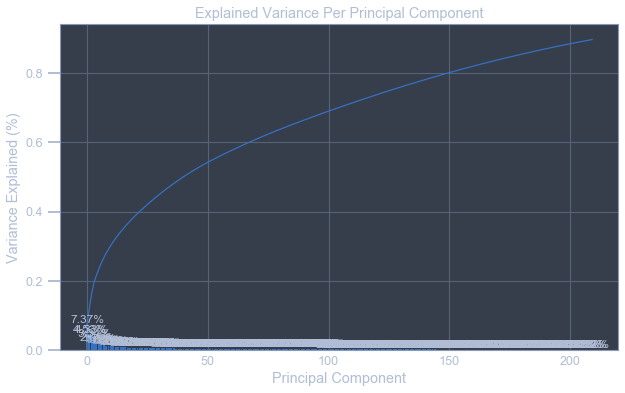

In [88]:
scree_plot(pca)

In [103]:
'''def get_component(pca, desired_variance):
    variance = 0
    num_components=len(pca.explained_variance_ratio_)
    ind = np.arange(num_components)
    vals = pca.explained_variance_ratio_
    
    for component in range(0, num_components):
        variance += vals[component]
        #print(num_components, component, variance, vals[component])
        
        if variance >= desired_variance:
            print("The number of components needed to obtain {} of variance is {}".format(variance,component+1))
            return component+1'''

In [104]:
comp = get_component(pca, 0.85)

The number of components needed to obtain 0.8500097199600485 of variance is 178


In [105]:
# Re-apply PCA to the data while selecting for number of components to retain.
pca, X_pca = do_pca(n_components = comp, data=scaled_features)

After applying PCA with halft the features in the dataset and plotting the # of principal components vs variance explained, I realized that in order to have 80% of variance, we need to retain around 150 components. 

Then, I created a function to obtain the exact number of components needed to have 85% of variance, which the result is **178**

### Interpret Principal Components

Now that we have our transformed principal components, let's check out the weight of each variable on the first few components to see if they can be interpreted in some fashion.

As a reminder, each principal component is a unit vector that points in the direction of highest variance (after accounting for the variance captured by earlier principal components). The further a weight is from zero, the more the principal component is in the direction of the corresponding feature. If two features have large weights of the same sign (both positive or both negative), then increases in one tend expect to be associated with increases in the other. To contrast, features with different signs can be expected to show a negative correlation: increases in one variable should result in a decrease in the other.

- To investigate the features, let's map each weight to their corresponding feature name, then sort the features according to weight. The most interesting features for each principal component, then, will be those at the beginning and end of the sorted list. We will need to use the data dictionary document to understand these most prominent features, their relationships, and what a positive or negative value on the principal component might indicate.
- Since there are quite a lot of components, let's investigate the first three principal components in this step. To help facilitate this, we should write a function that we can call at any time to print the sorted list of feature weights, for the *i*-th principal component. This might come in handy in the next step of the project, when we interpret the tendencies of the discovered clusters.

In [106]:
# Mapping weights for the first principal components to corresponding feature names
# and then printing the linked values, sorted by weight.

'''def plot_component(full_dataset, pca, n_components, color='purple'):
    # Dimension indexing
    dimensions = dimensions = ['Dimension {}'.format(i) for i in range(1,len(pca.components_)+1)]

    # PCA components
    components = pd.DataFrame(np.round(pca.components_, 4), columns = full_dataset.keys())
    components.index = dimensions
    components = components.iloc[n_components-1]

    comp_pos =  components.sort_values(ascending=False)[:10]
    comp_neg = components.sort_values(ascending=True)[:10]
    comp_merged = pd.concat([comp_pos, comp_neg])
    comp_merged

    comp_merged.plot(kind='bar', color=color, title=dimensions[n_components-1])

#comp_end = components.sort_values(ascending=True)[:10]'''



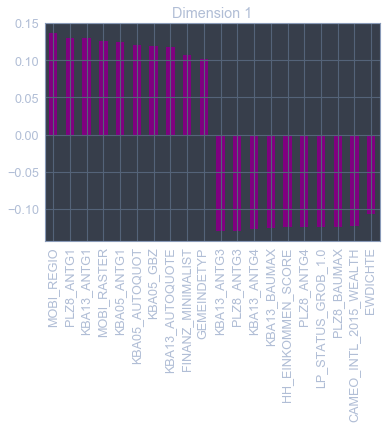

In [108]:
plot_component(azdias_updated, pca, 1)

* High mobility patterns
* High share of number of 1-2 family houses in the PLZ8
* High share of cars per household
* High financial interest
* High estimated household net income
* Wealthy households

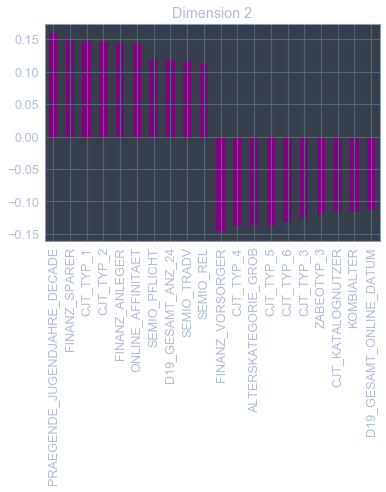

In [111]:
plot_component(azdias_updated, pca, 2)

* Person's youth: 90ies
* Not likely to be money savers
* Not likely to be investors
* High online affinity
* Lowest affinity indicating in what way the person is dutyfull traditional minded
* Prepared in terms of finance
* Less than 30 years (Age classification through prename analysis)


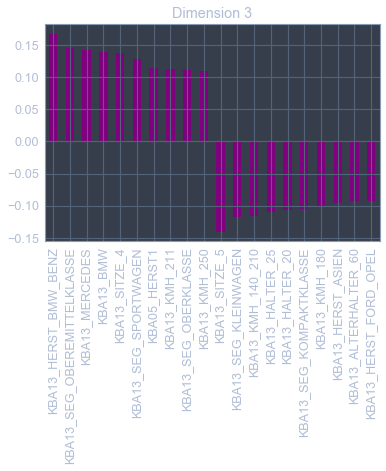

In [110]:
plot_component(azdias_updated, pca, 3)

* Very high share of BMW & Mercedes Benz within the PLZ8
* Very high share of upper middle class cars and upper class cars (BMW5er, BMW7er etc.)
* Very high number of cars with less than 5 seats in the PLZ8


### Apply Clustering to General Population

We've assessed and cleaned the demographics data, then scaled and transformed them. Now, it's time to see how the data clusters in the principal components space. In this substep, we will apply k-means clustering to the dataset and use the average within-cluster distances from each point to their assigned cluster's centroid to decide on a number of clusters to keep.

- We will use sklearn's [KMeans](http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) class to perform k-means clustering on the PCA-transformed data.
- Then, we'll compute the average difference from each point to its assigned cluster's center. **Hint**: The KMeans object's `.score()` method might be useful here, but note that in sklearn, scores tend to be defined so that larger is better. Try applying it to a small, toy dataset, or use an internet search to help your understanding.
- We'll perform the above two steps for a number of different cluster counts. You can then see how the average distance decreases with an increasing number of clusters. However, each additional cluster provides a smaller net benefit. 
- Once we've selected a final number of clusters to use, we'll re-fit a KMeans instance to perform the clustering operation. 

In [112]:
# sample of dataset
sample_pca = X_pca[np.random.choice(X_pca.shape[0], int(X_pca.shape[0]*0.25))]

In [115]:
n_cluster = 40
# Over a number of different cluster counts...
distance = np.arange(n_cluster)
for cluster in range(n_cluster):

    # running k-means clustering on the data and...
    model = KMeans(cluster+1).fit(sample_pca)
   
    
    # computing the average within-cluster distances.
    distance[cluster] = abs(model.score(sample_pca))
        

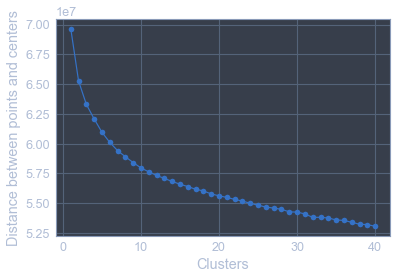

In [116]:
# Investigating the change in within-cluster distance across number of clusters.

plt.plot(range(1,distance.size+1), distance, marker='o')
plt.xlabel("Clusters")
plt.ylabel("Distance between points and centers");

As we can see in the plot above, there is no obvious elbow. However, we can perceive that after 15 clusters, the line is gradually decreasing. So I decided to use 15 clusters for this situation.

In [117]:
# Re-fitting the k-means model with 15 clusters and obtain
# cluster predictions for the general population demographics data.

model = KMeans(15, random_state=42).fit(X_pca)


In [268]:
# Saving model 
file = open('k_means_model' + str(15) + '_clusters.pkl', 'wb')
pickle.dump(model, file)
print('Model Saved')

Model Saved


In [262]:
kmeans_general = model.predict(X_pca) 

### Apply All Steps to the Customer Data

Now that we have clusters and cluster centers for the general population, it's time to see how the customer data maps on to those clusters. We're going to use the fits from the general population to clean, transform, and cluster the customer data. In the last step of the project, we will interpret how the general population fits apply to the customer data.

We will apply the same feature wrangling, selection, and engineering steps to the customer demographics using the clean_data() function we created earlier. (we can assume that the customer demographics data has similar meaning behind missing data patterns as the general demographics data.)

We will use the sklearn objects from the general demographics data, and apply their transformations to the customers data. 

In [136]:
print(outlier_columns.tolist())
pop_outlier = outlier_columns.tolist()
cust_col = customers.columns.tolist()

set(pop_outlier).difference(cust_col)

['ALTER_KIND4', 'TITEL_KZ', 'ALTER_KIND3', 'ALTER_KIND2', 'ALTER_KIND1', 'AGER_TYP', 'EXTSEL992', 'KK_KUNDENTYP', 'KBA05_BAUMAX', 'ALTER_HH', 'ALTERSKATEGORIE_FEIN', 'D19_VERSAND_ONLINE_QUOTE_12', 'D19_TELKO_ONLINE_QUOTE_12', 'D19_VERSI_ONLINE_QUOTE_12', 'D19_BANKEN_ONLINE_QUOTE_12', 'D19_SOZIALES', 'D19_LOTTO', 'D19_LETZTER_KAUF_BRANCHE', 'D19_KONSUMTYP', 'D19_GESAMT_ONLINE_QUOTE_12']


{'AGER_TYP',
 'ALTERSKATEGORIE_FEIN',
 'ALTER_HH',
 'ALTER_KIND1',
 'ALTER_KIND2',
 'ALTER_KIND3',
 'ALTER_KIND4',
 'D19_BANKEN_ONLINE_QUOTE_12',
 'D19_GESAMT_ONLINE_QUOTE_12',
 'D19_KONSUMTYP',
 'D19_LETZTER_KAUF_BRANCHE',
 'D19_LOTTO',
 'D19_SOZIALES',
 'D19_TELKO_ONLINE_QUOTE_12',
 'D19_VERSAND_ONLINE_QUOTE_12',
 'D19_VERSI_ONLINE_QUOTE_12',
 'EXTSEL992',
 'KBA05_BAUMAX',
 'KK_KUNDENTYP',
 'TITEL_KZ'}

In [144]:
# customers.loc[customers['CAMEO_DEUG_2015'] == 'X', 'CAMEO_DEUG_2015'] #= np.nan
customers.CAMEO_INTL_2015.value_counts()

14.0    19647
24.0    17805
41.0    11320
43.0     9634
25.0     9372
15.0     9217
51.0     8113
13.0     7683
22.0     7507
23.0     5770
34.0     5368
45.0     5288
54.0     4795
12.0     3715
55.0     3714
44.0     2832
31.0     2731
35.0     2294
32.0     1696
33.0     1574
52.0     1023
Name: CAMEO_INTL_2015, dtype: int64

In [148]:
customers, customers_high_nas = clean_azdias(customers)

Splitting records with NAs..
 Total records: 191652
Records split by 87 missing values.
 Shape of resulting dataset: (140338,)
 Shape of high NAs dataset: (51314,)



/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s
/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:5890: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)
/anaconda3/lib/python3.6/site-packages/pandas/core/frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


In [149]:
customers.head()

,LNR,AKT_DAT_KL,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,...,ZABEOTYP_2,ZABEOTYP_3,ZABEOTYP_4,ZABEOTYP_5,ZABEOTYP_6,PRAEGENDE_JUGENDJAHRE_MOVEMENT,PRAEGENDE_JUGENDJAHRE_DECADE,CAMEO_INTL_2015_WEALTH,CAMEO_INTL_2015_LIFESTAGE,EINGEFUEGT_AM_YEAR
0,9626,1.0,1.0,0.0,0.0,2.0,1.0,0.0,1.0,3.0,...,0,1,0,0,0,1.0,50.0,1.0,3.0,1992
2,143872,1.0,1.0,0.0,0.0,1.0,1.0,0.0,3.0,7.0,...,0,1,0,0,0,1.0,50.0,3.0,4.0,1992
3,143873,1.0,0.0,NaN,0.0,0.0,1.0,0.0,1.0,7.0,...,0,0,0,0,0,0.0,40.0,2.0,4.0,1992
4,143874,1.0,7.0,0.0,0.0,4.0,7.0,0.0,3.0,3.0,...,0,0,0,0,0,0.0,70.0,4.0,1.0,1992
5,143888,1.0,1.0,0.0,0.0,2.0,1.0,0.0,3.0,7.0,...,1,0,0,0,0,1.0,50.0,3.0,4.0,1992


In [159]:
# Seems that there is a mismatch in the number of columns
# Investigating which column does not exist in the customer dataset

customer_columns = customers_high_nas.columns.tolist()
general_columns = azdias_updated.columns.tolist()

print(set(general_columns).difference(customer_columns))
print(set(customer_columns).difference(general_columns))

{'SHOPPER_TYP_1.0', 'ZABEOTYP_3', 'LP_STATUS_GROB_1.0', 'LP_FAMILIE_FEIN_10.0', 'FINANZTYP_6', 'GFK_URLAUBERTYP_3.0', 'LP_FAMILIE_FEIN_0.0', 'CAMEO_DEUG_2015_9.0', 'ZABEOTYP_2', 'GFK_URLAUBERTYP_4.0', 'GFK_URLAUBERTYP_1.0', 'CJT_GESAMTTYP_6.0', 'LP_STATUS_GROB_4.0', 'EINGEFUEGT_AM_YEAR', 'LP_STATUS_FEIN_6.0', 'ZABEOTYP_1', 'GFK_URLAUBERTYP_5.0', 'GEBAEUDETYP_5.0', 'CJT_GESAMTTYP_5.0', 'GFK_URLAUBERTYP_10.0', 'LP_STATUS_FEIN_9.0', 'SHOPPER_TYP_2.0', 'ZABEOTYP_6', 'ZABEOTYP_4', 'GFK_URLAUBERTYP_6.0', 'LP_FAMILIE_FEIN_6.0', 'GEBAEUDETYP_6.0', 'LP_FAMILIE_FEIN_1.0', 'LP_FAMILIE_GROB_1.0', 'CAMEO_DEUG_2015_6.0', 'CAMEO_DEUG_2015_1.0', 'SHOPPER_TYP_0.0', 'LP_FAMILIE_FEIN_9.0', 'LP_STATUS_GROB_3.0', 'PRAEGENDE_JUGENDJAHRE_MOVEMENT', 'CAMEO_DEUG_2015_8.0', 'NATIONALITAET_KZ_1.0', 'GEBAEUDETYP_2.0', 'LP_STATUS_FEIN_5.0', 'GFK_URLAUBERTYP_7.0', 'LP_STATUS_FEIN_4.0', 'GFK_URLAUBERTYP_8.0', 'LP_FAMILIE_GROB_5.0', 'ZABEOTYP_5', 'LP_STATUS_FEIN_3.0', 'CAMEO_DEUG_2015_7.0', 'LP_STATUS_GROB_5.0', 'GEB

In [158]:
# Adding 'GEBAEUDETYP_5.0' to the customers dataset with 0
gebaeu_index = azdias_updated.columns.get_loc('GEBAEUDETYP_5.0')
customers.insert(gebaeu_index, 'GEBAEUDETYP_5.0', 0 )

IndexError: index 394 is out of bounds for axis 0 with size 346

In [155]:
# Taking care of the remaining missing values
imputed_features_customers = imputer.transform(customers)
scaled_customers = scaler.transform(imputed_features_customers)

In [162]:
# Applying PCA and KMeans
pca_customers = pca.transform(scaled_customers)

kmeans_customers = model.predict(pca_customers)

### Compare Customer Data to Demographics Data
At this point, you have clustered data based on demographics of the general population of Germany, and seen how the customer data for a mail-order sales company maps onto those demographic clusters. In this final substep, you will compare the two cluster distributions to see where the strongest customer base for the company is.

Consider the proportion of persons in each cluster for the general population, and the proportions for the customers. If we think the company's customer base to be universal, then the cluster assignment proportions should be fairly similar between the two. If there are only particular segments of the population that are interested in the company's products, then we should see a mismatch from one to the other. If there is a higher proportion of persons in a cluster for the customer data compared to the general population (e.g. 5% of persons are assigned to a cluster for the general population, but 15% of the customer data is closest to that cluster's centroid) then that suggests the people in that cluster to be a target audience for the company. On the other hand, the proportion of the data in a cluster being larger in the general population than the customer data (e.g. only 2% of customers closest to a population centroid that captures 6% of the data) suggests that group of persons to be outside of the target demographics.

Take a look at the following points in this step:

- Compute the proportion of data points in each cluster for the general population and the customer data. Visualizations will be useful here: both for the individual dataset proportions, but also to visualize the ratios in cluster representation between groups. Seaborn's [`countplot()`](https://seaborn.pydata.org/generated/seaborn.countplot.html) or [`barplot()`](https://seaborn.pydata.org/generated/seaborn.barplot.html) function could be handy.
  - Recall the analysis you performed in step 1.1.3 of the project, where you separated out certain data points from the dataset if they had more than a specified threshold of missing values. If you found that this group was qualitatively different from the main bulk of the data, you should treat this as an additional data cluster in this analysis. Make sure that you account for the number of data points in this subset, for both the general population and customer datasets, when making your computations!
- Which cluster or clusters are overrepresented in the customer dataset compared to the general population? Select at least one such cluster and infer what kind of people might be represented by that cluster. Use the principal component interpretations from step 2.3 or look at additional components to help you make this inference. Alternatively, you can use the `.inverse_transform()` method of the PCA and StandardScaler objects to transform centroids back to the original data space and interpret the retrieved values directly.
- Perform a similar investigation for the underrepresented clusters. Which cluster or clusters are underrepresented in the customer dataset compared to the general population, and what kinds of people are typified by these clusters?

In [164]:
# Creating cluster 15 for the high NAs for the two datasets
#gral_high_nas = azdias[azdias.index.isin(na_rows_high.index)]
#kmeans_high_nas_gral = np.full((gral_high_nas.shape[0],), 15)
#kmeans_high_nas_cust = np.full((customers_high_nas.shape[0],), 15)

In [165]:
# Concatenating the cluster arrays for the high nas to the kmeans array
#print(np.concatenate((kmeans_general,kmeans_high_nas_gral)).shape,kmeans_general.shape,kmeans_high_nas_gral.shape,)
kmeans_gral_org = kmeans_general
kmeans_cust_org = kmeans_customers
#kmeans_general = np.concatenate((kmeans_general,kmeans_high_nas_gral))
#kmeans_customers = np.concatenate((kmeans_customers,kmeans_high_nas_cust))

997146
242966


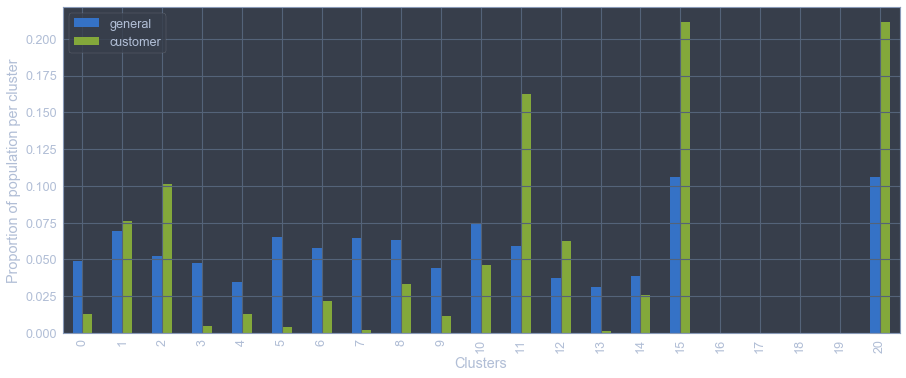

In [166]:
# Compare the proportion of data in each cluster for the customer data to the
# proportion of data in each cluster for the general population.

gral_prop = np.bincount(kmeans_general)/len(kmeans_general)
print(len(kmeans_general))
cust_prop = np.bincount(kmeans_customers)/len(kmeans_customers)
print(len(kmeans_customers))

full_prop = pd.DataFrame({'general': gral_prop, 'customer': cust_prop})

full_prop.plot(kind='bar', figsize=[15,6])
plt.xlabel('Clusters')
plt.ylabel('Proportion of population per cluster');

In [169]:
differences = full_prop['customer'] - full_prop['general']

# Overrepresented clusters
overrepresented = differences.sort_values(ascending=False)[:3].index
differences.sort_values(ascending=False)[:5]

20    0.104970
15    0.104970
11    0.103302
2     0.048599
12    0.025314
dtype: float64

In [170]:
# Underrepresented clusters
underrepresented = differences.sort_values(ascending=True)[:3].index
differences.sort_values(ascending=True)[:3]

7   -0.063080
5   -0.061793
3   -0.042790
dtype: float64

In [171]:
# What kinds of people are part of a cluster that is overrepresented in the
# customer data compared to the general population?

def get_components(cluster, kmeans):
    
    pca_c = kmeans.cluster_centers_[cluster].copy()
    pca_series = pd.Series(pca_c)
    print(pca_series.head(5), pca_series.tail(5))
    pos_comp = pca_series.sort_values(ascending=False)[:3].index
    neg_comp = pca_series.sort_values(ascending=True)[:3].index
    print(pos_comp, neg_comp)
    
    return pos_comp, neg_comp

In [172]:
comp_pos_over, comp_neg_over = get_components(overrepresented[2],model) #We skip the 20 cluster, which is for the high missing values
comp_pos_under, comp_neg_under = get_components(underrepresented[0],model)

0    4.819147
1   -4.162483
2    0.196513
3    1.660451
4    0.289279
dtype: float64 173    0.010546
174   -0.039009
175   -0.044132
176    0.033943
177    0.030920
dtype: float64
Int64Index([0, 3, 7], dtype='int64') Int64Index([1, 6, 10], dtype='int64')
0   -4.666326
1    2.032061
2    1.478009
3   -3.571298
4   -0.372021
dtype: float64 173    0.044841
174    0.011730
175    0.020526
176    0.017858
177   -0.003858
dtype: float64
Int64Index([1, 2, 8], dtype='int64') Int64Index([0, 3, 6], dtype='int64')


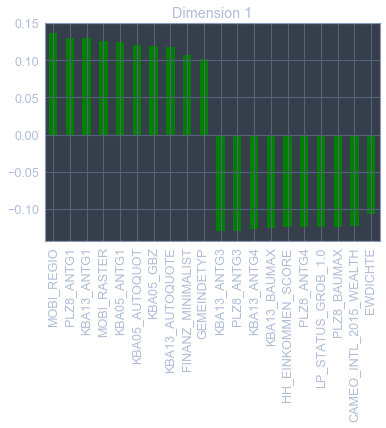

In [180]:
# For the overrepresented, lets take a closer look to its most relevant components

plot_component(full_dataset=customers,n_components=comp_pos_over[0]+1, pca=pca, color='green')

* High mobility patterns
* High share of number of 1-2 family houses in the PLZ8
* High share of cars per household
* High financial interest
* High estimated household net income
* Wealthy households

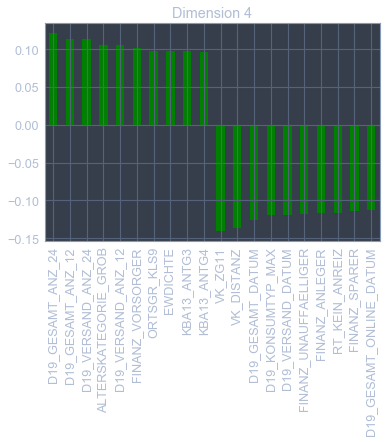

In [174]:
plot_component(full_dataset=customers,n_components=comp_pos_over[1]+1, pca=pca, color='green')

* Very high transaction activity(BANKS, TELCO, INSURANCE, MAIL-ORDER) in the last 12-24 months
* Very high mail order transaction activity in the last 12- 24 months.
* People > 60 years age classification through prename analysis
* Financially prepared household/people

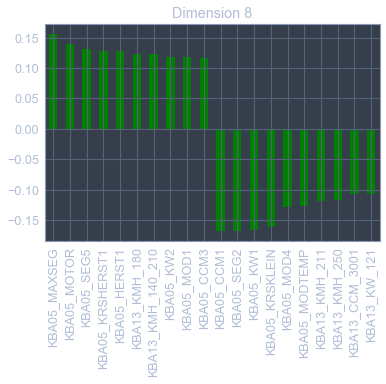

In [178]:
plot_component(full_dataset=customers,n_components=comp_pos_over[2]+1, pca=pca, color='green')

* Most common car in the microcell: upper class car(Mercedes/ BMW) or 
* Most common engine size in the microcell: big engine
* Very high share of upper middle class car (BMW5er, BMW7er etc.) in the microcell
* Very high share of big cars


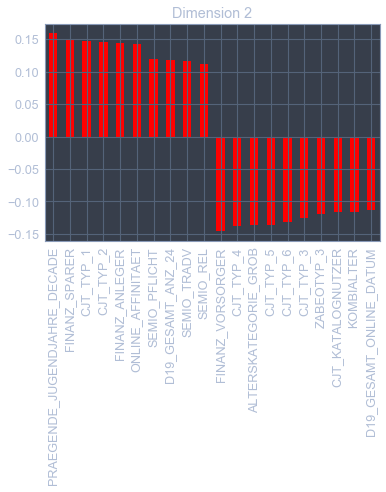

In [175]:
# What kinds of people are part of a cluster that is underrepresented in the
# customer data compared to the general population?

# For the uderrepresented, lets take a closer look to its most relevant components

plot_component(full_dataset=azdias_updated,n_components=comp_pos_under[0]+1, pca=pca, color='red' )

* Person's youth: 90ies
* Not likely to be money savers
* Not likely to be investors
* High online affinity
* Lowest affinity indicating in what way the person is dutyfull traditional minded
* Prepared in terms of finance
* Less than 30 years (Age classification through prename analysis)

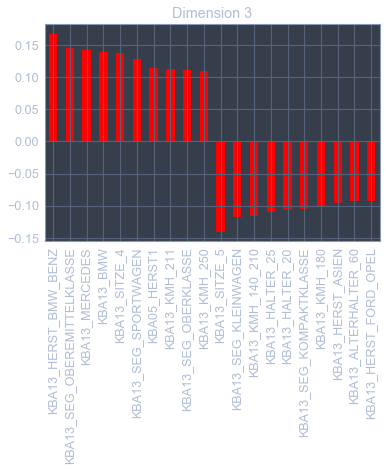

In [176]:
plot_component(full_dataset=azdias_updated,n_components=comp_pos_under[1]+1, pca=pca, color='red' )

* Very high share of BMW & Mercedes Benz within the PLZ8
* Very high share of upper middle class cars and upper class cars (BMW5er, BMW7er etc.) within PLZ8
* Very high number of cars with less than 5 seats in the PLZ8
* Very high share of sports cars within the PLZ8
* Share of car owners not younger than 25 and not older than 46-61

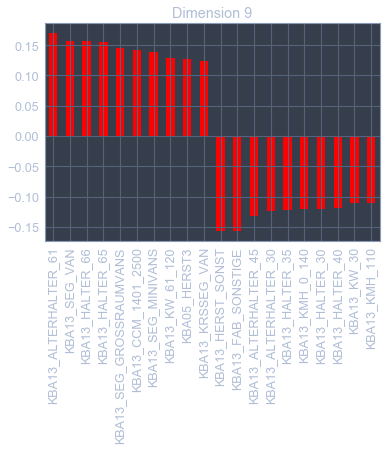

In [177]:
plot_component(full_dataset=azdias_updated,n_components=comp_pos_under[2]+1, pca=pca, color='red' )

* Very high share of car owners over 61 years old within the PLZ8
* Very high share of vans, big sized vans and minivans within the PLZ8

In the plot above (customer vs general population), we are able to see that there are obvious overrepresented clusters, such as 11 cluster and also obvious underrepresented clusters, such as 7. After taking a look at their most relevant components, we could say that the kind of **overrepresented people** in the customer dataset compared to the general population is:

* High estimated household net income families (wealthy households) with high financial interest and high share of upper class cars (BMW/Mercedes) with big engines, who have very high transaction activity (Banks, Telco, Insurance, Mail-Order)

On the other hand, the kind of **underrepresented people** are:

* Young people (less than 30), who have not financial interest but financially prepared and not traditionally minded.
* People not younger than 25 but not older than 61 with very high share of sports cars with less than 5 seats within the PLZ8.
* People over 61 years old with very high share of vans, minivans or big sized vans withing the PLZ8.

## Part 2: Supervised Learning Model

Now that you've found which parts of the population are more likely to be customers of the mail-order company, it's time to build a prediction model. Each of the rows in the "MAILOUT" data files represents an individual that was targeted for a mailout campaign. Ideally, we should be able to use the demographic information from each individual to decide whether or not it will be worth it to include that person in the campaign.

The "MAILOUT" data has been split into two approximately equal parts, each with almost 43 000 data rows. In this part, you can verify your model with the "TRAIN" partition, which includes a column, "RESPONSE", that states whether or not a person became a customer of the company following the campaign. In the next part, you'll need to create predictions on the "TEST" partition, where the "RESPONSE" column has been withheld.

In [236]:
mailout_train = pd.read_csv('Udacity_MAILOUT_052018_TRAIN.csv', sep=';')
mailout_train.drop(columns='Unnamed: 0', inplace=True)

/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [237]:
mailout_train.head()

,LNR,AGER_TYP,AKT_DAT_KL,ALTER_HH,ALTER_KIND1,ALTER_KIND2,ALTER_KIND3,ALTER_KIND4,ALTERSKATEGORIE_FEIN,ANZ_HAUSHALTE_AKTIV,...,VK_DHT4A,VK_DISTANZ,VK_ZG11,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,RESPONSE,ANREDE_KZ,ALTERSKATEGORIE_GROB
0,1763,2,1.0,8.0,NaN,NaN,NaN,NaN,8.0,15.0,...,5.0,2.0,1.0,6.0,9.0,3.0,3,0,2,4
1,1771,1,4.0,13.0,NaN,NaN,NaN,NaN,13.0,1.0,...,1.0,2.0,1.0,4.0,9.0,7.0,1,0,2,3
2,1776,1,1.0,9.0,NaN,NaN,NaN,NaN,7.0,0.0,...,6.0,4.0,2.0,NaN,9.0,2.0,3,0,1,4
3,1460,2,1.0,6.0,NaN,NaN,NaN,NaN,6.0,4.0,...,8.0,11.0,11.0,6.0,9.0,1.0,3,0,2,4
4,1783,2,1.0,9.0,NaN,NaN,NaN,NaN,9.0,53.0,...,2.0,2.0,1.0,6.0,9.0,3.0,3,0,1,3


In [238]:
mailout_train.RESPONSE.value_counts()

0    42430
1      532
Name: RESPONSE, dtype: int64

In [239]:
def clean_mailout(df):
    """
    Perform feature trimming, re-encoding, and engineering for demographics
    data
    
    INPUT: Demographics DataFrame
    OUTPUT: Trimmed and cleaned demographics DataFrame
    """
    
    # Put in code here to execute all main cleaning steps:
    # convert missing value codes into NaNs, ...
    replace_unknown_values(df, unknown_dict)

    # Removing the outlier columns from the dataset.
    try:
        df.drop(outlier_columns, axis=1, inplace=True)
    except:
        pass
    
    #df, df_high_na = remove_nas_rows(df)
    
    # Manually replacing missign values for CAMEO_DEU, CAMEO_DEUG and CAMEO_INTL
    df.loc[df['CAMEO_DEU_2015'] == 'XX', 'CAMEO_DEU_2015'] = np.nan
    df.loc[df['CAMEO_DEUG_2015'] == 'X', 'CAMEO_DEUG_2015'] = np.nan
    df.loc[:, 'CAMEO_DEUG_2015'] = df.loc[:, 'CAMEO_DEUG_2015'].astype('float')
    df.loc[df['CAMEO_INTL_2015'] == 'XX', 'CAMEO_INTL_2015'] = np.nan
    df.loc[:, 'CAMEO_INTL_2015'] = df.loc[:, 'CAMEO_INTL_2015'].astype('float')
    
    # select, re-encode, and engineer column values.
    df['OST_WEST_KZ'].replace(['W','O'], [1,0], inplace=True)
    df.drop('CAMEO_DEU_2015', axis=1, inplace=True)
    df = pd.get_dummies(df, columns=cat_col['multi'])
    
    col_move= np.where(df['PRAEGENDE_JUGENDJAHRE'].isin(mainstream), 0, 
                   np.where(df['PRAEGENDE_JUGENDJAHRE'].notnull(), 1, np.nan))
    col_dec = df['PRAEGENDE_JUGENDJAHRE'].map(decade)
    
    df['PRAEGENDE_JUGENDJAHRE_MOVEMENT'] = col_move
    df['PRAEGENDE_JUGENDJAHRE_DECADE'] = col_dec
    
    
    df['CAMEO_INTL_2015_WEALTH']= df['CAMEO_INTL_2015'].apply(split_cameo,wealth=1).astype('float')
    df['CAMEO_INTL_2015_LIFESTAGE']= df['CAMEO_INTL_2015'].apply(split_cameo,wealth=0).astype('float')
    
    df['EINGEFUEGT_AM_YEAR'] = df['EINGEFUEGT_AM'].str[:4].astype(float)
    
    # Finally we drop the original columns

    df.drop(['CAMEO_INTL_2015','PRAEGENDE_JUGENDJAHRE','LP_LEBENSPHASE_FEIN','EINGEFUEGT_AM'], axis=1, inplace=True)
    
    # Return the cleaned dataframe.
    return df#, df_high_na



In [240]:
mailout_clean = clean_mailout(mailout_train)
#mailout_train.OST_WEST_KZ.value_counts()

In [241]:

mailout_columns = mailout_clean.columns.tolist()
general_columns = azdias_updated.columns.tolist()

print(set(general_columns).difference(mailout_columns))
print(set(mailout_columns).difference(general_columns))

{'GEBAEUDETYP_5.0'}
{'RESPONSE'}


In [242]:
gebaeu_index = azdias_updated.columns.get_loc('GEBAEUDETYP_5.0')
mailout_clean.insert(gebaeu_index, 'GEBAEUDETYP_5.0', 0 )

In [243]:
#mailout_clean[mailout_clean.RESPONSE == 1].drop(columns = 'RESPONSE')

,LNR,AKT_DAT_KL,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,...,ZABEOTYP_2,ZABEOTYP_3,ZABEOTYP_4,ZABEOTYP_5,ZABEOTYP_6,PRAEGENDE_JUGENDJAHRE_MOVEMENT,PRAEGENDE_JUGENDJAHRE_DECADE,CAMEO_INTL_2015_WEALTH,CAMEO_INTL_2015_LIFESTAGE,EINGEFUEGT_AM_YEAR
90,21511,1.0,1.0,0.0,0.0,2.0,1.0,0.0,3.0,4.0,...,1,0,0,0,0,1.0,50.0,4.0,4.0,1992.0
129,61905,1.0,8.0,0.0,0.0,1.0,7.0,0.0,3.0,3.0,...,0,0,0,0,1,0.0,50.0,4.0,1.0,1992.0
173,15467,1.0,1.0,0.0,0.0,4.0,1.0,0.0,3.0,1.0,...,0,0,0,0,0,1.0,70.0,5.0,1.0,1992.0
205,25211,1.0,5.0,0.0,0.0,2.0,3.0,0.0,3.0,2.0,...,0,1,0,0,0,0.0,40.0,3.0,2.0,1995.0
248,83461,1.0,1.0,0.0,0.0,2.0,1.0,0.0,2.0,7.0,...,0,0,0,0,0,1.0,50.0,1.0,4.0,1992.0
330,53613,1.0,1.0,0.0,0.0,4.0,1.0,0.0,2.0,2.0,...,0,0,0,0,0,1.0,50.0,1.0,4.0,1992.0
357,53640,7.0,2.0,0.0,0.0,1.0,2.0,0.0,3.0,4.0,...,0,1,0,0,0,1.0,50.0,3.0,3.0,1992.0
473,35595,1.0,6.0,0.0,0.0,0.0,8.0,0.0,4.0,6.0,...,0,1,0,0,0,1.0,40.0,4.0,1.0,1995.0
595,10758,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,1,0,0,0,NaN,NaN,NaN,NaN,NaN
617,31461,1.0,7.0,0.0,0.0,2.0,6.0,0.0,1.0,1.0,...,0,1,0,0,0,0.0,40.0,4.0,1.0,1997.0


In [244]:
# Taking care of the remaining missing values
imputed_features_mailout = imputer.transform(mailout_clean[mailout_clean.RESPONSE == 1].drop(columns = 'RESPONSE'))
scaled_mailout = scaler.transform(imputed_features_mailout)

In [245]:
# Applying PCA and KMeans
pca_mailout = pca.transform(scaled_mailout)

kmeans_mailout = model.predict(pca_mailout)

In [261]:
len(kmeans_general)

15

785296 15
532 15


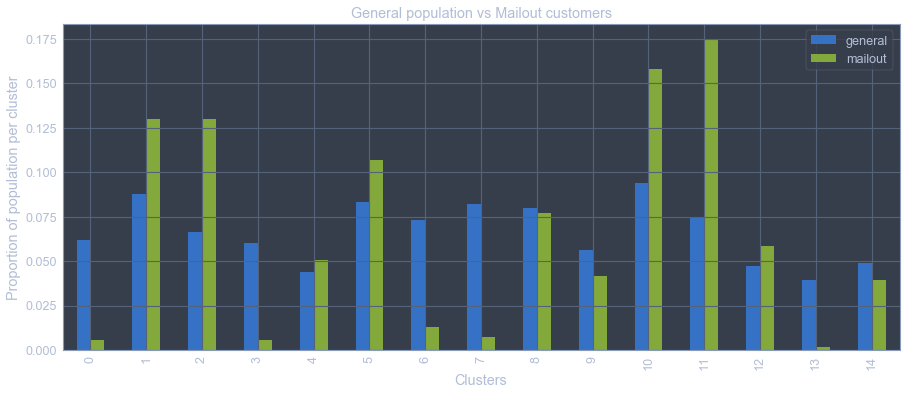

In [265]:
gral_prop = np.bincount(kmeans_general)/len(kmeans_general)
print(len(kmeans_general), len(gral_prop))
mailout_prop = np.bincount(kmeans_mailout)/len(kmeans_mailout)
print(len(kmeans_mailout), len(mailout_prop))

full_prop = pd.DataFrame({'general': gral_prop,'mailout': mailout_prop})

full_prop.plot(kind='bar', figsize=[15,6])
plt.xlabel('Clusters')
plt.ylabel('Proportion of population per cluster')
plt.title('General population vs Mailout customers');

We can see that the cluster 11 is overrepresented here as well. However, there are more clusters here that show overrepresentation than in the customers dataset. This could be potentially due to the unbalance MAILOUT dataset, which mean we need to proceed with supervised learning using other methods.

## Part 3: Kaggle Competition

Now that you've created a model to predict which individuals are most likely to respond to a mailout campaign, it's time to test that model in competition through Kaggle. If you click on the link [here](http://www.kaggle.com/t/21e6d45d4c574c7fa2d868f0e8c83140), you'll be taken to the competition page where, if you have a Kaggle account, you can enter. If you're one of the top performers, you may have the chance to be contacted by a hiring manager from Arvato or Bertelsmann for an interview!

Your entry to the competition should be a CSV file with two columns. The first column should be a copy of "LNR", which acts as an ID number for each individual in the "TEST" partition. The second column, "RESPONSE", should be some measure of how likely each individual became a customer – this might not be a straightforward probability. As you should have found in Part 2, there is a large output class imbalance, where most individuals did not respond to the mailout. Thus, predicting individual classes and using accuracy does not seem to be an appropriate performance evaluation method. Instead, the competition will be using AUC to evaluate performance. The exact values of the "RESPONSE" column do not matter as much: only that the higher values try to capture as many of the actual customers as possible, early in the ROC curve sweep.

In [ ]:
mailout_test = pd.read_csv('../../data/Term2/capstone/arvato_data/Udacity_MAILOUT_052018_TEST.csv', sep=';')